In [1]:
import math
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib import style
import matplotlib as mpl
import paste
import scipy
import anndata
import os
import umap
from sklearn.decomposition import PCA
import scanpy as sc
import warnings
import json
from PIL import Image
import torch
import seaborn
from torch import nn
import torch.nn.functional as F
import cv2
from tqdm import tqdm
from matplotlib.colors import rgb2hex
import random

2024-08-16 17:12:12.517320: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /cm/shared/apps/slurm/current/lib64/slurm:/cm/shared/apps/slurm/current/lib64
2024-08-16 17:12:16.482570: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /cm/shared/apps/slurm/current/lib64/slurm:/cm/shared/apps/slurm/current/lib64
2024-08-16 17:12:16.482974: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer_plugin.so.7'; dlerror: libnvinfer_plugin.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /cm/shared/apps/slurm/current/lib64/slurm:/cm/shared/ap

In [2]:
def get_library_id(adata):
    assert 'spatial' in adata.uns, "spatial not present in adata.uns"
    library_ids = adata.uns['spatial'].keys()
    try:
        library_id = list(library_ids)[0]
        return library_id
    except IndexError:
        logger.error('No library_id found in adata')

def get_scalefactors(adata, library_id=None):
    if library_id is None:
        library_id = get_library_id(adata)
    try:
        scalef = adata.uns['spatial'][library_id]['scalefactors']
        return scalef
    except IndexError:
        logger.error('scalefactors not found in adata')

def get_spot_diameter_in_pixels(adata, library_id=None):
    scalef = get_scalefactors(adata, library_id=library_id) 
    try:
        spot_diameter = scalef['spot_diameter_fullres']
        return spot_diameter    
    except TypeError:
        pass
    except KeyError:
        logger.error('spot_diameter_fullres not found in adata')

In [3]:
data_path = '/condo/wanglab/shared/wxc/clip/data/human/HM_data/TNBC/'

In [4]:
sample_name = 'TNBC_processed_adata_raw'
# sample_name = 'Fang_s10'
# sample_name = 'MPBC_processed_adata'

In [5]:
k=50
house_keeping_genes = pd.read_csv("/condo/wanglab/shared/wxc/clip/data/human/ST_data/housekeeping_genes.csv", index_col = 0)
PATCH_DIR = "/condo/wanglab/shared/wxc/clip/data/human/HM_data/image/patch/"

In [6]:
fit = umap.UMAP(n_components=3)

In [7]:
pca = PCA(n_components=3)

In [8]:
from open_clip import create_model_from_pretrained, get_tokenizer
import open_clip

In [9]:
PATCH_DIR = "/condo/wanglab/shared/wxc/clip/data/human/HM_data/TNBC/image/patches/"
DEVICE = "cuda"

## Coord Preprocess

In [3]:
ad_img = sc.read_h5ad('/condo/wanglab/tmhtxt85/Project/MPBC_TNBC_thor_sample/TNBC/adata_thor_result/fineST_20_initial_HE.h5ad')

In [5]:
ad_img

AnnData object with n_obs × n_vars = 122888 × 3262
    obs: 'in_tissue', 'array_row', 'array_col', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'mt_frac', 'n_counts', 'n_genes', 'spot_barcodes', 'x', 'y', 'mean_gray', 'std_gray', 'entropy_img', 'mean_r', 'mean_g', 'mean_b', 'std_r', 'std_g', 'std_b', 'spot_heterogeneity', 'node_weights'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'mt', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'used_for_prediction', 'used_for_reduced', 'used_for_vae'
    uns: 'cell_image_props', 'hvg', 'log1p', 'snn', 'spatial'
    obsm: 'spatial'
    obsp: 'snn_connectivities', 'snn_knn_connectivities', 'snn_transition_matrix'

In [6]:
ad_img.uns

{'cell_image_props': array(['x', 'y', 'mean_gray', 'std_gray', 'entropy_img', 'mean_r',
        'mean_g', 'mean_b', 'std_r', 'std_g', 'std_b'], dtype=object),
 'hvg': {'flavor': 'seurat'},
 'log1p': {},
 'snn': {'features': array(['x', 'y', 'mean_gray', 'std_gray', 'entropy_img', 'mean_r',
         'mean_g', 'mean_b', 'std_r', 'std_g', 'std_b'], dtype=object),
  'geom_constraint': 0,
  'geom_morph_ratio': 1,
  'neighbor_num': {'snn_connectivities': 5},
  'theta': 0},
 'spatial': {'TNBC_spaceranger': {'images': {'hires': array([[[0.        , 0.00784314, 0.81960785],
            [0.        , 0.00784314, 0.81960785],
            [0.        , 0.00392157, 0.8156863 ],
            ...,
            [0.        , 0.11372549, 0.9490196 ],
            [0.        , 0.11372549, 0.9490196 ],
            [0.        , 0.11372549, 0.9490196 ]],
    
           [[0.        , 0.00784314, 0.81960785],
            [0.        , 0.01176471, 0.81960785],
            [0.        , 0.00392157, 0.8156863 ],
     

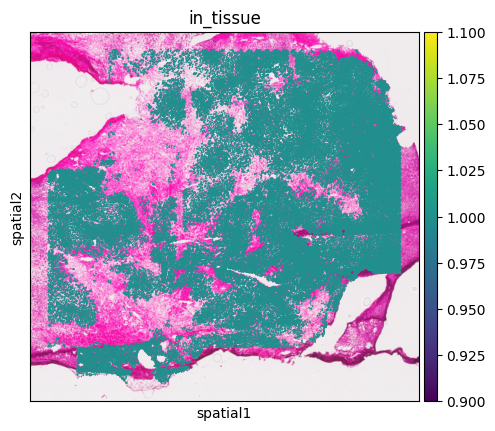

In [11]:
sc.pl.spatial(ad_img,color='in_tissue',spot_size=100)

In [8]:
wsi_coor = pd.read_csv('/condo/wanglab/tmhtxt85/Project/MPBC_TNBC_thor_sample/WSI_TNBC_ALIGN/cell_features_aligned.csv')

In [9]:
wsi_coor

,x,y
0,42491.444883,24802.457666
1,42486.663118,24830.633622
2,42508.671638,24818.469139
3,42461.545688,24789.751233
4,42485.096044,24774.459143
...,...,...
189593,32977.473556,13209.610589
189594,32958.876587,13252.921506
189595,32904.433160,13166.607433
189596,32882.469813,13220.521036


(0.0, 50000.0)

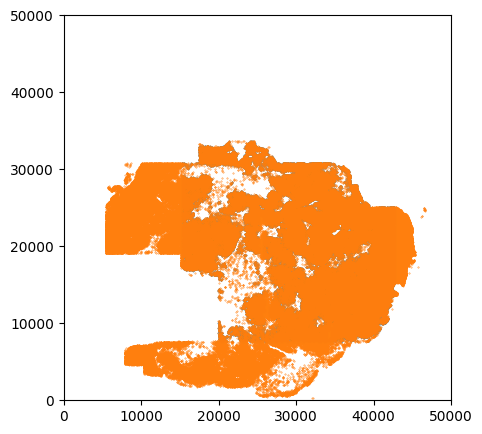

In [16]:
plt.figure(figsize=(5,5))
plt.scatter(ad_img.obsm['spatial'][:,0],ad_img.obsm['spatial'][:,1],s=0.1)
plt.scatter(wsi_coor['x'],wsi_coor['y'],s=0.1)
plt.xlim((0,50000))
plt.ylim((0,50000))

In [17]:
ad_raw = sc.read_h5ad('/condo/wanglab/tmhtxt85/Project/MPBC_TNBC_thor_sample/TNBC/processed_data/Xenium_all_cell.h5ad')

In [18]:
ad_raw

AnnData object with n_obs × n_vars = 189598 × 280
    var: 'gene_ids', 'feature_types'
    uns: 'log1p'
    obsm: 'spatial'

In [19]:
ad_raw.uns = ad_img.uns

In [21]:
ad_raw.obsm['spatial']=np.array(wsi_coor)

In [22]:
ad_raw.obs['in_tissue']=1

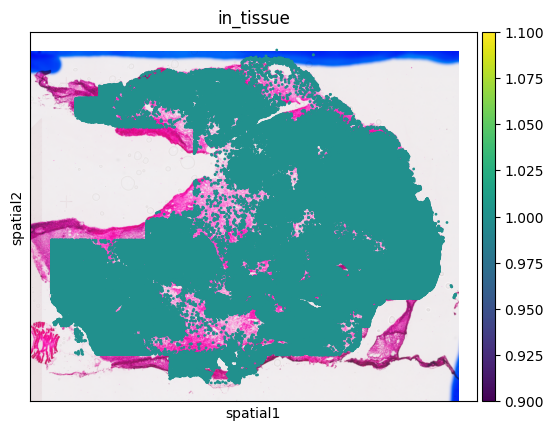

In [23]:
sc.pl.spatial(ad_raw,color='in_tissue')

In [24]:
ad_raw.write_h5ad('/condo/wanglab/shared/wxc/clip/data/human/HM_data/TNBC_Xenium.h5ad')

In [25]:
ad = sc.read_h5ad('/condo/wanglab/shared/wxc/clip/data/human/HM_data/MPBC_Xenium.h5ad')

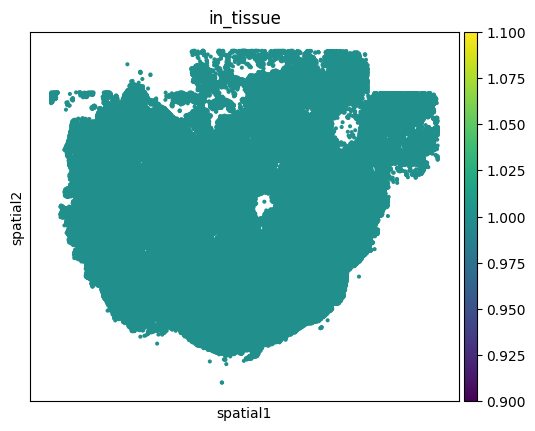

In [27]:
sc.pl.spatial(ad,color='in_tissue',alpha_img=0)

(0.0, 40000.0)

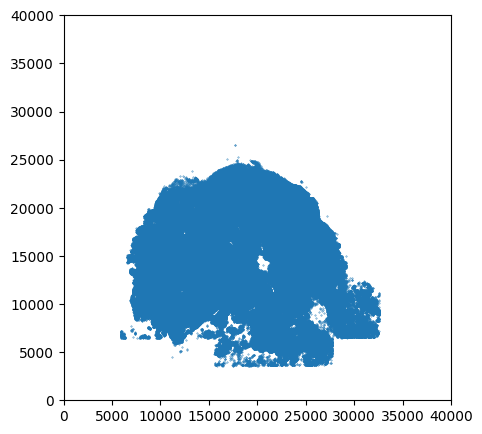

In [32]:
plt.figure(figsize=(5,5))
plt.scatter(ad.obsm['spatial'][:,0],ad.obsm['spatial'][:,1],s=0.1)
# plt.scatter(wsi_coor['x'],wsi_coor['y'],s=0.1)
plt.xlim((0,40000))
plt.ylim((0,40000))

In [1]:
import tifffile

In [3]:
img_path = '/condo/wanglab/tmhtxt85/Project/MPBC_TNBC_thor_sample/TNBC/HE.qptiff'

In [4]:
im = tifffile.imread(img_path)

In [5]:
im.shape

(84960, 61440, 3)

In [6]:
im[::100,::100].shape

(850, 615, 3)

In [7]:
import matplotlib.pyplot as plt

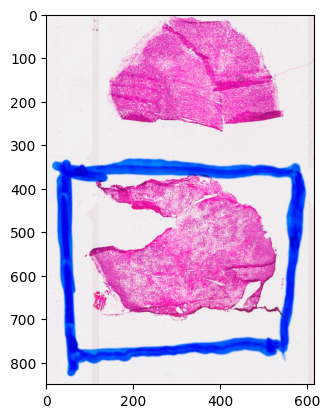

In [8]:
plt.imshow(im[::100,::100])

# Xenium Data

## Preprocess

In [308]:
# ad_xen = sc.read_h5ad('/condo/wanglab/shared/wxc/clip/data/human/HM_data/TNBC_Xenium.h5ad')
ad_xen_raw = sc.read_h5ad('/condo/wanglab/tmhtxt85/Project/MPBC_TNBC_thor_sample/TNBC/processed_data/Xenium_all_cell_count.h5ad')

In [309]:
ad_xen_raw

AnnData object with n_obs × n_vars = 189598 × 280
    var: 'gene_ids', 'feature_types'
    obsm: 'spatial'

In [310]:
ad_xen_raw.X.todense()

matrix([[0., 0., 2., ..., 0., 0., 0.],
        [0., 2., 2., ..., 0., 0., 0.],
        [0., 0., 2., ..., 0., 0., 0.],
        ...,
        [0., 1., 1., ..., 0., 0., 0.],
        [0., 1., 0., ..., 0., 0., 0.],
        [0., 0., 1., ..., 0., 0., 0.]], dtype=float32)

In [327]:
ad_xen = sc.read_h5ad('/condo/wanglab/shared/wxc/clip/data/human/HM_data/TNBC_Xenium.h5ad')

In [328]:
ad_xen_cp = ad_xen.copy()

In [329]:
del ad_xen.obs['leiden']
del ad_xen.obsm['X_pca']
del ad_xen.obsm['X_umap']
del ad_xen.varm
del ad_xen.obsp
del ad_xen.uns

In [330]:
ad_xen

AnnData object with n_obs × n_vars = 189598 × 280
    obs: 'in_tissue'
    var: 'gene_ids', 'feature_types'
    obsm: 'spatial'

In [331]:
ad_xen.uns['spatial']=ad_xen_cp.uns['spatial']

In [332]:
ad_xen

AnnData object with n_obs × n_vars = 189598 × 280
    obs: 'in_tissue'
    var: 'gene_ids', 'feature_types'
    uns: 'spatial'
    obsm: 'spatial'

In [333]:
ad_xen.X=ad_xen_raw.X

In [334]:
ad_xen

AnnData object with n_obs × n_vars = 189598 × 280
    obs: 'in_tissue'
    var: 'gene_ids', 'feature_types'
    uns: 'spatial'
    obsm: 'spatial'

In [336]:
ad_xen.write_h5ad('/condo/wanglab/shared/wxc/clip/data/human/HM_data/TNBC_Xenium_raw.h5ad')

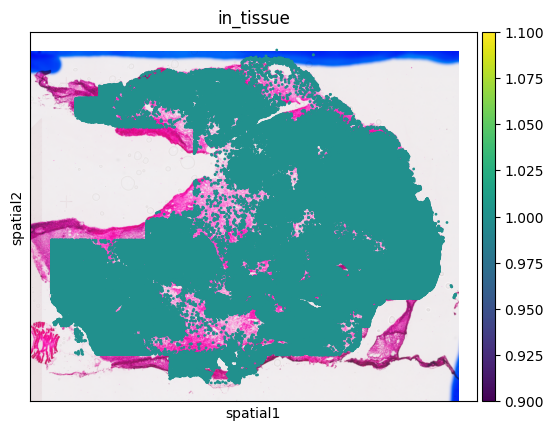

In [8]:
sc.pl.spatial(ad_xen, color='in_tissue')

In [195]:
sc.pp.pca(ad_xen)
sc.pp.neighbors(ad_xen)

In [196]:
sc.tl.leiden(ad_xen)

In [206]:
sc.tl.umap(ad_xen)

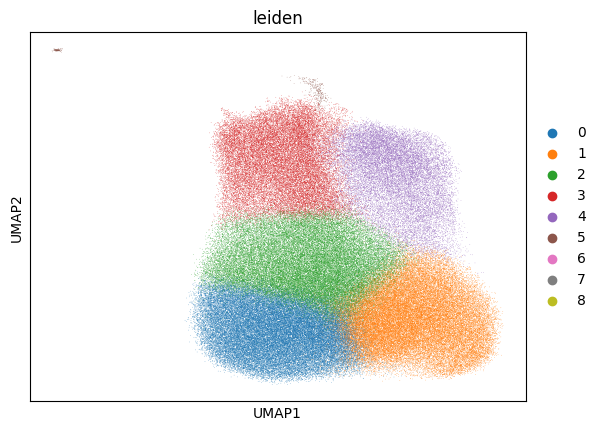

In [208]:
sc.pl.umap(ad_xen,color='leiden')

In [209]:
ad_xen.write_h5ad('/condo/wanglab/shared/wxc/clip/data/human/HM_data/TNBC_Xenium.h5ad')

In [210]:
ad_xen

AnnData object with n_obs × n_vars = 189598 × 280
    obs: 'in_tissue', 'leiden'
    var: 'gene_ids', 'feature_types'
    uns: 'cell_image_props', 'hvg', 'log1p', 'snn', 'spatial', 'pca', 'neighbors', 'leiden', 'leiden_colors', 'umap'
    obsm: 'spatial', 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

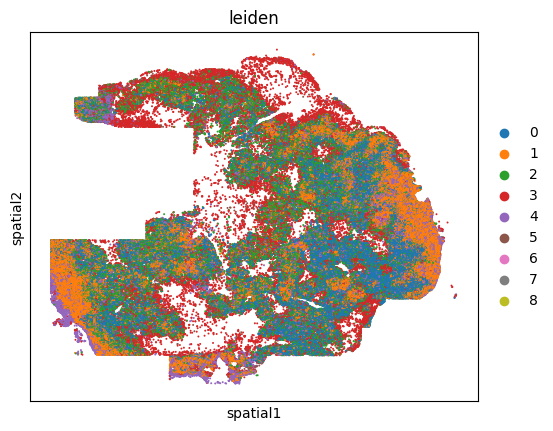

In [199]:
sc.pl.spatial(ad_xen, color='leiden',alpha_img=0,spot_size=200)

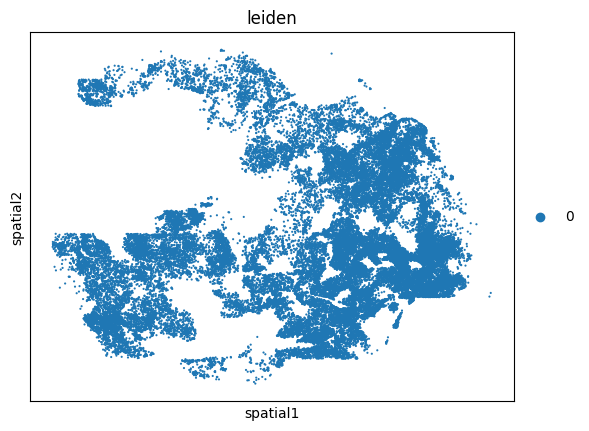

In [197]:
sc.pl.spatial(ad_xen[ad_xen.obs['leiden']=='0',:], color='leiden',alpha_img=0,spot_size=200)

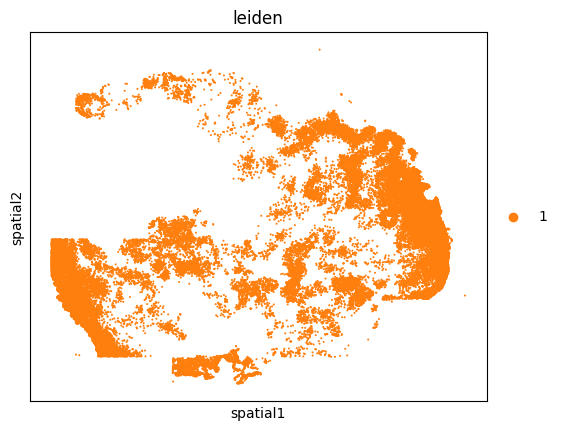

In [194]:
sc.pl.spatial(ad_xen[ad_xen.obs['leiden']=='1',:], color='leiden',alpha_img=0,spot_size=200)

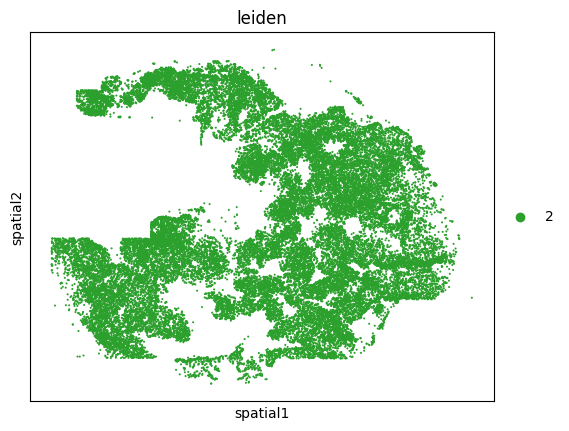

In [200]:
sc.pl.spatial(ad_xen[ad_xen.obs['leiden']=='2',:], color='leiden',alpha_img=0,spot_size=200)

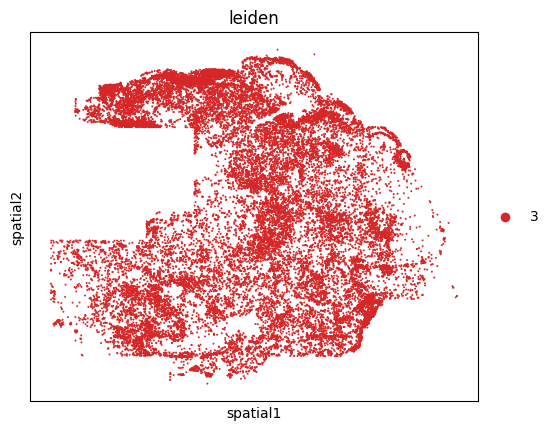

In [201]:
sc.pl.spatial(ad_xen[ad_xen.obs['leiden']=='3',:], color='leiden',alpha_img=0,spot_size=200)

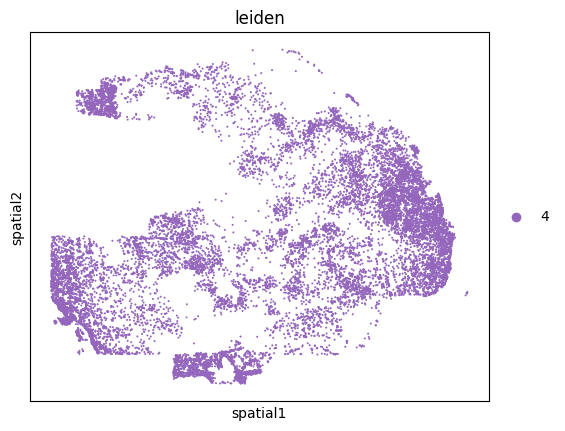

In [202]:
sc.pl.spatial(ad_xen[ad_xen.obs['leiden']=='4',:], color='leiden',alpha_img=0,spot_size=200)

In [18]:
sc.tl.rank_genes_groups(ad_xen, 'leiden')

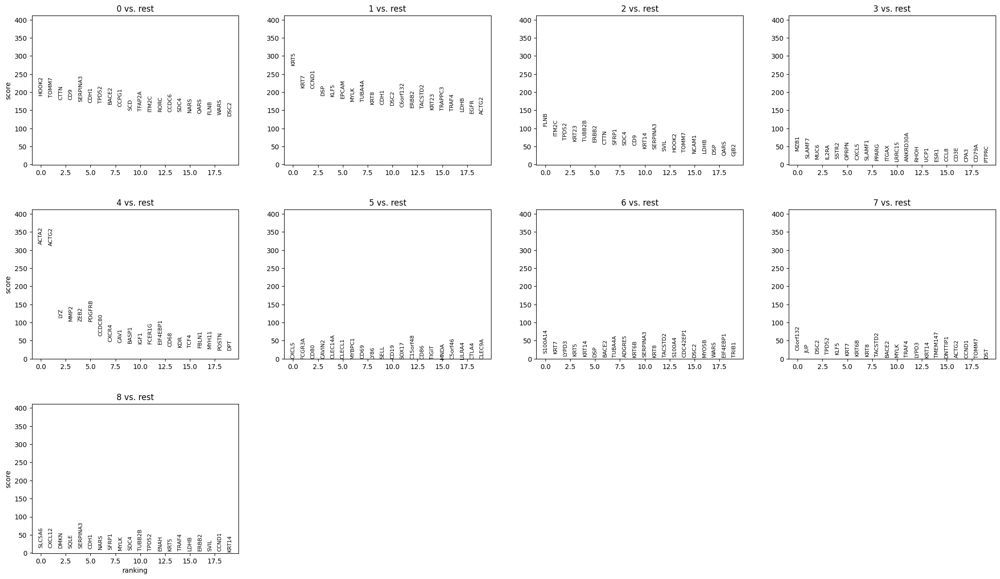

In [19]:
sc.pl.rank_genes_groups(ad_xen)

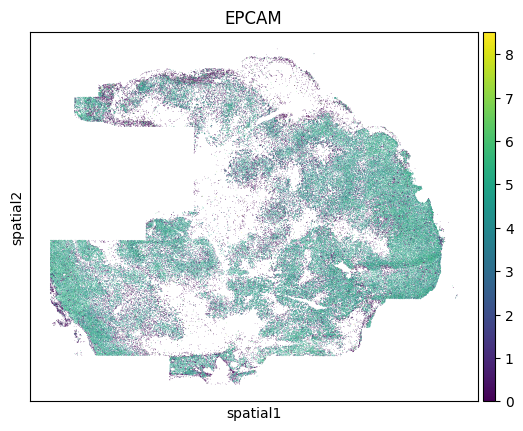

In [206]:
sc.pl.spatial(ad_xen, color='EPCAM',alpha_img=0,spot_size=50)

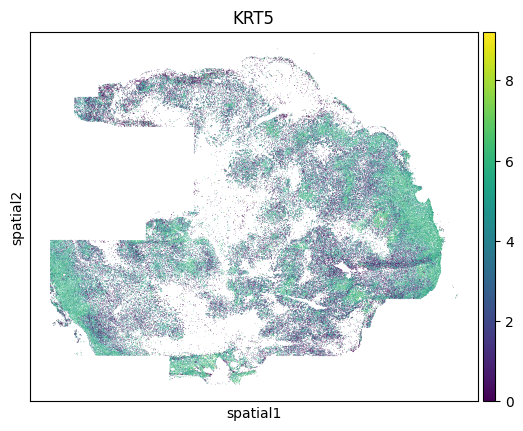

In [207]:
sc.pl.spatial(ad_xen, color='KRT5',alpha_img=0,spot_size=50)

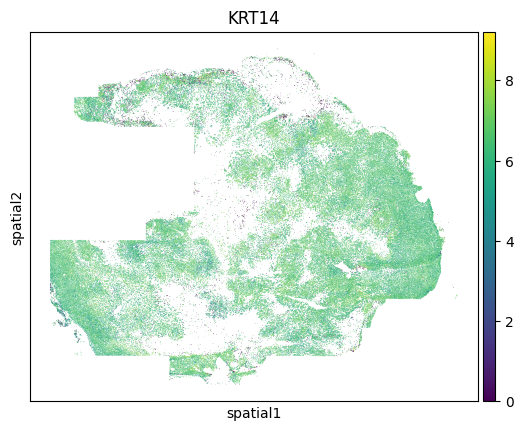

In [208]:
sc.pl.spatial(ad_xen, color='KRT14',alpha_img=0,spot_size=50)

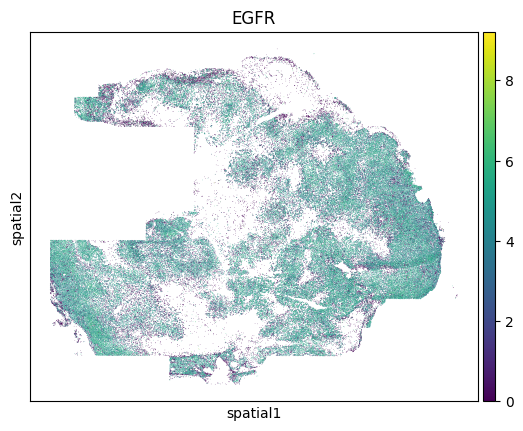

In [209]:
sc.pl.spatial(ad_xen, color='EGFR',alpha_img=0,spot_size=50)

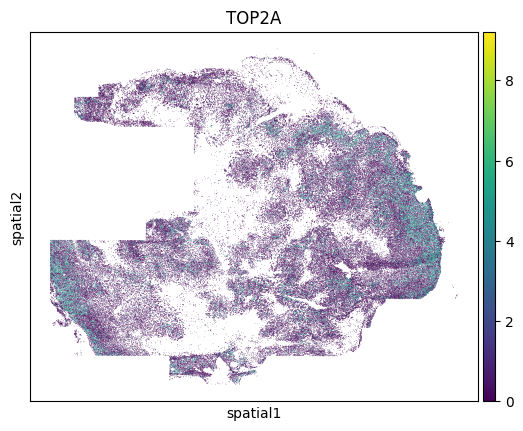

In [174]:
sc.pl.spatial(ad_xen, color='TOP2A',alpha_img=0,spot_size=50)

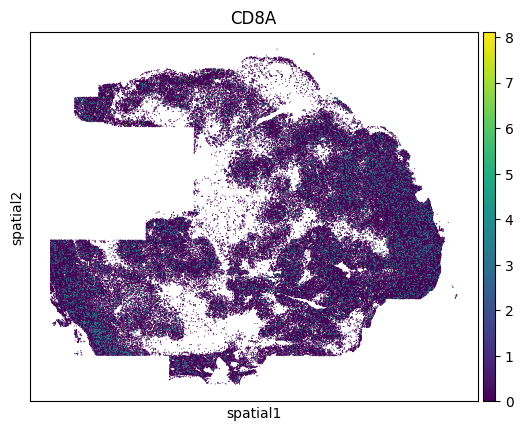

In [176]:
sc.pl.spatial(ad_xen, color='CD8A',alpha_img=0,spot_size=100)

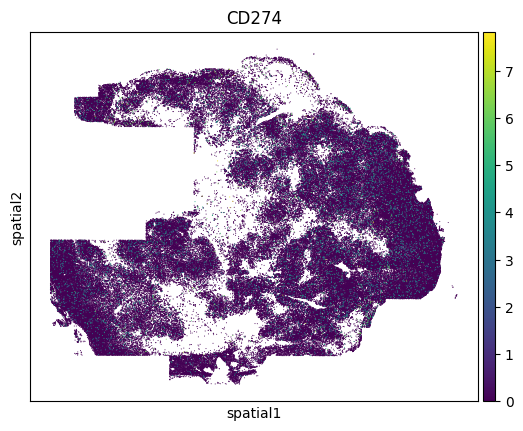

In [182]:
sc.pl.spatial(ad_xen, color='CD274',alpha_img=0,spot_size=100)

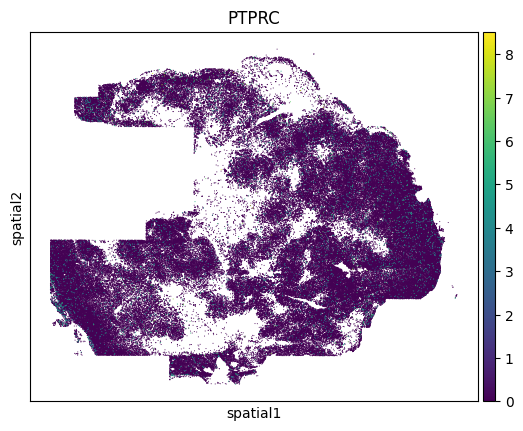

In [187]:
sc.pl.spatial(ad_xen, color='PTPRC',alpha_img=0,spot_size=100)

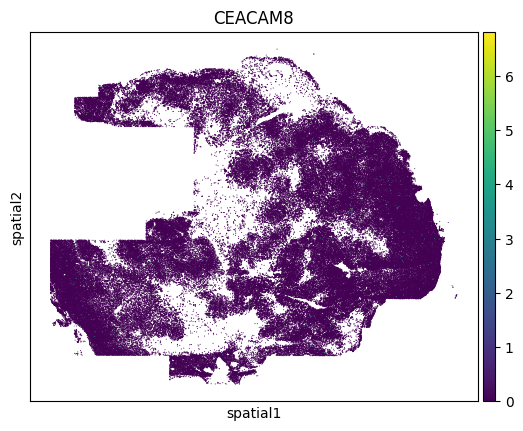

In [191]:
sc.pl.spatial(ad_xen, color='CEACAM8',alpha_img=0,spot_size=100)

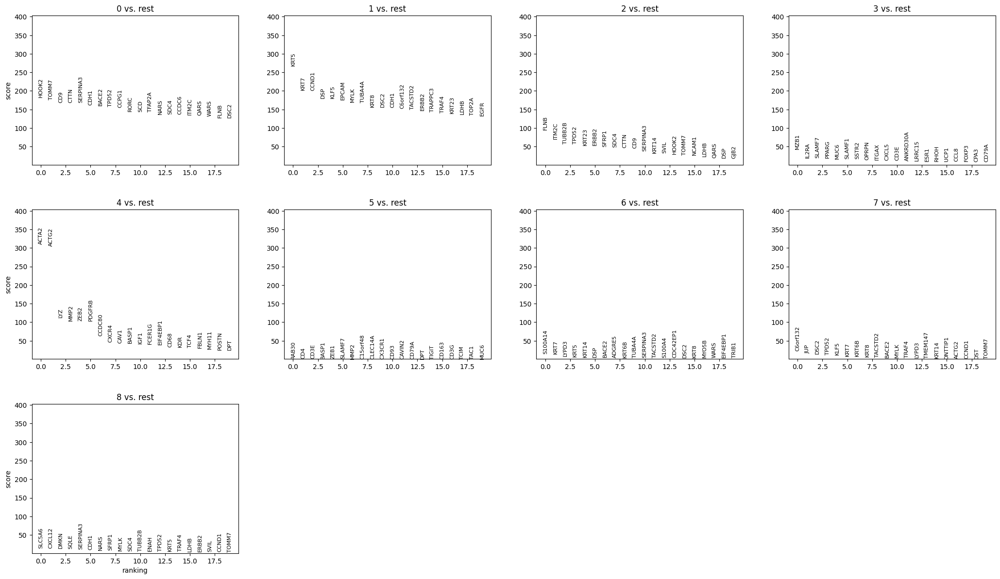

In [180]:
sc.pl.rank_genes_groups(ad_xen)

## Align cell to spot

In [91]:
from scipy.spatial import KDTree

def find_points_within_radius_fast(grid_set, point_set, radius):
    # Convert sets to numpy arrays for compatibility with KDTree
    setA = np.array(point_set)
    setB = np.array(grid_set)
    
    # Build a KD-Tree for setB
    tree_B = KDTree(setB)
    tree_A = KDTree(setA)
    
    # List to collect pairs of indices
    pairs = []
    
    # Array to store the count of setA points within the radius for each point in setB
    count_in_radius = np.zeros(len(setB), dtype=int)
    
    # Query the tree to find indices of points in setB within the radius of each point in setA
    for i, pointA in enumerate(setA):
        indices = tree_B.query_ball_point(pointA, r=radius)
        for j in indices:
            pairs.append([i, j])
    
    # Calculate the number of setA points within the radius for each point in setB
    for j, pointB in enumerate(setB):
        indices = tree_A.query_ball_point(pointB, r=radius)
        count_in_radius[j] = len(indices)
    
    # Convert the list of pairs to a 2D numpy array
    pairs_array = np.array(pairs)
    
    return pairs_array, count_in_radius

In [104]:
ad = sc.read_h5ad(data_path+sample_name+'.h5ad')

In [105]:
ad

AnnData object with n_obs × n_vars = 4168 × 18085
    obs: 'in_tissue', 'array_row', 'array_col', 'pixel_y', 'pixel_x', 'cell_num'
    var: 'gene_ids', 'feature_types', 'genome'
    uns: 'spatial'
    obsm: 'spatial'

In [106]:
ad.var.index.duplicated().sum()

0

In [112]:
library_id = get_library_id(ad)
spot_diameter_fullres = ad.uns['spatial'][library_id]['scalefactors']['spot_diameter_fullres']

In [113]:
spot_diameter_fullres

281.3237428049849

In [92]:
ad_xen = sc.read_h5ad('/condo/wanglab/shared/wxc/clip/data/human/HM_data/TNBC_Xenium_raw.h5ad')

In [93]:
ad_xen

AnnData object with n_obs × n_vars = 189598 × 280
    obs: 'in_tissue'
    var: 'gene_ids', 'feature_types'
    uns: 'spatial'
    obsm: 'spatial'

In [115]:
grid_set = ad.obsm['spatial']
point_set = ad_xen.obsm['spatial']
radius = spot_diameter_fullres/2

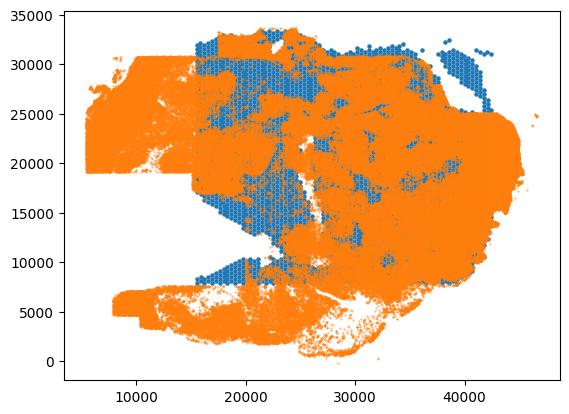

In [95]:
plt.scatter(grid_set[:,0],grid_set[:,1],s=5)
plt.scatter(point_set[:,0],point_set[:,1],s=0.1)

In [96]:
pairs, counts = find_points_within_radius_fast(grid_set, point_set, radius)

In [97]:
pairs.shape

(54667, 2)

In [98]:
pairs

array([[     5,    242],
       [     6,    242],
       [     7,    242],
       ...,
       [189593,     35],
       [189595,     35],
       [189597,     35]])

In [99]:
counts.shape

(4168,)

In [349]:
ad_xen.obs['spot']=None

In [350]:
ad_xen.obs

,in_tissue,spot
aaaadjeh-1,1,None
aaaafmll-1,1,None
aaaahcpb-1,1,None
aaaaibfe-1,1,None
aaaajcfe-1,1,None
...,...,...
oilfamde-1,1,None
oilfccnd-1,1,None
oilfhkkg-1,1,None
oilgaoff-1,1,None


In [352]:
ad_xen.obs.iloc[pairs[:,0], 1]=ad.obs.iloc[pairs[:,1]].index

In [353]:
ad_xen.obs

,in_tissue,spot
aaaadjeh-1,1,None
aaaafmll-1,1,None
aaaahcpb-1,1,None
aaaaibfe-1,1,None
aaaajcfe-1,1,None
...,...,...
oilfamde-1,1,TNBC_processed_adata_AACGAGCTAATAACTA-1
oilfccnd-1,1,None
oilfhkkg-1,1,TNBC_processed_adata_AACGAGCTAATAACTA-1
oilgaoff-1,1,None


In [354]:
ad_xen.write_h5ad('/condo/wanglab/shared/wxc/clip/data/human/HM_data/TNBC_Xenium.h5ad')

In [355]:
ad_xen

AnnData object with n_obs × n_vars = 189598 × 280
    obs: 'in_tissue', 'spot'
    var: 'gene_ids', 'feature_types'
    uns: 'spatial'
    obsm: 'spatial'

In [357]:
ad_xen_sp = ad_xen[ad_xen.obs.dropna().index]

In [358]:
ad_xen_sp

View of AnnData object with n_obs × n_vars = 54667 × 280
    obs: 'in_tissue', 'spot'
    var: 'gene_ids', 'feature_types'
    uns: 'spatial'
    obsm: 'spatial'

In [361]:
ad_xen_sp.write_h5ad('/condo/wanglab/shared/wxc/clip/data/human/HM_data/TNBC_Xenium_spot.h5ad')

In [117]:
ad.var.index.duplicated().sum()

0

In [118]:
ad.obs['cell_num']=counts

In [119]:
ad.obs

,in_tissue,array_row,array_col,pixel_y,pixel_x,cell_num
TNBC_processed_adata_AACACGTGCATCGCAC-1,1,76,22,15870,28972,1
TNBC_processed_adata_AACACTTGGCAAGGAA-1,1,47,71,26019,19136,12
TNBC_processed_adata_AACAGGAAGAGCATAG-1,1,69,7,18314,31989,22
TNBC_processed_adata_AACAGGATTCATAGTT-1,1,49,43,25314,24762,24
TNBC_processed_adata_AACAGGCCAACGATTA-1,1,71,127,17639,7875,0
...,...,...,...,...,...,...
TNBC_processed_adata_TGTTGGAACCTTCCGC-1,1,35,35,30208,26374,30
TNBC_processed_adata_TGTTGGAACGAGGTCA-1,1,28,72,32663,18942,32
TNBC_processed_adata_TGTTGGAAGCTCGGTA-1,1,1,95,42108,14329,29
TNBC_processed_adata_TGTTGGATGGACTTCT-1,1,13,53,37904,22765,9


In [120]:
ad

AnnData object with n_obs × n_vars = 4168 × 18085
    obs: 'in_tissue', 'array_row', 'array_col', 'pixel_y', 'pixel_x', 'cell_num'
    var: 'gene_ids', 'feature_types', 'genome'
    uns: 'spatial'
    obsm: 'spatial'

In [121]:
ad.var.index.duplicated().sum()

0

In [122]:
ad.write_h5ad(data_path+sample_name+'_cell_num.h5ad')

## QC

In [70]:
ad_xen_sp = sc.read_h5ad('/condo/wanglab/shared/wxc/clip/data/human/HM_data/TNBC_Xenium_spot.h5ad')

In [71]:
ad_xen_sp

AnnData object with n_obs × n_vars = 54667 × 280
    obs: 'in_tissue', 'spot'
    var: 'gene_ids', 'feature_types'
    uns: 'spatial'
    obsm: 'spatial'

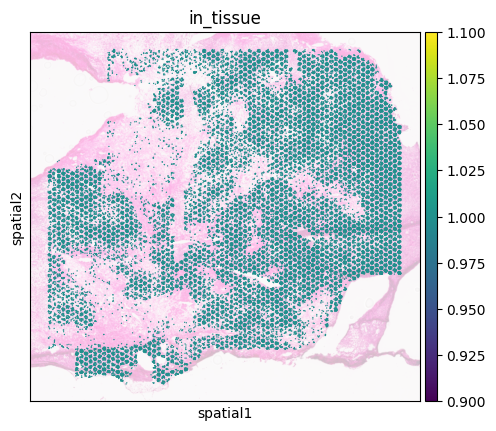

In [72]:
sc.pl.spatial(ad_xen_sp, color='in_tissue', alpha_img=0.3,spot_size=100)

In [73]:
ad_xen_sp.layers["counts"] = ad_xen_sp.X.copy()

In [74]:
sc.pp.filter_cells(ad_xen_sp, min_counts=10)

In [75]:
ad_xen_sp

AnnData object with n_obs × n_vars = 54102 × 280
    obs: 'in_tissue', 'spot', 'n_counts'
    var: 'gene_ids', 'feature_types'
    uns: 'spatial'
    obsm: 'spatial'
    layers: 'counts'

In [76]:
sc.pp.normalize_total(ad_xen_sp)
sc.pp.log1p(ad_xen_sp)

In [77]:
sc.pp.pca(ad_xen_sp)

In [78]:
sc.pp.neighbors(ad_xen_sp)
# sc.pp.neighbors(ad_xen_sp, n_neighbors=20)

In [79]:
# sc.tl.leiden(ad_xen_sp, resolution=1.3)
sc.tl.leiden(ad_xen_sp)

In [80]:
# sc.tl.umap(ad_xen_sp)
sc.tl.umap(ad_xen_sp, min_dist=0.1)

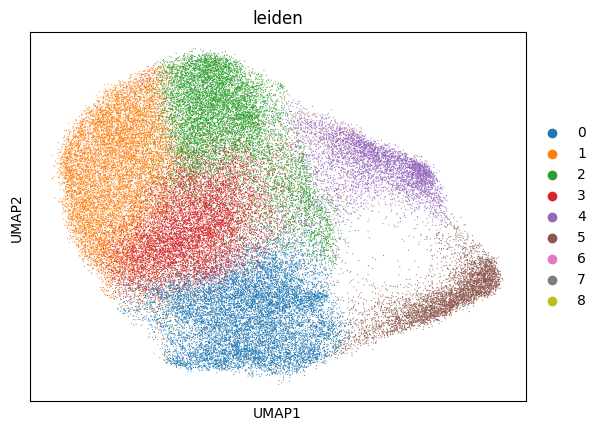

In [81]:
sc.pl.umap(ad_xen_sp, color='leiden', color_map='tab10')

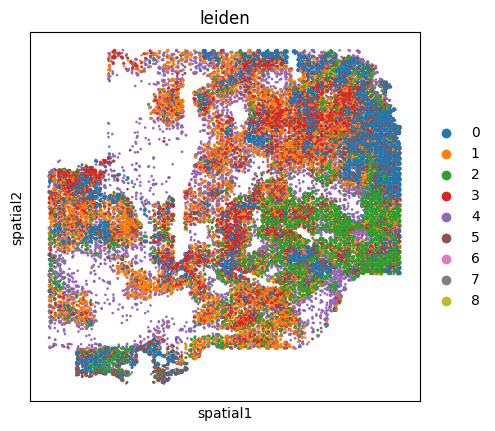

In [82]:
sc.pl.spatial(ad_xen_sp, color='leiden', alpha_img=0, spot_size=200)

In [83]:
sc.tl.tsne(ad_xen_sp)

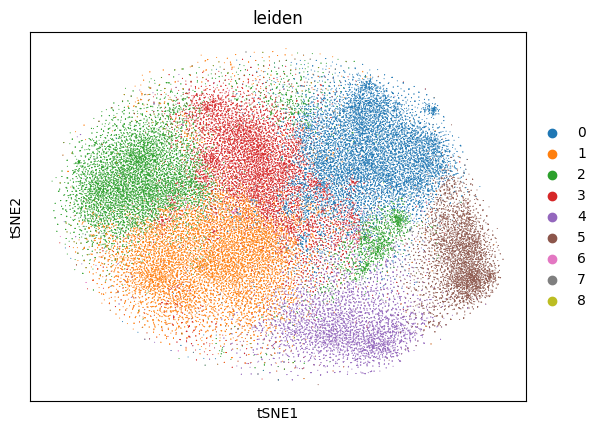

In [84]:
sc.pl.tsne(ad_xen_sp, color='leiden')

In [85]:
# sc.tl.louvain(ad_xen_sp, resolution=1.4)
sc.tl.louvain(ad_xen_sp)

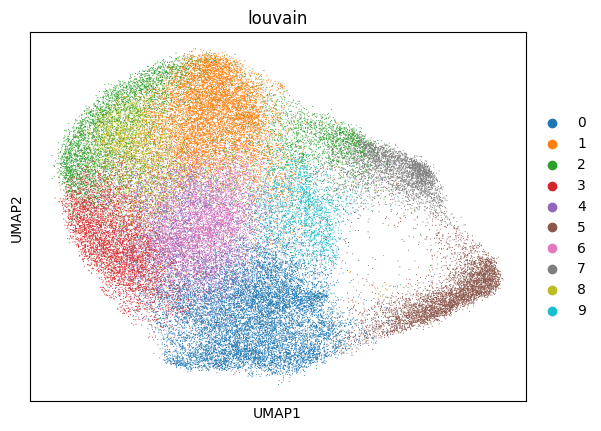

In [86]:
sc.pl.umap(ad_xen_sp, color='louvain')

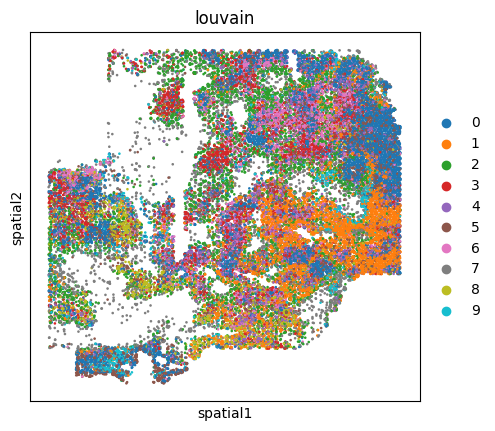

In [87]:
sc.pl.spatial(ad_xen_sp, color='louvain', alpha_img=0, spot_size=200)

In [88]:
marker_genes = {
    "Epithelial": ["KRT7", "KRT8", "KRT14", "KRT23", "ERBB2", "CDH1", "EPCAM", "EGFR", "KLF5", "DSP", "FOXA1"],
    "Myoepithelial": ["ACTA2"],
    "Macrophage": ["LYZ", "CD68", "FCER1G", "ITGAX", "CD163", "MRC1", "ITGAM", "FGL2", "ZEB2"],
    "Stroma": ["POSTN", "PDGFRB", "FBLN1", "TCF4", "LRRC15"],
    "B Cell": ["MZB1", "CD79A", "CD19", "CD79B", "MS4A1", "BANK1"],
    "Endothelial": ["VWF", "KDR", "CAV1", "ESM1", "PECAM1", "EGFL7"],
    "T Cell": ["PTPRC", "IL2RA", "CD3E", "FOXP3", "SLAMF7", "SLAMF1", "RORC", "CD4", "CD8A", "CTLA4", "IL7R", "CCL5", "IL2RG"],
    "Mast Cell": ["CD69"],
    "DCIS": ["CEACAM6"],
    "Invasive Tumor":["FASN"],
}

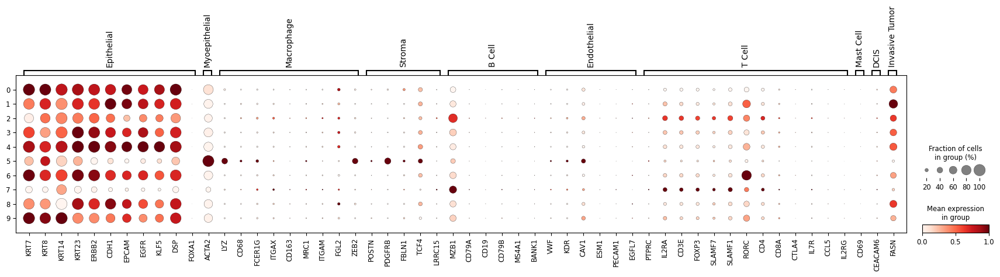

In [89]:
sc.pl.dotplot(ad_xen_sp, marker_genes, 
              # groupby="leiden", 
              groupby="louvain", 
              standard_scale="var"
             )

In [90]:
# ad_xen_sp.obs["cell_type_leiden10"] = ad_xen_sp.obs["leiden"].map(
#     {
#         "1": "Immune",
#         "6": "Stroma"
#     }
# )

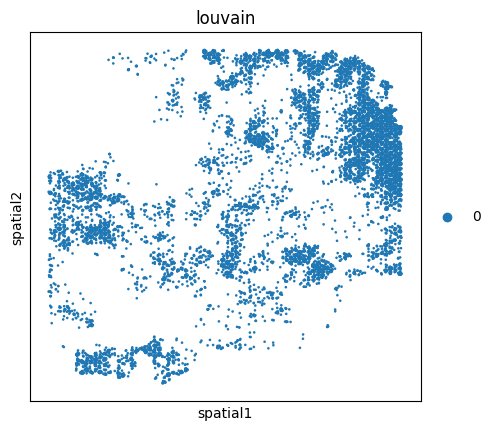

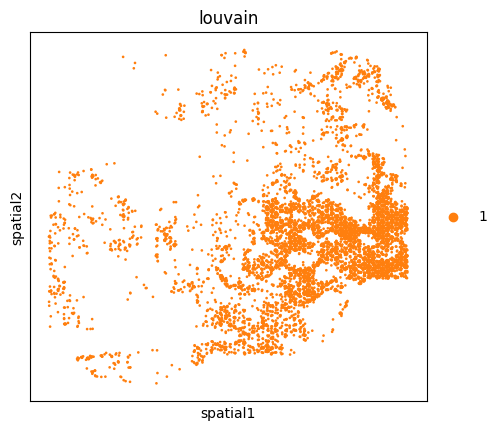

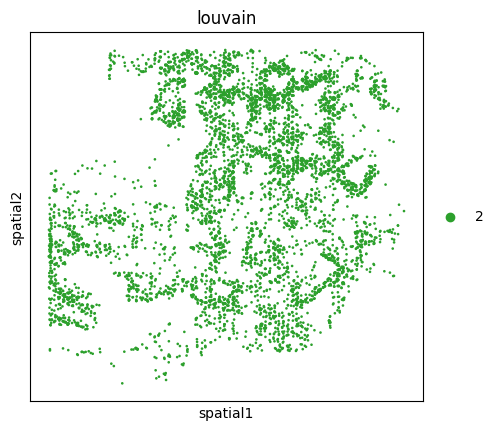

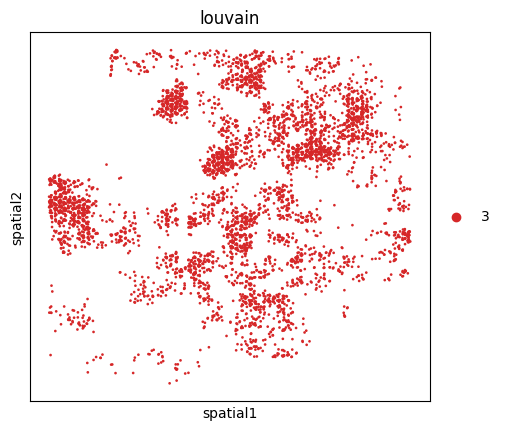

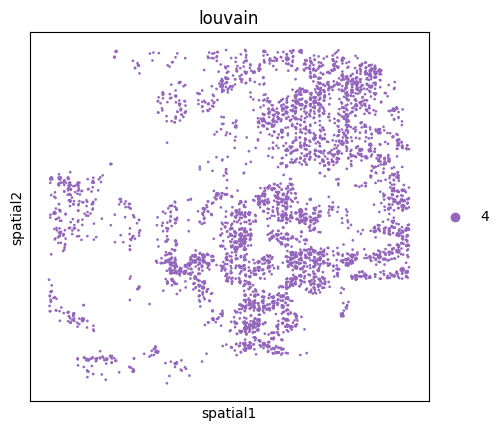

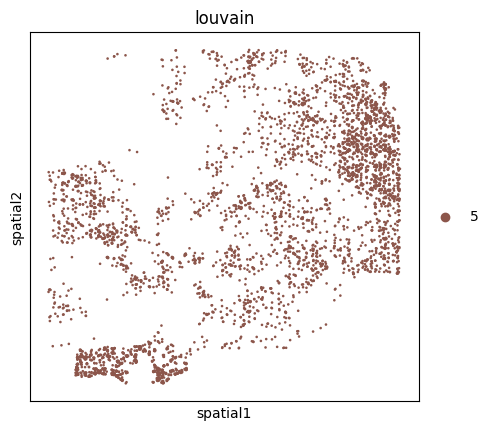

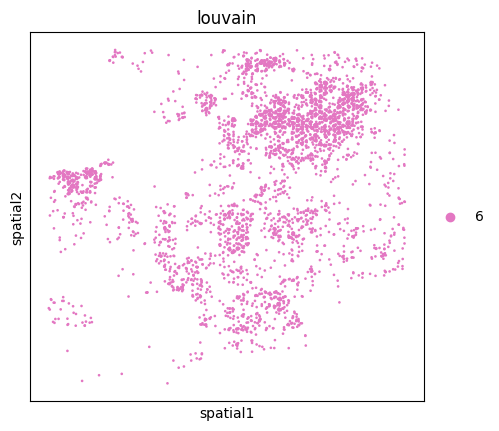

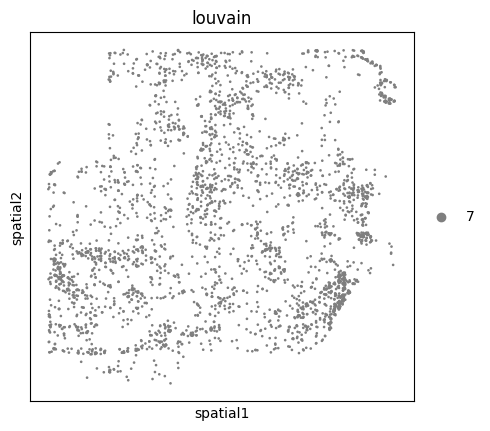

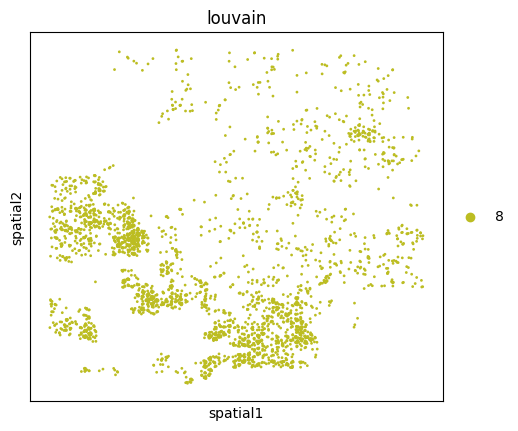

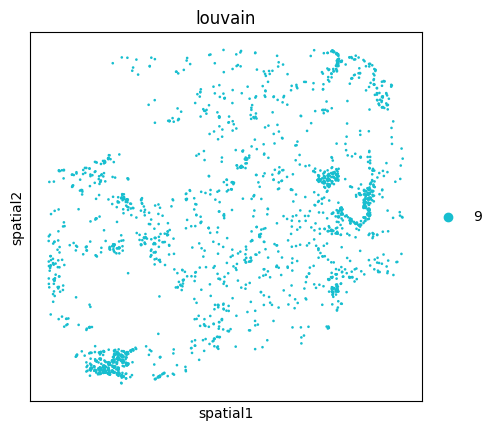

In [91]:
for i in range(10):
    sc.pl.spatial(ad_xen_sp[ad_xen_sp.obs['louvain']==str(i)], color='louvain', alpha_img=0, spot_size=200)

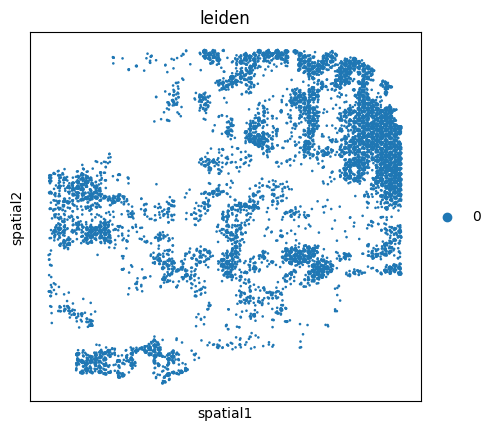

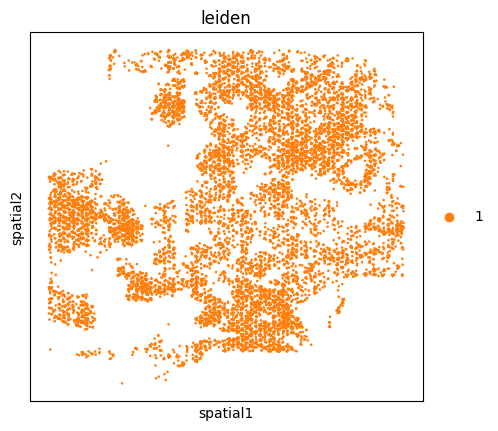

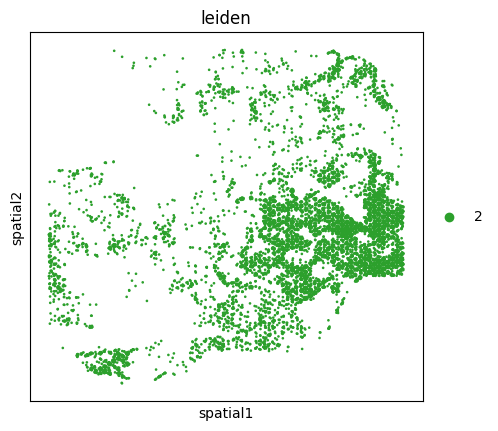

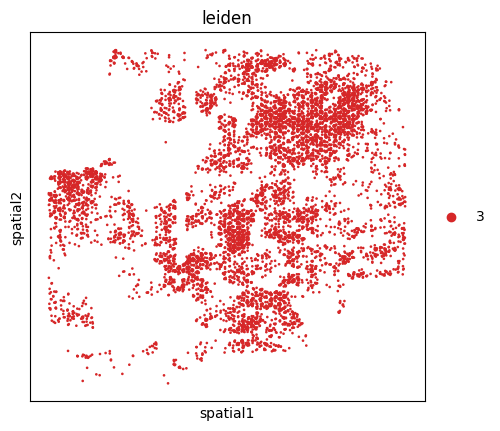

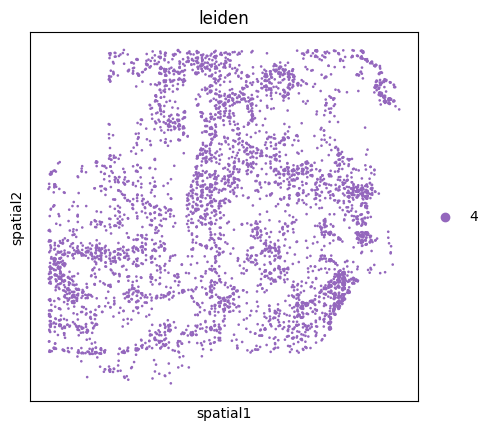

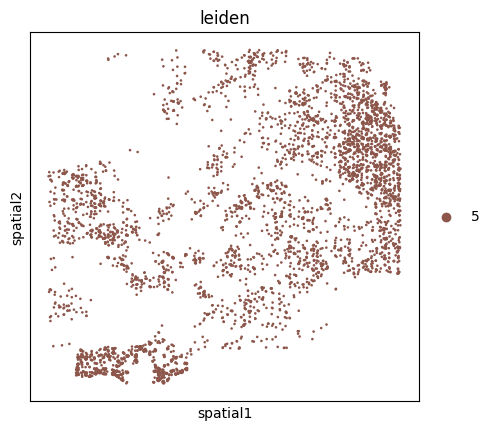

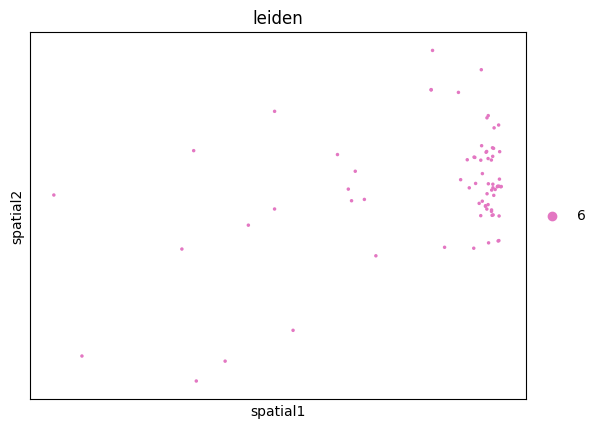

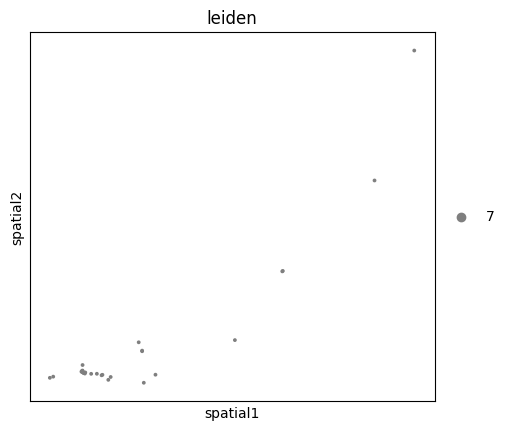

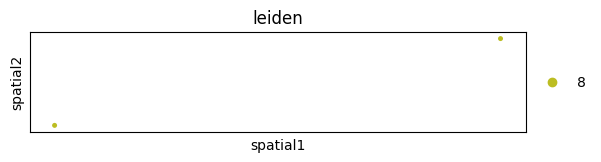

In [92]:
for i in range(9):
    sc.pl.spatial(ad_xen_sp[ad_xen_sp.obs['leiden']==str(i)], color='leiden', alpha_img=0, spot_size=200)

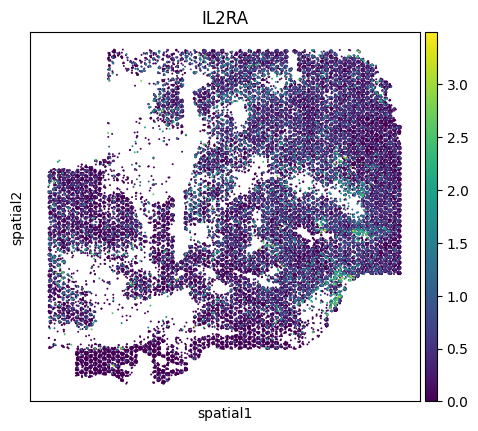

In [93]:
sc.pl.spatial(ad_xen_sp, color='IL2RA',alpha_img=0,spot_size=150)

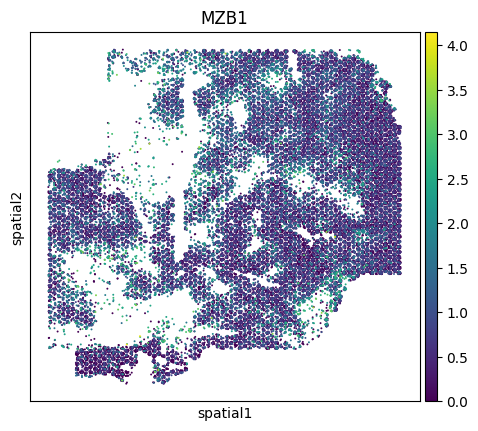

In [94]:
sc.pl.spatial(ad_xen_sp, color='MZB1',alpha_img=0,spot_size=150)

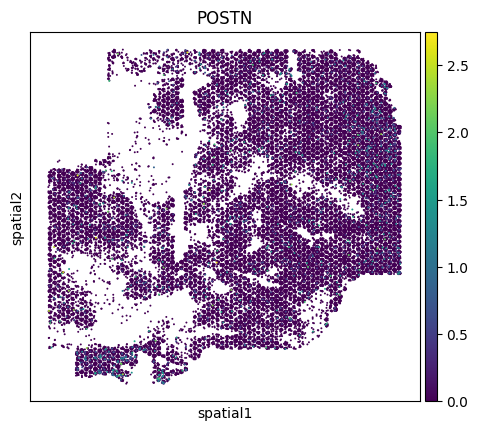

In [95]:
sc.pl.spatial(ad_xen_sp, color='POSTN',alpha_img=0,spot_size=150)

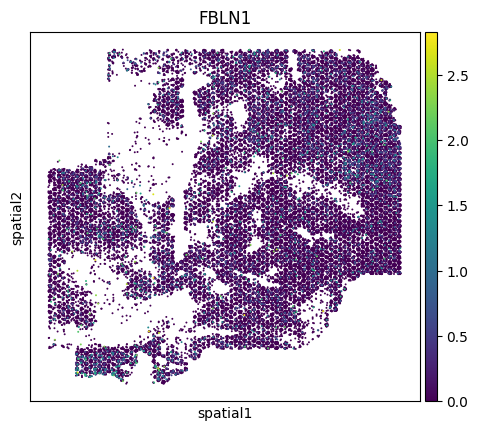

In [96]:
sc.pl.spatial(ad_xen_sp, color='FBLN1',alpha_img=0,spot_size=150)

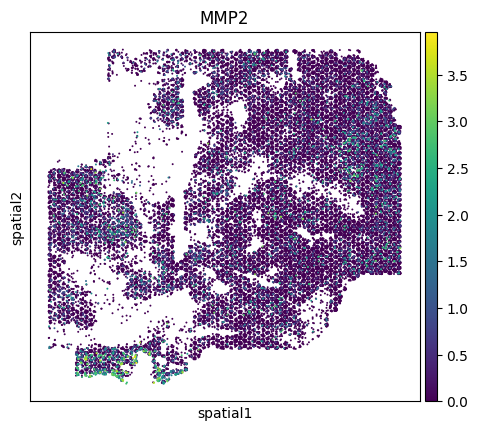

In [97]:
sc.pl.spatial(ad_xen_sp, color='MMP2',alpha_img=0,spot_size=150)

In [98]:
sc.tl.rank_genes_groups(ad_xen_sp, 
                        groupby='louvain',
                        # method='wilcoxon'
                       )

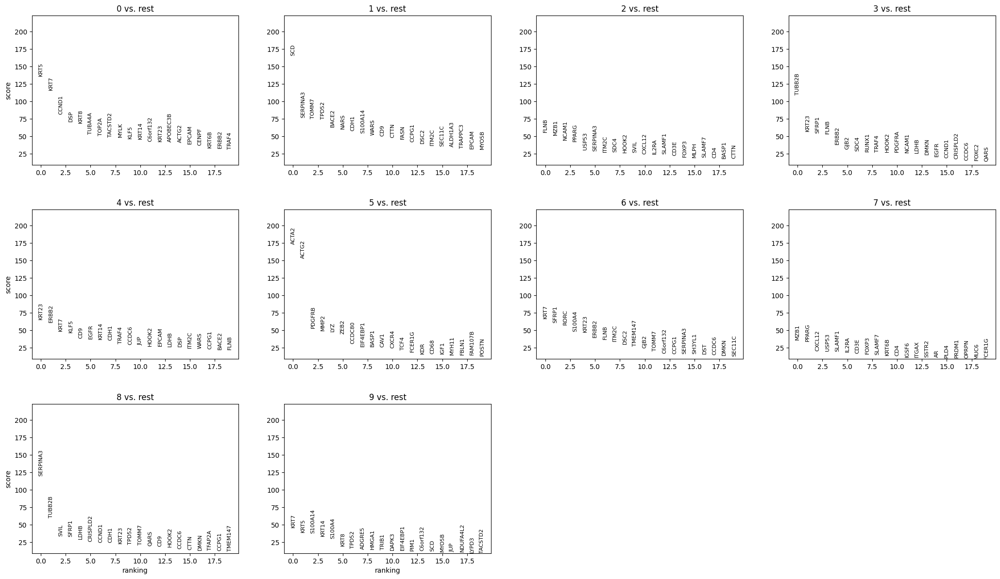

In [99]:
sc.pl.rank_genes_groups(ad_xen_sp)

In [100]:
sc.tl.dendrogram(ad_xen_sp, 
                 groupby="louvain"
                )

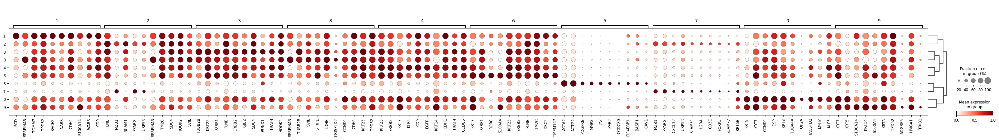

In [101]:
sc.pl.rank_genes_groups_dotplot(
    ad_xen_sp, 
    groupby="louvain", 
    standard_scale="var", 
    n_genes=10
)

In [102]:
ad_xen_sp.obs["cell_type_lv"] = ad_xen_sp.obs["louvain"].map(
    {
        "0": "Basal-like cancer",
        "1": "Epithelial1",
        "2": "Epithelial1",
        "3": "Epithelial2",        
        "4": "Epithelial3",
        "5": "Stroma",  
        "6": "Epithelial3",  
        "7": "Immune",
        "8": "Epithelial2",
        "9": "Basal-like cancer",
    }
)

In [103]:
ad_xen_sp.obs["cell_type"] = ad_xen_sp.obs["cell_type_lv"].map(
    {
        "Basal-like cancer": "Epithelial",
        "Epithelial1": "Epithelial",
        "Epithelial2": "Epithelial",
        "Epithelial3": "Epithelial",        
        "Stroma": "Stroma",
        "Immune": "Immune",  
    }
)

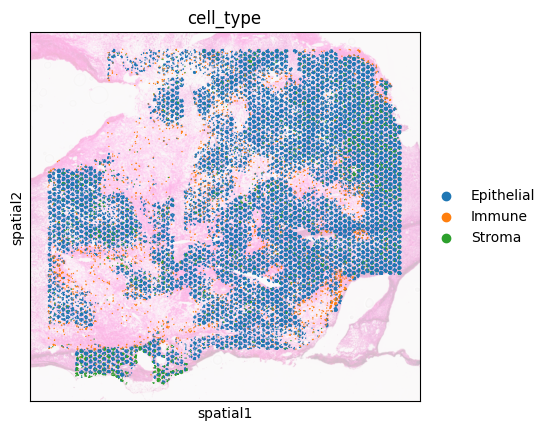

In [104]:
sc.pl.spatial(ad_xen_sp, color='cell_type', alpha_img=0.3, spot_size=100)

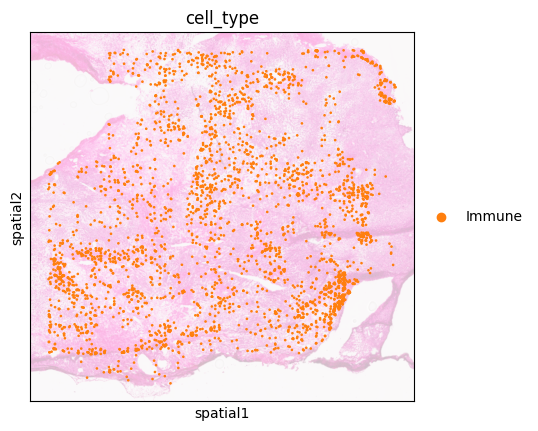

In [105]:
sc.pl.spatial(ad_xen_sp[ad_xen_sp.obs['cell_type']=='Immune'], color='cell_type', alpha_img=0.3, spot_size=200)

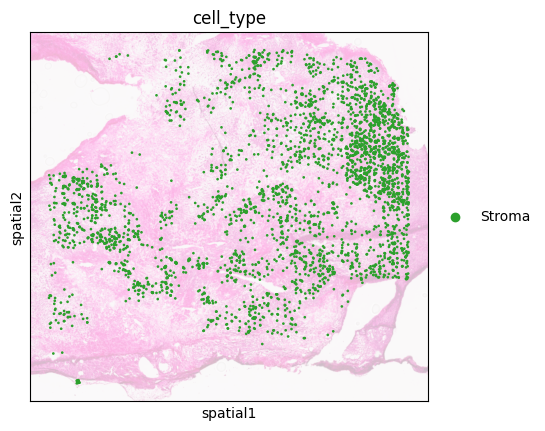

In [447]:
sc.pl.spatial(ad_xen_sp[ad_xen_sp.obs['cell_type']=='Stroma'], color='cell_type', alpha_img=0.3, spot_size=200)

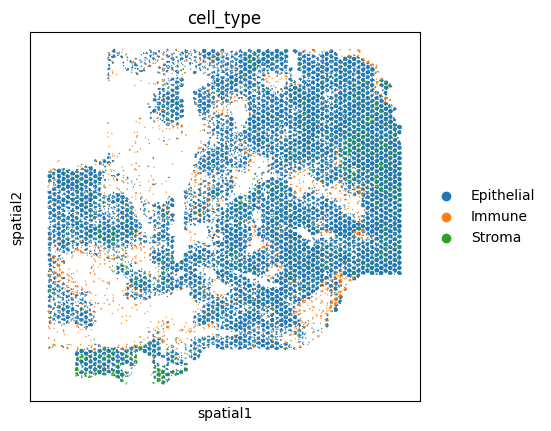

In [259]:
sc.pl.spatial(ad_xen_sp, color='cell_type', alpha_img=0, spot_size=100)

In [52]:
ad_xen_sp.obs

,in_tissue,spot,n_counts,leiden,louvain,cell_type_lv,cell_type
aaaanbak-1,1,TNBC_processed_adata_ACAGAATACATACTAA-1,127.0,2,1,Epithelial1,Epithelial
aaaanegh-1,1,TNBC_processed_adata_ACAGAATACATACTAA-1,214.0,2,1,Epithelial1,Epithelial
aaaanhnf-1,1,TNBC_processed_adata_ACAGAATACATACTAA-1,123.0,2,1,Epithelial1,Epithelial
aaaapjii-1,1,TNBC_processed_adata_ACAGAATACATACTAA-1,416.0,2,1,Epithelial1,Epithelial
aaabaaca-1,1,TNBC_processed_adata_ACAGAATACATACTAA-1,521.0,2,0,Basal-like cancer,Epithelial
...,...,...,...,...,...,...,...
oilefejp-1,1,TNBC_processed_adata_AACGAGCTAATAACTA-1,78.0,5,5,Stroma,Stroma
oilejpac-1,1,TNBC_processed_adata_AACGAGCTAATAACTA-1,281.0,3,4,Epithelial3,Epithelial
oilfamde-1,1,TNBC_processed_adata_AACGAGCTAATAACTA-1,144.0,3,6,Epithelial3,Epithelial
oilfhkkg-1,1,TNBC_processed_adata_AACGAGCTAATAACTA-1,187.0,3,4,Epithelial3,Epithelial


In [106]:
ad_xen_sp.write_h5ad('/condo/wanglab/shared/wxc/clip/data/human/HM_data/TNBC_Xenium_spot_anno.h5ad')

# Visium Data

## Preprocess Data

In [283]:
ad = sc.read_h5ad(data_path+sample_name+'_cell_num.h5ad')

In [284]:
ad

AnnData object with n_obs × n_vars = 4168 × 18085
    obs: 'in_tissue', 'array_row', 'array_col', 'pixel_y', 'pixel_x', 'cell_num'
    var: 'gene_ids', 'feature_types', 'genome'
    uns: 'spatial'
    obsm: 'spatial'

In [285]:
ad.X.todense()

matrix([[0., 0., 0., ..., 0., 0., 1.],
        [1., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        ...,
        [0., 0., 0., ..., 0., 3., 0.],
        [3., 0., 1., ..., 0., 1., 2.],
        [0., 1., 1., ..., 0., 1., 0.]], dtype=float32)

In [286]:
# ad.var_names_make_unique()
# ad.obs.index = sample_name+'_'+ad.obs.index
# ad.obs[['pixel_y','pixel_x']] = ad.obsm['spatial']
# ad.write_h5ad(data_path+sample_name+'.h5ad')

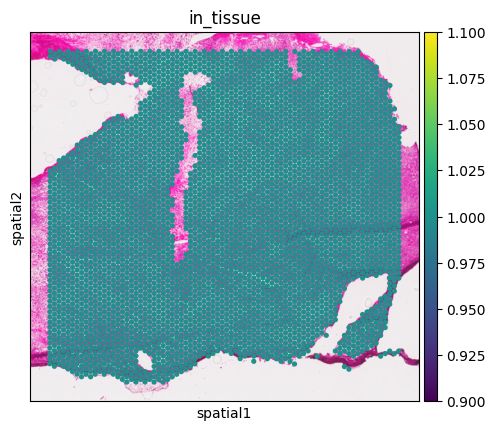

In [287]:
sc.pl.spatial(ad, alpha_img=1,color='in_tissue',spot_size=400)

In [288]:
ad_xen_sp = sc.read_h5ad('/condo/wanglab/shared/wxc/clip/data/human/HM_data/TNBC_Xenium_spot_anno.h5ad')

In [289]:
ad = ad[ad.obs.index.isin(ad_xen_sp.obs['spot'])]

In [290]:
ad

View of AnnData object with n_obs × n_vars = 3402 × 18085
    obs: 'in_tissue', 'array_row', 'array_col', 'pixel_y', 'pixel_x', 'cell_num'
    var: 'gene_ids', 'feature_types', 'genome'
    uns: 'spatial'
    obsm: 'spatial'

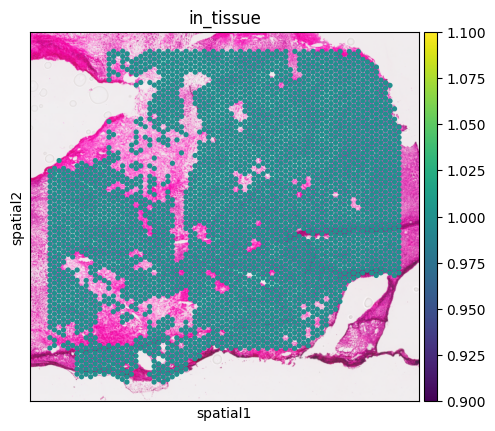

In [291]:
sc.pl.spatial(ad, alpha_img=1,color='in_tissue',spot_size=400)

In [292]:
sc.pp.filter_cells(ad, min_genes=100)
sc.pp.filter_genes(ad, min_cells=3)

In [293]:
ad

AnnData object with n_obs × n_vars = 3104 × 16300
    obs: 'in_tissue', 'array_row', 'array_col', 'pixel_y', 'pixel_x', 'cell_num', 'n_genes'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells'
    uns: 'spatial'
    obsm: 'spatial'

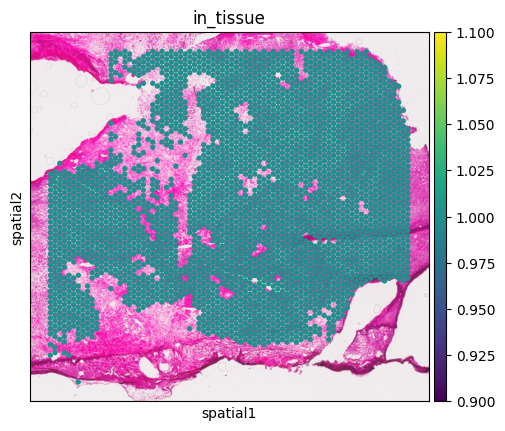

In [294]:
sc.pl.spatial(ad, alpha_img=1,color='in_tissue',spot_size=400)

In [295]:
ad = ad[ad.obs['cell_num']>0]

In [296]:
ad

View of AnnData object with n_obs × n_vars = 3104 × 16300
    obs: 'in_tissue', 'array_row', 'array_col', 'pixel_y', 'pixel_x', 'cell_num', 'n_genes'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells'
    uns: 'spatial'
    obsm: 'spatial'

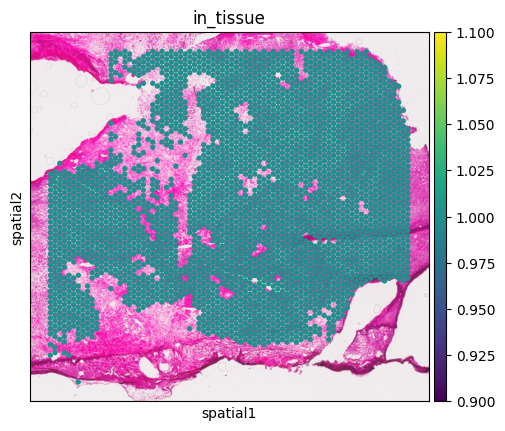

In [297]:
sc.pl.spatial(ad, alpha_img=1,color='in_tissue',spot_size=400)

In [298]:
ad.layers["counts"] = ad.X.copy()

In [299]:
sc.pp.normalize_total(ad)
sc.pp.log1p(ad)

In [300]:
ad.X.todense()

matrix([[0.        , 0.        , 0.        , ..., 0.        , 0.        ,
         3.167056  ],
        [1.818519  , 0.        , 0.        , ..., 0.        , 0.        ,
         0.        ],
        [0.8961585 , 0.        , 0.        , ..., 0.        , 0.8961585 ,
         0.8961585 ],
        ...,
        [0.        , 0.        , 0.        , ..., 0.        , 2.120819  ,
         0.        ],
        [0.75166786, 0.        , 0.31737044, ..., 0.        , 0.31737044,
         0.55791295],
        [0.        , 1.0857089 , 1.0857089 , ..., 0.        , 1.0857089 ,
         0.        ]], dtype=float32)

In [301]:
ad.write_h5ad(data_path+sample_name+'_filter100g.h5ad')

## QC

In [302]:
ad = sc.read_h5ad(data_path+sample_name+'_filter100g.h5ad')

In [303]:
ad

AnnData object with n_obs × n_vars = 3104 × 16300
    obs: 'in_tissue', 'array_row', 'array_col', 'pixel_y', 'pixel_x', 'cell_num', 'n_genes'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells'
    uns: 'log1p', 'spatial'
    obsm: 'spatial'
    layers: 'counts'

In [304]:
sc.pp.pca(ad)
sc.pp.neighbors(ad)

In [332]:
sc.tl.umap(ad)

In [346]:
sc.tl.leiden(ad, resolution=0.247)

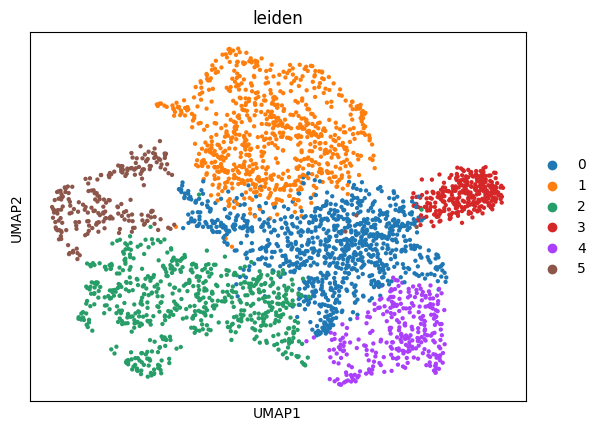

In [347]:
sc.pl.umap(ad, color='leiden')

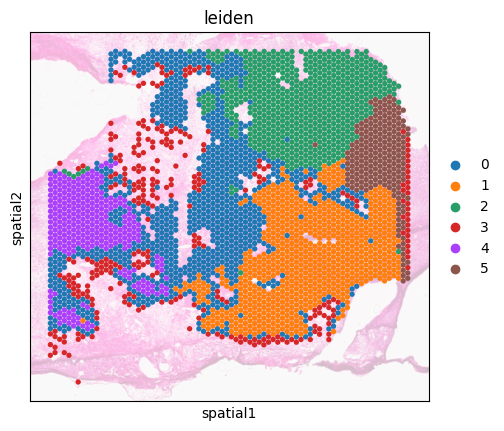

In [348]:
sc.pl.spatial(ad, color='leiden',alpha_img=0.3,spot_size=400)

In [328]:
sc.tl.louvain(ad, resolution=0.3)

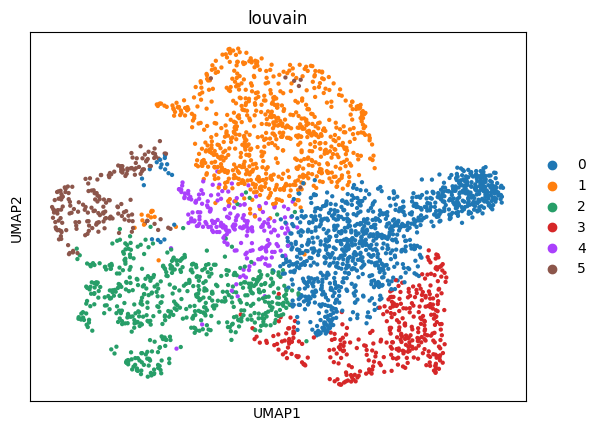

In [329]:
sc.pl.umap(ad, color='louvain')

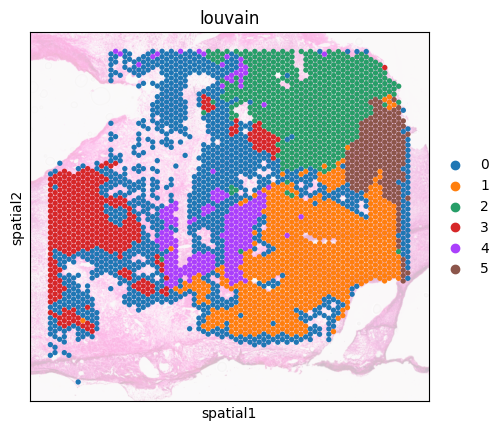

In [330]:
sc.pl.spatial(ad, color='louvain',alpha_img=0.3,spot_size=400)

In [356]:
sc.tl.rank_genes_groups(ad, 
                        groupby='louvain',
                        # method='wilcoxon'
                       )

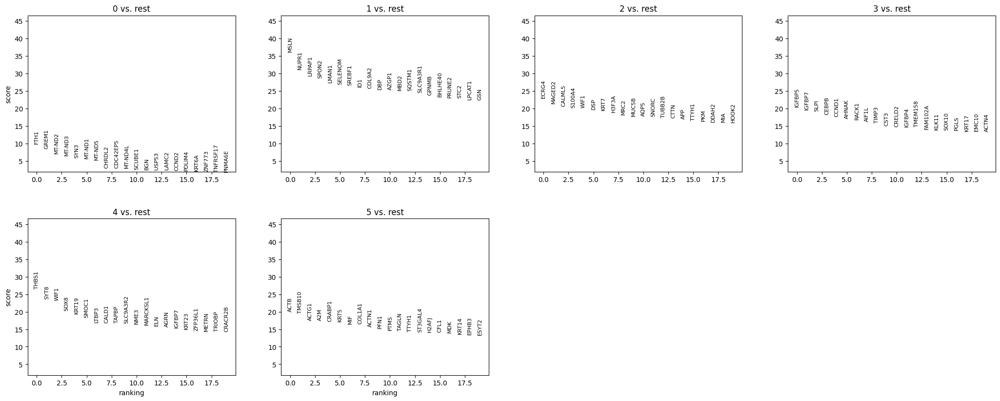

In [357]:
sc.pl.rank_genes_groups(ad)

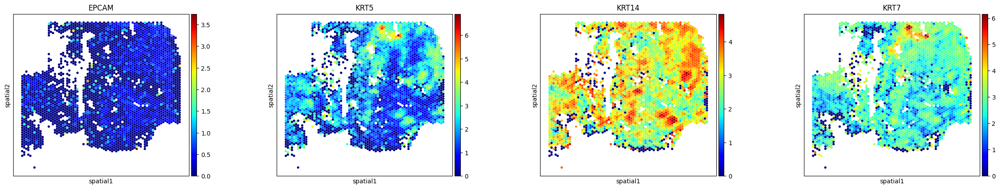

In [365]:
sc.pl.spatial(ad, alpha_img=0,color=['EPCAM', 'KRT5', 'KRT14', 'KRT7'],spot_size=400, cmap='jet')

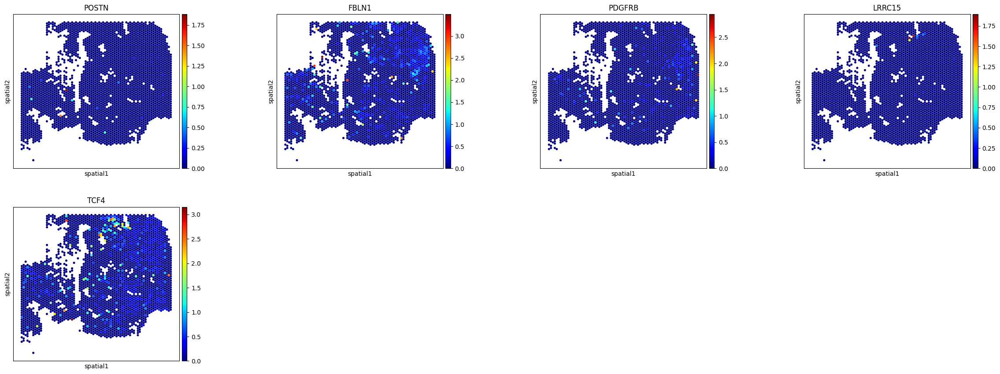

In [375]:
sc.pl.spatial(ad, color=['POSTN', 'FBLN1','PDGFRB', 'LRRC15', 'TCF4'], alpha_img=0, cmap='jet', spot_size=400)

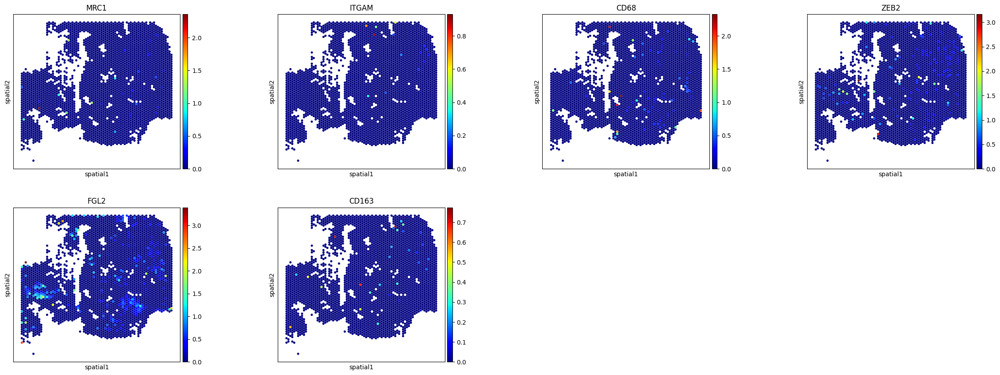

In [377]:
sc.pl.spatial(ad, color=['MRC1', 'ITGAM', 'CD68', 'ZEB2', 'FGL2', 'CD163'], alpha_img=0, cmap='jet', spot_size=400)

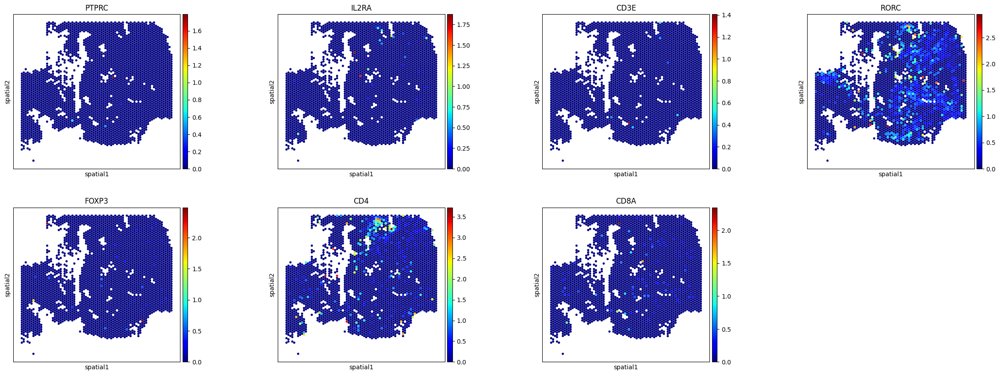

In [387]:
sc.pl.spatial(ad, color=['PTPRC', 'IL2RA', 'CD3E', 'RORC', 'FOXP3','CD4','CD8A'], alpha_img=0, cmap='jet', spot_size=400)

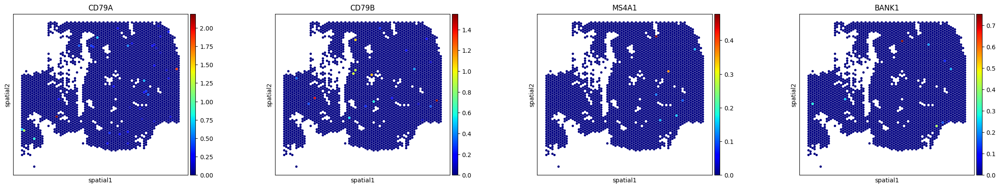

In [385]:
sc.pl.spatial(ad, color=['CD79A', 'CD79B', 'MS4A1','BANK1'], alpha_img=0, cmap='jet', spot_size=400)

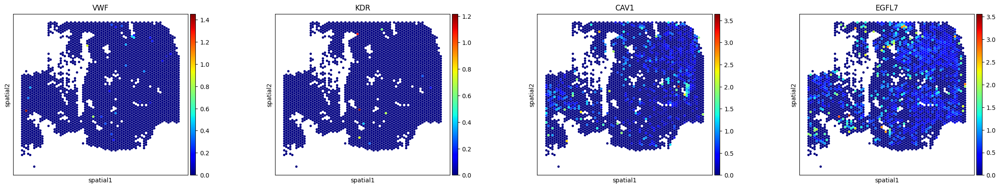

In [386]:
sc.pl.spatial(ad, color=['VWF', 'KDR', 'CAV1', 'EGFL7'], alpha_img=0, cmap='jet', spot_size=400)

# Pie Plot

In [41]:
def plt_pie_chart(data, coordinates):
    fig = plt.figure(figsize=(8, 8))
    for i in tqdm(range(data.shape[0])):
        sizes = data[i]
        coord = coordinates[i]
        subax = fig.add_axes([coord[0], coord[1], 0.011, 0.011])
        subax.pie(sizes, colors=colors)
        subax.set_aspect('equal')  # Ensure the pie is drawn as a circle.
    plt.show()

In [38]:
cmap = plt.colormaps["Set1"]
colors = cmap([1, 0, 2])

In [214]:
ad_expr = sc.read_h5ad(data_path+sample_name+'_filter100g.h5ad')
ad_expr

AnnData object with n_obs × n_vars = 3104 × 16300
    obs: 'in_tissue', 'array_row', 'array_col', 'pixel_y', 'pixel_x', 'cell_num', 'n_genes'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells'
    uns: 'log1p', 'spatial'
    obsm: 'spatial'
    layers: 'counts'

In [215]:
ad_xen_sp = sc.read_h5ad('/condo/wanglab/shared/wxc/clip/data/human/HM_data/TNBC_Xenium_spot_anno.h5ad')
ad_xen_sp

AnnData object with n_obs × n_vars = 54102 × 280
    obs: 'in_tissue', 'spot', 'n_counts', 'leiden', 'louvain', 'cell_type_lv', 'cell_type'
    var: 'gene_ids', 'feature_types'
    uns: 'cell_type_colors', 'dendrogram_louvain', 'leiden', 'leiden_colors', 'log1p', 'louvain', 'louvain_colors', 'neighbors', 'pca', 'rank_genes_groups', 'spatial', 'tsne', 'umap'
    obsm: 'X_pca', 'X_tsne', 'X_umap', 'spatial'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'connectivities', 'distances'

In [216]:
ad_xen_sp = ad_xen_sp[ad_xen_sp.obs['spot'].isin(ad_expr.obs.index)]
ad_xen_sp

View of AnnData object with n_obs × n_vars = 50592 × 280
    obs: 'in_tissue', 'spot', 'n_counts', 'leiden', 'louvain', 'cell_type_lv', 'cell_type'
    var: 'gene_ids', 'feature_types'
    uns: 'cell_type_colors', 'dendrogram_louvain', 'leiden', 'leiden_colors', 'log1p', 'louvain', 'louvain_colors', 'neighbors', 'pca', 'rank_genes_groups', 'spatial', 'tsne', 'umap'
    obsm: 'X_pca', 'X_tsne', 'X_umap', 'spatial'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'connectivities', 'distances'

In [217]:
ad_xen_sp.obs['cell_type'].value_counts()/ad_xen_sp.obs['cell_type'].value_counts().sum()

cell_type
Epithelial    0.867825
Stroma        0.075249
Immune        0.056926
Name: count, dtype: float64

In [218]:
deconv_df = ad_xen_sp.obs.pivot_table(index='spot', columns='cell_type', aggfunc='size', fill_value=0).reindex(ad_expr.obs.index).T
deconv_df = deconv_df/deconv_df.sum(axis=0)
deconv_df

,TNBC_processed_adata_AACACGTGCATCGCAC-1,TNBC_processed_adata_AACACTTGGCAAGGAA-1,TNBC_processed_adata_AACAGGATTCATAGTT-1,TNBC_processed_adata_AACAGGTTATTGCACC-1,TNBC_processed_adata_AACAGGTTCACCGAAG-1,TNBC_processed_adata_AACAGTCGTGTCGCGG-1,TNBC_processed_adata_AACATATTCTTGCGAA-1,TNBC_processed_adata_AACATCGCGTGACCAC-1,TNBC_processed_adata_AACATCTAATGACCGG-1,TNBC_processed_adata_AACATGACTTGGCTGC-1,...,TNBC_processed_adata_TGTTCACTCACGGTAA-1,TNBC_processed_adata_TGTTCAGAACGGTGTA-1,TNBC_processed_adata_TGTTCCTCACATTAAT-1,TNBC_processed_adata_TGTTCTGCTCTGTCGT-1,TNBC_processed_adata_TGTTGCGTCCAAGATT-1,TNBC_processed_adata_TGTTGGAACCTTCCGC-1,TNBC_processed_adata_TGTTGGAACGAGGTCA-1,TNBC_processed_adata_TGTTGGAAGCTCGGTA-1,TNBC_processed_adata_TGTTGGATGGACTTCT-1,TNBC_processed_adata_TGTTGGCCTACACGTG-1
cell_type,,,,,,,,,,,,,,,,,,,,,
Epithelial,1.0,0.916667,0.916667,0.769231,1.0,0.428571,0.8125,0.5,0.8,1.0,...,1.0,1.0,1.0,1.0,0.733333,1.0,1.0,0.793103,1.0,0.8
Immune,0.0,0.083333,0.083333,0.230769,0.0,0.571429,0.1875,0.5,0.1,0.0,...,0.0,0.0,0.0,0.0,0.066667,0.0,0.0,0.000000,0.0,0.2
Stroma,0.0,0.000000,0.000000,0.000000,0.0,0.000000,0.0000,0.0,0.1,0.0,...,0.0,0.0,0.0,0.0,0.200000,0.0,0.0,0.206897,0.0,0.0


In [221]:
data = np.array(deconv_df.T)
coordinates = np.array([ad_expr.obsm['spatial'][:, 0], -ad_expr.obsm['spatial'][:, 1]]).T/ad_expr.obsm['spatial'].max()

100%|██████████| 3104/3104 [00:59<00:00, 51.90it/s]


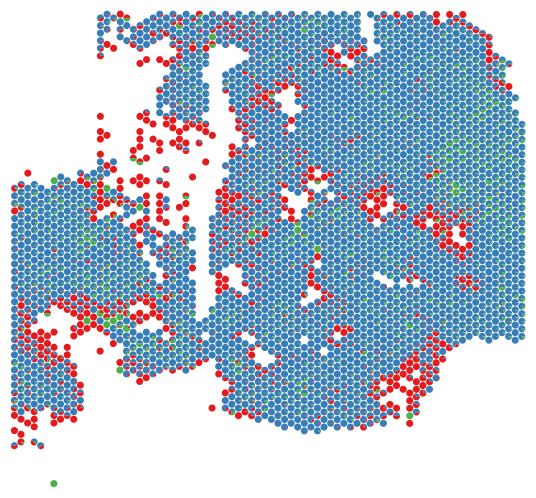

In [224]:
plt_pie_chart(data, coord)

# Features

In [104]:
def generate_features(ad, case_name):
    top_k_genes_str= pd.read_csv(data_path+str(sample_name)+'_training_df.csv', index_col=0)
    text_feature_path = os.path.join(data_path, sample_name+'_txt_features'+case_name+'.csv')
    text_features = pd.DataFrame()
    image_feature_path = os.path.join(data_path, sample_name+'_img_features'+case_name+'.csv')
    image_features = pd.DataFrame()
    warnings.simplefilter(action='ignore')
    for patch_idx in tqdm(ad.obs.index):
    
        text = top_k_genes_str[top_k_genes_str.index==patch_idx]['label'].values[0]
        text_input = tokenizer([text], context_length=76).to(DEVICE)
        with torch.no_grad():
            text_features[patch_idx] = model.encode_text(text_input).cpu().detach().numpy()[0]

        image = Image.open(os.path.join(PATCH_DIR, patch_idx+'_hires.png'))
        image_input = torch.stack([preprocess(image)]).to(DEVICE)
        with torch.no_grad():
            image_features[patch_idx] = model.encode_image(image_input).cpu().detach().numpy()[0]
    
    image_features.to_csv(image_feature_path)
    text_features.to_csv(text_feature_path)

## Before Finetune

In [225]:
case_name = '_training20'

### Generate embeddings

In [42]:
def segment_patches(ad):
    library_id = get_library_id(ad)
    scalef = ad.uns['spatial'][library_id]['scalefactors']['tissue_hires_scalef']
    hires_img = ad.uns['spatial'][library_id]['images']['hires']
    if hires_img.max()<1.1:
        hires_img = hires_img*255
    
    spot_dia_px = round(get_spot_diameter_in_pixels(ad)*scalef)
    print(scalef)
    print(spot_dia_px)
    height, width = spot_dia_px, spot_dia_px  # maximum height and width without overlapping among patches
    yrange, xrange = hires_img.shape[:2]
    
    for spot_idx in tqdm(ad.obs.index):
    
        ycenter, xcenter = ad.obs.loc[spot_idx, ["pixel_x","pixel_y"]].astype(float)*scalef
        x1 = round(xcenter - width / 2)
        y1 = round(ycenter - height / 2)
        x2 = x1 + width
        y2 = y1 + height
    
        if x1 < 0 or y1 < 0 or x2 > xrange or y2 > yrange:
            print(f'Patch {spot_idx} is out of range.')
            continue
    
        patch_img = Image.fromarray(hires_img[y1:y2, x1:x2].astype(np.uint8))
        patch_name = '_'.join([f'{spot_idx}_hires.png'])
        patch_path = os.path.join(PATCH_DIR, patch_name)
        patch_img.save(patch_path)

In [26]:
def generate_training_df(ad):
    ad = ad[:,~ad.var.index.str.contains('.', regex=False)]
    ad = ad[:,~ad.var.index.str.contains('-', regex=False)]
    ad = ad[:,~ad.var.index.isin(house_keeping_genes['genesymbol'])]
    expr = pd.DataFrame(ad.X.todense(), index=ad.obs.index, columns=ad.var.index)
    top_k_genes = expr.apply(lambda s, n: pd.Series(s.nlargest(n).index), axis=1, n=k)
    top_k_genes_str = pd.DataFrame()
    top_k_genes_str['label'] = top_k_genes[top_k_genes.columns].astype(str).apply(lambda x: ' '.join(x), axis = 1)
    top_k_genes_str['img_path'] = PATCH_DIR+ad.obs.index+'_hires.png'
    top_k_genes_str.to_csv(data_path+str(sample_name)+'_training_df.csv')

In [32]:
ad = sc.read_h5ad(data_path+sample_name+'.h5ad')

In [43]:
segment_patches(ad)

0.042668488
12


100%|██████████| 4168/4168 [00:33<00:00, 123.24it/s]


In [26]:
tokenizer = get_tokenizer('coca_ViT-L-14')
model_dir = "2024_03_25-19_46_42-model_coca_ViT-L-14-lr_5e-06-b_64-j_8-p_amp"
epoch_n = "epoch_20.pt"
model_path = os.path.join("/condo/wanglab/shared/wxc/clip/models/open_clip-main/logs", model_dir, "checkpoints", epoch_n)
model, preprocess = create_model_from_pretrained("coca_ViT-L-14", device = DEVICE, pretrained=model_path)

In [38]:
generate_training_df(ad)

In [44]:
generate_features(ad, case_name)

100%|██████████| 4168/4168 [02:05<00:00, 33.08it/s]


### QC

In [226]:
ad = sc.read_h5ad(data_path+sample_name+'_filter100g.h5ad')

In [227]:
sc.pp.pca(ad)
sc.pp.neighbors(ad)

In [228]:
sc.tl.umap(ad)

In [229]:
sc.tl.leiden(ad, resolution=0.247)

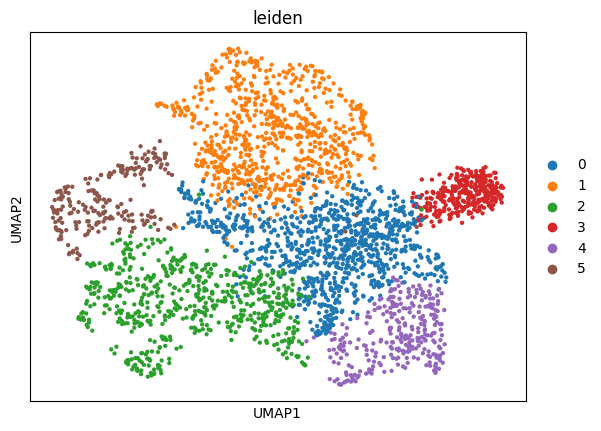

In [230]:
sc.pl.umap(ad, color='leiden')

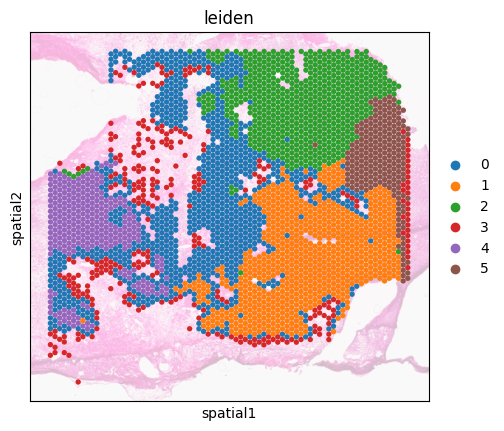

In [231]:
sc.pl.spatial(ad, color='leiden',alpha_img=0.3,spot_size=400)

In [232]:
text_feature_path = os.path.join(data_path, sample_name+'_txt_features'+case_name+'.csv')
text_features = pd.read_csv(text_feature_path, index_col=0)[ad.obs.index]

In [233]:
image_feature_path = os.path.join(data_path, sample_name+'_img_features'+case_name+'.csv')
image_features = pd.read_csv(image_feature_path, index_col=0)[ad.obs.index]

In [234]:
dot_simi = np.dot(np.array(image_features[ad.obs.sort_values('leiden').index]).T, np.array(text_features[ad.obs.sort_values('leiden').index]))

In [ ]:
sns.heatmap(dot_simi)

In [44]:
comb_features = pd.concat([image_features,text_features],axis=1)

In [45]:
pca_comb_features = pca.fit_transform(comb_features.T)

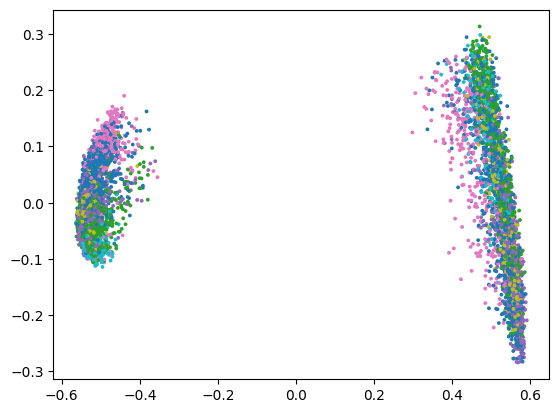

In [46]:
plt.scatter(pca_comb_features[:,0], pca_comb_features[:,1],c=pd.concat([ad.obs['leiden'].astype('category').cat.codes,ad.obs['leiden'].astype('category').cat.codes]), s=3,cmap='tab10')

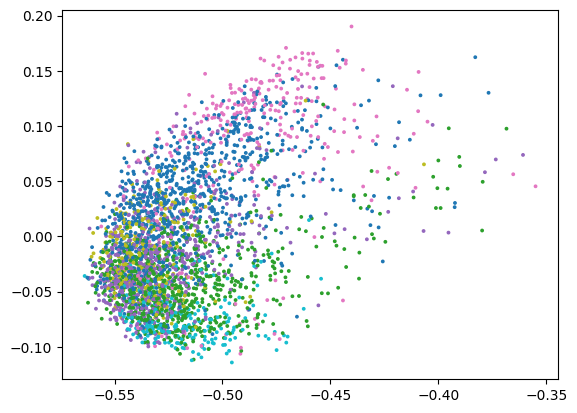

In [47]:
plt.scatter(pca_comb_features[:len(image_features.T),0], pca_comb_features[:len(image_features.T),1],c=ad.obs['leiden'].astype('category').cat.codes, s=3,cmap='tab10')

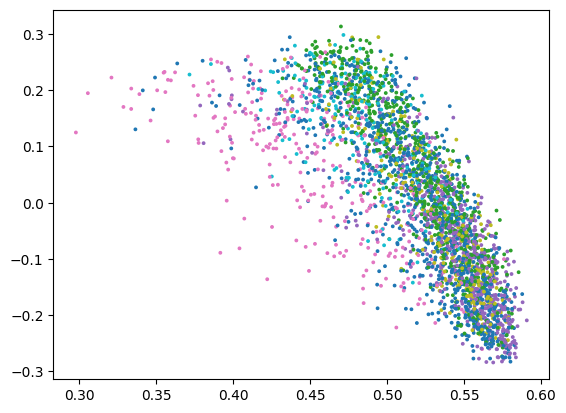

In [48]:
plt.scatter(pca_comb_features[len(image_features.T):,0], pca_comb_features[len(image_features.T):,1],c=ad.obs['leiden'].astype('category').cat.codes, s=3,cmap='tab10')

In [49]:
pca_rgb_comb = (pca_comb_features-pca_comb_features.min(axis=0))/(pca_comb_features.max(axis=0)-pca_comb_features.min(axis=0))
pca_hex_comb = [ rgb2hex(pca_rgb_comb[i,:]) for i in range(pca_rgb_comb.shape[0]) ]

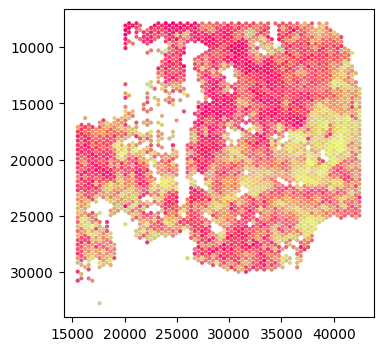

In [50]:
plt.figure(figsize=(4,4))
plt.scatter(ad.obsm['spatial'][:,0], ad.obsm['spatial'][:,1], marker='o', s=4, c=pca_hex_comb[len(image_features.T):])
plt.gca().invert_yaxis()

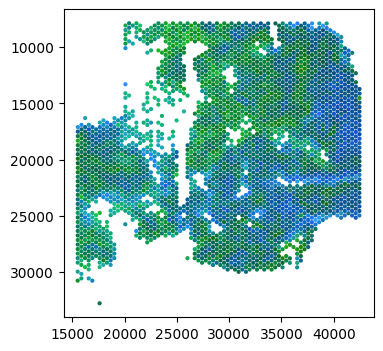

In [51]:
plt.figure(figsize=(4,4))
plt.scatter(ad.obsm['spatial'][:,0], ad.obsm['spatial'][:,1], marker='o', s=4, c=pca_hex_comb[:len(image_features.T)])
plt.gca().invert_yaxis()

In [52]:
txt_ad = anndata.AnnData(text_features.T)

/condo/wanglab/hmaiwxc/anaconda3/envs/clip/lib/python3.9/site-packages/anndata/_core/aligned_df.py:67: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


In [53]:
txt_ad.uns['spatial']=ad.uns['spatial'].copy()
txt_ad.obsm['spatial']=ad.obsm['spatial'].copy()

In [54]:
sc.pp.pca(txt_ad)
sc.pp.neighbors(txt_ad)

In [55]:
sc.tl.leiden(txt_ad)
# sc.tl.leiden(txt_ad,resolution=0.6)

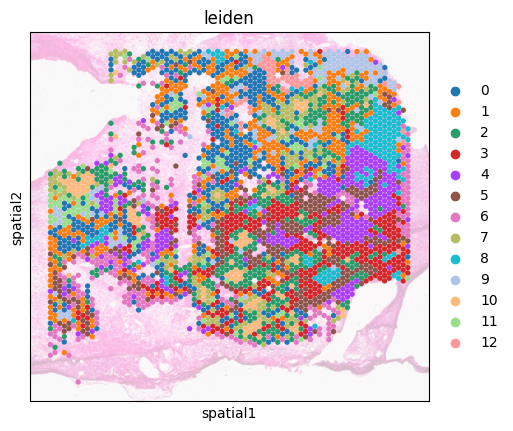

In [56]:
sc.pl.spatial(txt_ad,color='leiden',alpha_img=0.3,spot_size=400)

In [57]:
img_ad = anndata.AnnData(image_features[ad.obs.index].T)

/condo/wanglab/hmaiwxc/anaconda3/envs/clip/lib/python3.9/site-packages/anndata/_core/aligned_df.py:67: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


In [58]:
img_ad.uns['spatial']=ad.uns['spatial'].copy()
img_ad.obsm['spatial']=ad.obsm['spatial'].copy()

In [59]:
sc.pp.pca(img_ad)
sc.pp.neighbors(img_ad)

In [60]:
sc.tl.leiden(img_ad)

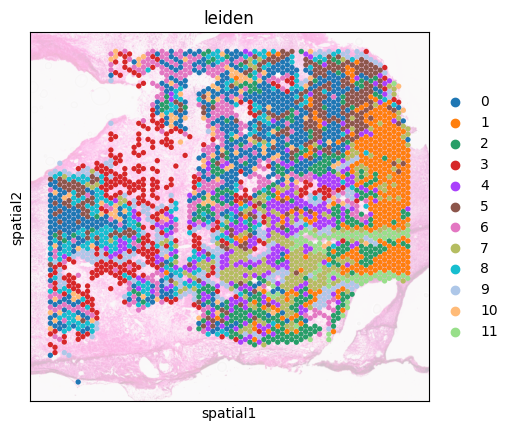

In [61]:
sc.pl.spatial(img_ad,color='leiden',alpha_img=0.3,spot_size=400)

## Generate df for finetune

In [20]:
training_df = pd.read_csv(data_path+str(sample_name)+'_training_df.csv',index_col=0)
training_df

,label,img_path
TNBC_processed_adata_AACACGTGCATCGCAC-1,ECRG4 LMAN2 MGAT4B MDFI EHF CRYAB CHMP2A CLSTN...,/condo/wanglab/shared/wxc/clip/data/human/HM_d...
TNBC_processed_adata_AACACTTGGCAAGGAA-1,CITED4 S100A1 MFGE8 COL2A1 IER2 NUCB1 SOX4 APP...,/condo/wanglab/shared/wxc/clip/data/human/HM_d...
TNBC_processed_adata_AACAGGAAGAGCATAG-1,GAK CDK11B MED8 POLR3C BOLA1 S100A1 ARHGEF2 RN...,/condo/wanglab/shared/wxc/clip/data/human/HM_d...
TNBC_processed_adata_AACAGGATTCATAGTT-1,CITED4 KRT14 KRT15 S100A1 PTMS MSLN S100A6 LMN...,/condo/wanglab/shared/wxc/clip/data/human/HM_d...
TNBC_processed_adata_AACAGGCCAACGATTA-1,ECRG4 CITED4 SCGB3A1 KRT19 S100A1 CHPF ITM2C C...,/condo/wanglab/shared/wxc/clip/data/human/HM_d...
...,...,...
TNBC_processed_adata_TGTTGGAACCTTCCGC-1,S100A1 KRT15 ECRG4 SYT8 COL9A3 COL11A2 COL2A1 ...,/condo/wanglab/shared/wxc/clip/data/human/HM_d...
TNBC_processed_adata_TGTTGGAACGAGGTCA-1,KRT15 S100A1 ECRG4 SCGB3A1 SYT8 CITED4 MSLN KR...,/condo/wanglab/shared/wxc/clip/data/human/HM_d...
TNBC_processed_adata_TGTTGGAAGCTCGGTA-1,MFGE8 CRABP2 PTMS LMNA CRABP1 TRIM29 DDR1 MIA ...,/condo/wanglab/shared/wxc/clip/data/human/HM_d...
TNBC_processed_adata_TGTTGGATGGACTTCT-1,KRT15 S100A1 BGN COL2A1 EPHB3 CITED4 MSLN SOX4...,/condo/wanglab/shared/wxc/clip/data/human/HM_d...


In [9]:
ad = sc.read_h5ad(data_path+sample_name+'_filter100g.h5ad')

In [10]:
ad

AnnData object with n_obs × n_vars = 3104 × 16300
    obs: 'in_tissue', 'array_row', 'array_col', 'pixel_y', 'pixel_x', 'cell_num', 'n_genes'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells'
    uns: 'log1p', 'spatial'
    obsm: 'spatial'
    layers: 'counts'

In [14]:
sc.pp.pca(ad)
sc.pp.neighbors(ad)

In [15]:
sc.tl.umap(ad)

In [16]:
sc.tl.leiden(ad, resolution=0.247)

/condo/wanglab/hmaiwxc/anaconda3/envs/clip/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


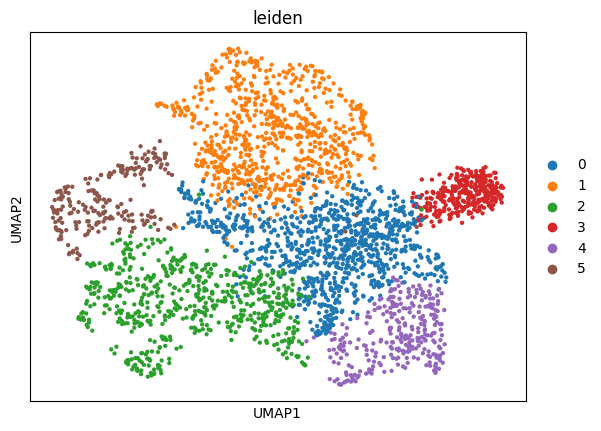

In [17]:
sc.pl.umap(ad, color='leiden')

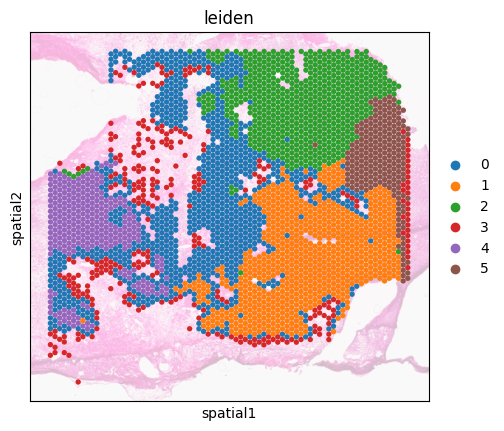

In [18]:
sc.pl.spatial(ad, color='leiden',alpha_img=0.3,spot_size=400)

In [19]:
row_num = ad.obs['array_row'].max()-ad.obs['array_row'].min()
col_num = ad.obs['array_col'].max()-ad.obs['array_col'].min()

In [24]:
cut_case = '_filter100g_rb'

In [22]:
ad_sub = ad[(ad.obs['array_col']<(col_num/2))&(ad.obs['array_row']<(row_num/2)),:]

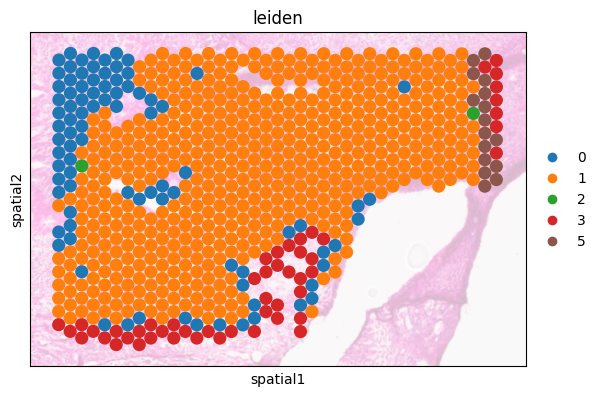

In [23]:
sc.pl.spatial(ad_sub, color='leiden',alpha_img=0.3,spot_size=400)

In [25]:
training_df.loc[ad_sub.obs.index].to_csv(data_path+str(sample_name)+'_training_df'+str(cut_case)+'.csv')

## After Finetune all

In [54]:
case_name = '_finetune10'

In [55]:
ad = sc.read_h5ad(data_path+sample_name+'_filter200g.h5ad')

In [56]:
ad

AnnData object with n_obs × n_vars = 3280 × 14263
    obs: 'in_tissue', 'array_row', 'array_col', 'pixel_y', 'pixel_x', 'cell_num', 'n_genes', 'leiden'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells'
    uns: 'leiden', 'leiden_colors', 'log1p', 'neighbors', 'pca', 'spatial'
    obsm: 'X_pca', 'spatial'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'connectivities', 'distances'

### Generate Finetune Features

In [57]:
tokenizer = get_tokenizer('coca_ViT-L-14')
model_dir = "2024_08_09-21_16_21-model_coca_ViT-L-14-lr_5e-06-b_64-j_8-p_amp"
epoch_n = "epoch_10.pt"
model_path = os.path.join("/condo/wanglab/shared/wxc/clip/models/open_clip-main/logs", model_dir, "checkpoints", epoch_n)
model, preprocess = create_model_from_pretrained("coca_ViT-L-14", device = DEVICE, pretrained=model_path)

In [ ]:
generate_features(ad, case_name)

### QC

In [59]:
image_feature_path = os.path.join(data_path, sample_name+'_img_features'+case_name+'.csv')
image_features = pd.read_csv(image_feature_path, index_col=0)[ad.obs.index]

In [60]:
text_feature_path = os.path.join(data_path, sample_name+'_txt_features'+case_name+'.csv')
text_features = pd.read_csv(text_feature_path, index_col=0)[ad.obs.index]

In [61]:
comb_features = pd.concat([image_features,text_features],axis=1)

In [62]:
pca_comb_features = pca.fit_transform(comb_features.T)

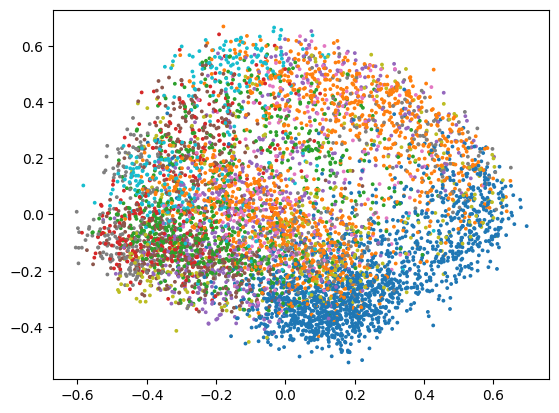

In [63]:
plt.scatter(pca_comb_features[:,0], pca_comb_features[:,1],c=pd.concat([ad.obs['leiden'].astype('category').cat.codes,ad.obs['leiden'].astype('category').cat.codes]), s=3,cmap='tab10')

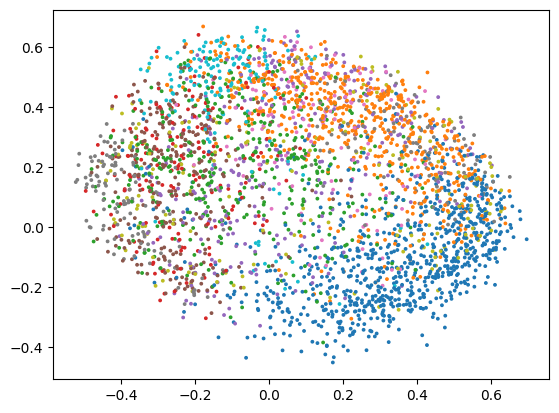

In [64]:
plt.scatter(pca_comb_features[:len(image_features.T),0], pca_comb_features[:len(image_features.T),1],c=ad.obs['leiden'].astype('category').cat.codes, s=3,cmap='tab10')

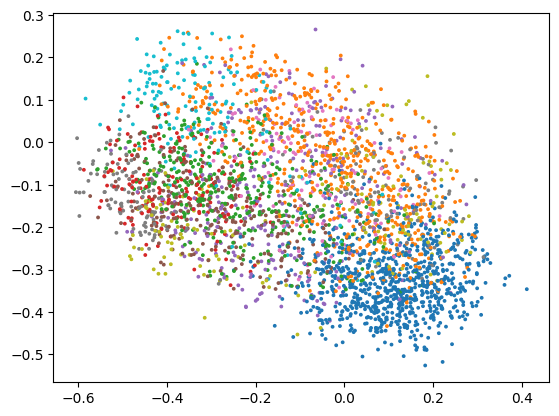

In [65]:
plt.scatter(pca_comb_features[len(image_features.T):,0], pca_comb_features[len(image_features.T):,1],c=ad.obs['leiden'].astype('category').cat.codes, s=3,cmap='tab10')

In [66]:
pca_rgb_comb = (pca_comb_features-pca_comb_features.min(axis=0))/(pca_comb_features.max(axis=0)-pca_comb_features.min(axis=0))
pca_hex_comb = [ rgb2hex(pca_rgb_comb[i,:]) for i in range(pca_rgb_comb.shape[0]) ]

In [67]:
len(pca_hex_comb)

6560

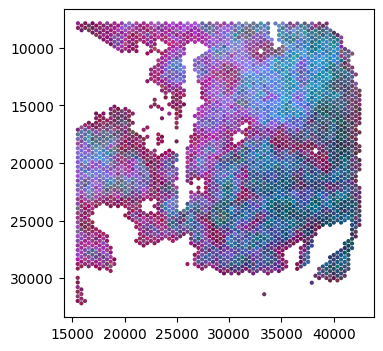

In [68]:
plt.figure(figsize=(4,4))
plt.scatter(ad.obsm['spatial'][:,0], ad.obsm['spatial'][:,1], marker='o', s=4, c=pca_hex_comb[len(image_features.T):])
plt.gca().invert_yaxis()

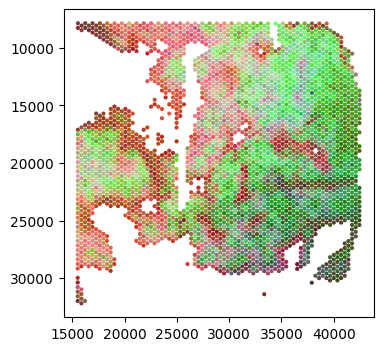

In [69]:
plt.figure(figsize=(4,4))
plt.scatter(ad.obsm['spatial'][:,0], ad.obsm['spatial'][:,1], marker='o', s=4, c=pca_hex_comb[:len(image_features.T)])
plt.gca().invert_yaxis()

In [70]:
dot_simi = np.dot(np.array(image_features[ad.obs.sort_values('leiden').index]).T, np.array(text_features[ad.obs.sort_values('leiden').index]))

<Axes: >

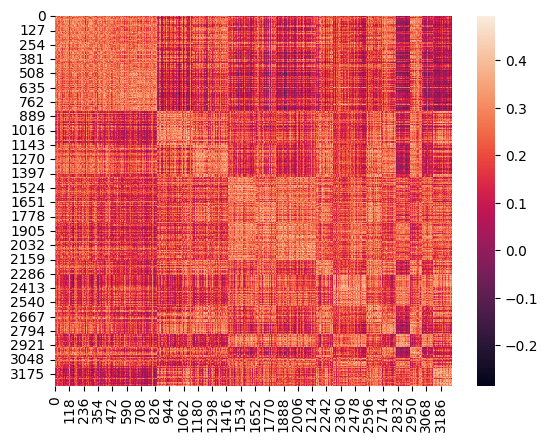

In [71]:
sns.heatmap(dot_simi)

In [72]:
txt_ad = anndata.AnnData(text_features.T)

In [73]:
txt_ad.uns['spatial']=ad.uns['spatial'].copy()
txt_ad.obsm['spatial']=ad.obsm['spatial'].copy()

In [74]:
txt_ad

AnnData object with n_obs × n_vars = 3280 × 768
    uns: 'spatial'
    obsm: 'spatial'

In [75]:
sc.pp.pca(txt_ad)
sc.pp.neighbors(txt_ad)

In [76]:
sc.tl.leiden(txt_ad)
# sc.tl.leiden(txt_ad,resolution=0.6)

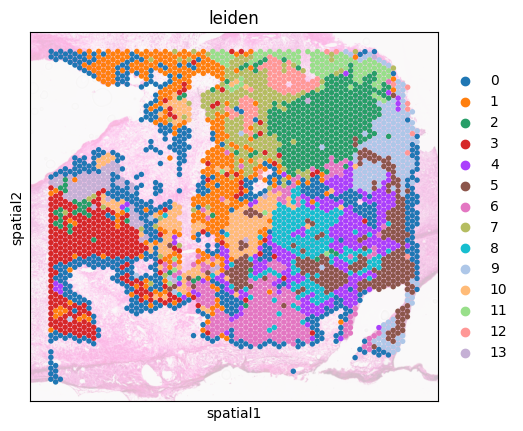

In [77]:
sc.pl.spatial(txt_ad,color='leiden',alpha_img=0.3,spot_size=400)

In [49]:
img_ad = anndata.AnnData(image_features[ad.obs.index].T)

In [50]:
img_ad.uns['spatial']=ad.uns['spatial'].copy()
img_ad.obsm['spatial']=ad.obsm['spatial'].copy()

In [51]:
sc.pp.pca(img_ad)
sc.pp.neighbors(img_ad)

In [52]:
sc.tl.leiden(img_ad)

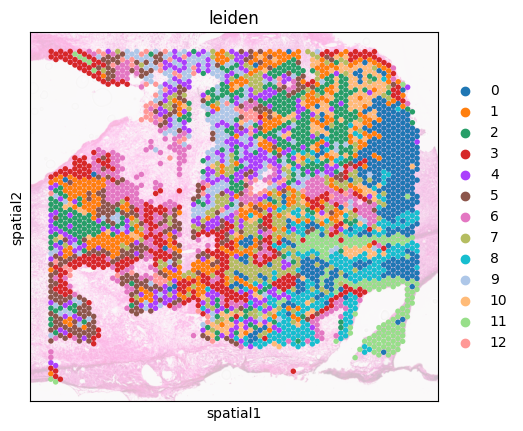

In [53]:
sc.pl.spatial(img_ad,color='leiden',alpha_img=0.3,spot_size=400)

## After Finetune rb

In [26]:
case_name = '_finetune10_filter100g_rb'

In [27]:
ad = sc.read_h5ad(data_path+sample_name+'.h5ad')
ad

AnnData object with n_obs × n_vars = 4168 × 18085
    obs: 'in_tissue', 'array_row', 'array_col', 'pixel_y', 'pixel_x', 'cell_num'
    var: 'gene_ids', 'feature_types', 'genome'
    uns: 'spatial'
    obsm: 'spatial'

### Generate Finetune Features

In [33]:
model_dir = "2024_08_13-11_53_50-model_coca_ViT-L-14-lr_5e-06-b_64-j_8-p_amp"
epoch_n = "epoch_10.pt"

In [28]:
tokenizer = get_tokenizer('coca_ViT-L-14')
model_path = os.path.join("/condo/wanglab/shared/wxc/clip/models/open_clip-main/logs", model_dir, "checkpoints", epoch_n)
model, preprocess = create_model_from_pretrained("coca_ViT-L-14", device = DEVICE, pretrained=model_path)

INFO:root:Loaded coca_ViT-L-14 model config.
INFO:root:Loading pretrained coca_ViT-L-14 weights (/condo/wanglab/shared/wxc/clip/models/open_clip-main/logs/2024_08_13-11_53_50-model_coca_ViT-L-14-lr_5e-06-b_64-j_8-p_amp/checkpoints/epoch_10.pt).


In [34]:
generate_features(ad, case_name)

100%|██████████| 4168/4168 [02:03<00:00, 33.66it/s]


### QC

In [131]:
image_feature_path = os.path.join(data_path, sample_name+'_img_features'+case_name+'.csv')
image_features = pd.read_csv(image_feature_path, index_col=0)[ad.obs.index]

In [132]:
text_feature_path = os.path.join(data_path, sample_name+'_txt_features'+case_name+'.csv')
text_features = pd.read_csv(text_feature_path, index_col=0)[ad.obs.index]

In [41]:
dot_simi = np.dot(np.array(image_features[ad.obs.sort_values('leiden').index]).T, np.array(text_features[ad.obs.sort_values('leiden').index]))

<Axes: >

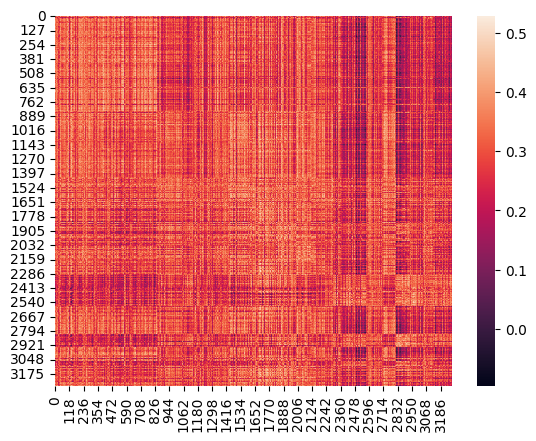

In [42]:
sns.heatmap(dot_simi)

In [133]:
pca_txt_fit = pca.fit(text_features.T)

In [134]:
pca_txt = pca_txt_fit.transform(text_features.T)

In [135]:
pca_img = pca_txt_fit.transform(image_features.T)

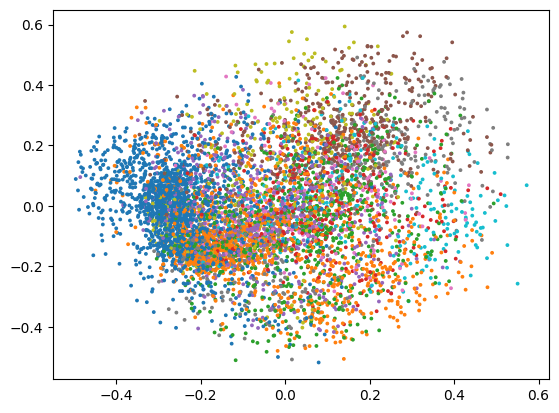

In [136]:
plt.scatter(pca_img[:,0], pca_img[:,1],c=ad.obs['leiden'].astype('category').cat.codes, s=3,cmap='tab10')
plt.scatter(pca_txt[:,0], pca_txt[:,1],c=ad.obs['leiden'].astype('category').cat.codes, s=3,cmap='tab10')

In [43]:
txt_ad = anndata.AnnData(text_features.T)

In [44]:
txt_ad.uns['spatial']=ad.uns['spatial'].copy()
txt_ad.obsm['spatial']=ad.obsm['spatial'].copy()

In [45]:
txt_ad

AnnData object with n_obs × n_vars = 3280 × 768
    uns: 'spatial'
    obsm: 'spatial'

In [46]:
sc.pp.pca(txt_ad)
sc.pp.neighbors(txt_ad)

In [47]:
sc.tl.leiden(txt_ad)
# sc.tl.leiden(txt_ad,resolution=0.6)

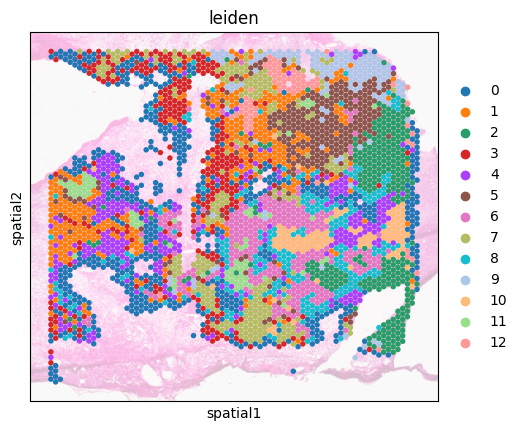

In [48]:
sc.pl.spatial(txt_ad,color='leiden',alpha_img=0.3,spot_size=400)

In [49]:
img_ad = anndata.AnnData(image_features[ad.obs.index].T)

In [50]:
img_ad.uns['spatial']=ad.uns['spatial'].copy()
img_ad.obsm['spatial']=ad.obsm['spatial'].copy()

In [51]:
sc.pp.pca(img_ad)
sc.pp.neighbors(img_ad)

In [52]:
sc.tl.leiden(img_ad)

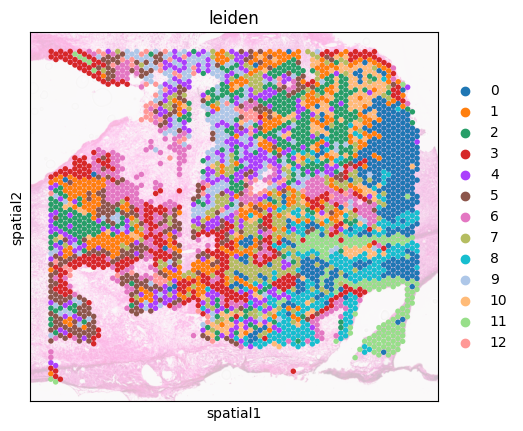

In [53]:
sc.pl.spatial(img_ad,color='leiden',alpha_img=0.3,spot_size=400)

#### Cut (old)

In [195]:
tokenizer = get_tokenizer('coca_ViT-L-14')
model_dir = "2024_08_09-21_33_33-model_coca_ViT-L-14-lr_5e-06-b_64-j_8-p_amp"
epoch_n = "epoch_10.pt"
model_path = os.path.join("/condo/wanglab/shared/wxc/clip/models/open_clip-main/logs", model_dir, "checkpoints", epoch_n)
model, preprocess = create_model_from_pretrained("coca_ViT-L-14", device = DEVICE, pretrained=model_path)

In [284]:
case_name = '_cut_finetune10'

In [285]:
ad = sc.read_h5ad(data_path+sample_name+'_cut.h5ad')

In [286]:
# generate_finetune_text_features(ad, case_name)

In [287]:
image_feature_path = os.path.join(data_path, sample_name+'_img_features'+case_name+'.csv')
image_features = pd.read_csv(image_feature_path, index_col=0)

In [288]:
text_feature_path = os.path.join(data_path, sample_name+'_txt_features'+case_name+'.csv')
text_features = pd.read_csv(text_feature_path, index_col=0)

In [205]:
umap_image_features = fit.fit_transform(image_features.T)
umap_text_features = fit.fit_transform(text_features.T)

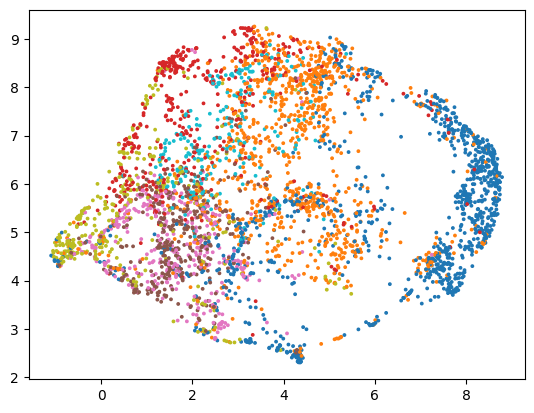

In [206]:
plt.scatter(umap_image_features[:,0],umap_image_features[:,1],c=ad.obs['leiden'].astype('category').cat.codes, s=3,cmap='tab10')

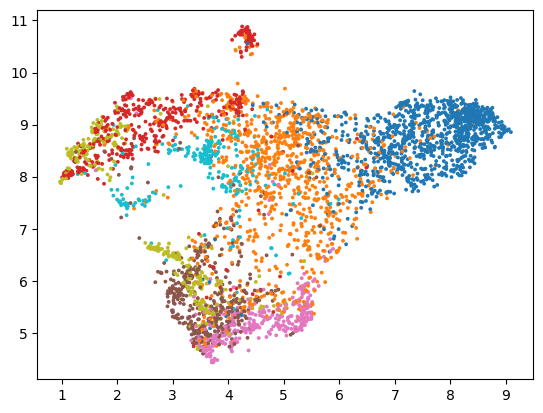

In [207]:
plt.scatter(umap_text_features[:,0],umap_text_features[:,1],c=ad.obs['leiden'].astype('category').cat.codes, s=3,cmap='tab10')

In [208]:
dot_simi = np.dot(np.array(image_features[ad.obs.sort_values('leiden').index]).T, np.array(text_features[ad.obs.sort_values('leiden').index]))

<Axes: >

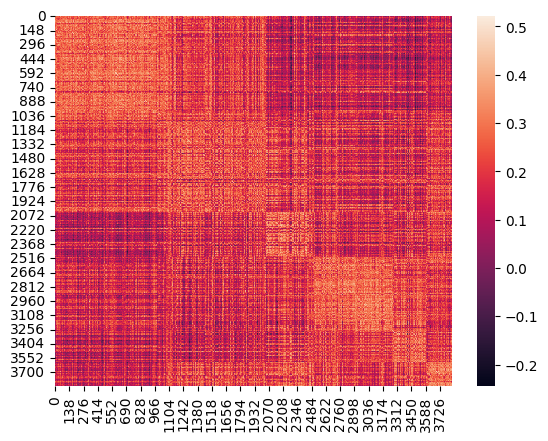

In [209]:
sns.heatmap(dot_simi)

In [210]:
umap_rgb_image = (umap_image_features-umap_image_features.min(axis=0))/(umap_image_features.max(axis=0)-umap_image_features.min(axis=0))
umap_hex_image = [ rgb2hex(umap_rgb_image[i,:]) for i in range(umap_rgb_image.shape[0]) ]

In [211]:
umap_rgb_text = (umap_text_features-umap_text_features.min(axis=0))/(umap_text_features.max(axis=0)-umap_text_features.min(axis=0))
umap_hex_text = [ rgb2hex(umap_rgb_text[i,:]) for i in range(umap_rgb_text.shape[0]) ]

(45000.0, 0.0)

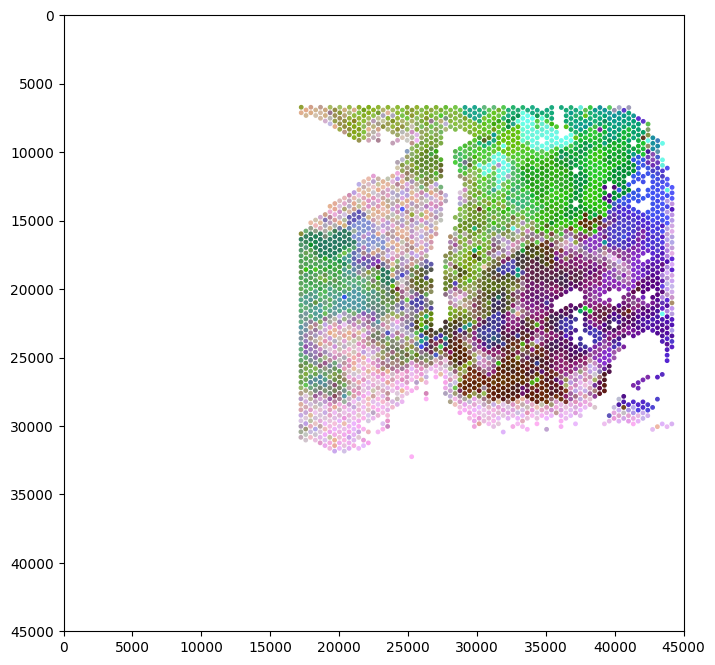

In [212]:
plt.figure(figsize=(8,8))
plt.scatter(ad.obsm['spatial'][:,0], ad.obsm['spatial'][:,1], marker='o', s=6, c=umap_hex_text)
plt.gca().invert_yaxis()
plt.xlim((0,45000))
plt.ylim((45000,0))

(45000.0, 0.0)

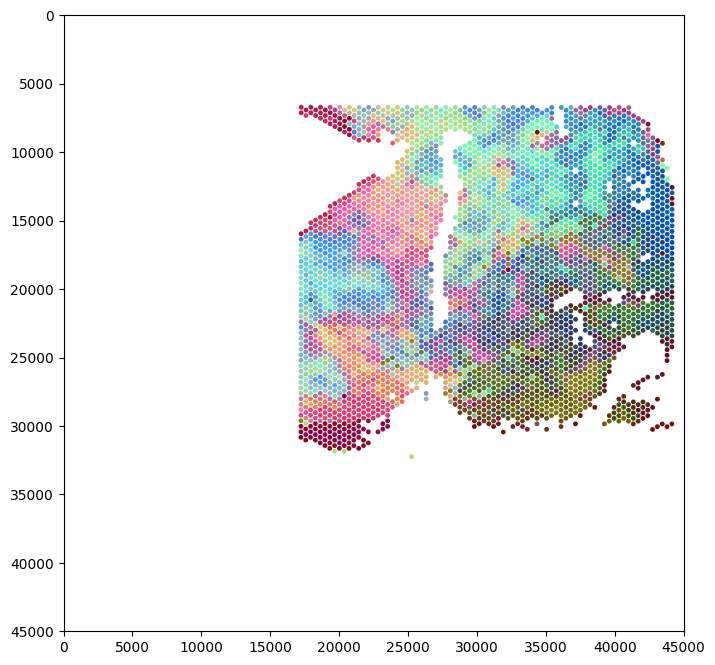

In [213]:
plt.figure(figsize=(8,8))
plt.scatter(ad.obsm['spatial'][:,0], ad.obsm['spatial'][:,1], marker='o', s=6, c=umap_hex_image)
plt.gca().invert_yaxis()
plt.xlim((0,45000))
plt.ylim((45000,0))

In [290]:
txt_ad = anndata.AnnData(text_features.T)

In [291]:
txt_ad.uns['spatial']=ad.uns['spatial'].copy()
txt_ad.obsm['spatial']=ad.obsm['spatial'].copy()

In [292]:
txt_ad

AnnData object with n_obs × n_vars = 3842 × 768
    uns: 'spatial'
    obsm: 'spatial'

In [293]:
sc.pp.pca(txt_ad)
sc.pp.neighbors(txt_ad)

In [294]:
sc.tl.leiden(txt_ad,resolution=0.47)

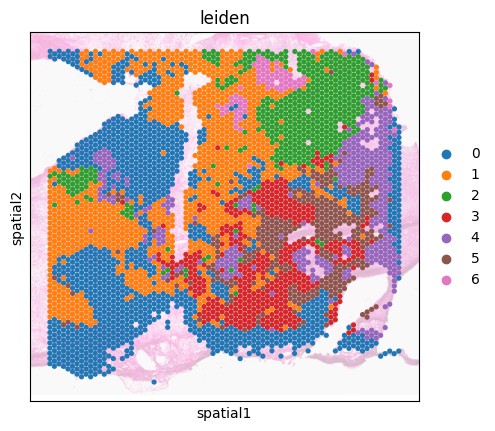

In [295]:
sc.pl.spatial(txt_ad,color='leiden',alpha_img=0.3,spot_size=400)

## Read scRNA data

In [106]:
sc_data_path = '/condo/wanglab/shared/DATA_ARCHIVE/data/2.scRNA_data/TNBC_SC/processed_data/TNBC_SC.h5ad'

In [107]:
sc_data = sc.read_h5ad(sc_data_path)

In [108]:
sc_data

AnnData object with n_obs × n_vars = 1112 × 21785
    obs: 'cell_type'

In [109]:
sc_data.obs

,cell_type
PT089_P1_A01,epithelial
PT089_P1_A02,epithelial
PT089_P1_A03,epithelial
PT089_P1_A04,macrophage
PT089_P1_A05,macrophage
...,...
PT039_P10_H07_S283,epithelial
PT039_P10_H08_S284,macrophage
PT039_P10_H09_S285,epithelial
PT039_P10_H11_S287,epithelial


#### sc Plot

In [ ]:
# sc.pp.filter_cells(sc_data, min_genes=100)
# sc.pp.filter_genes(sc_data, min_cells=3)

In [ ]:
# sc_data.layers["counts"] = sc_data.X.copy()
# sc.pp.normalize_total(sc_data)
# sc.pp.log1p(sc_data)

In [95]:
sc.tl.pca(sc_data)
sc.pp.neighbors(sc_data)
sc.tl.umap(sc_data)

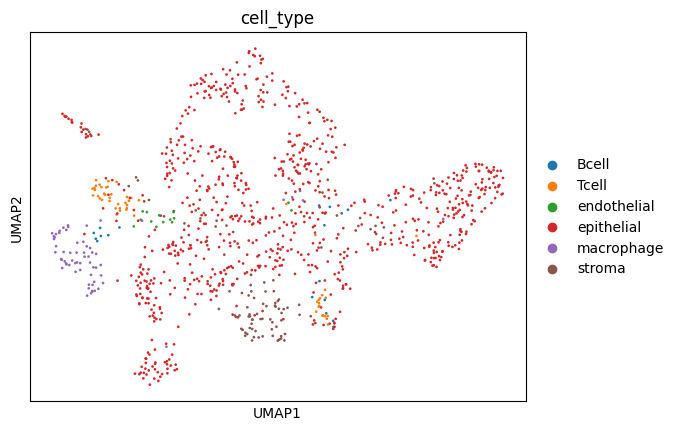

In [96]:
sc.pl.umap(sc_data,color='cell_type',size=15)

In [97]:
sc.tl.rank_genes_groups(sc_data, groupby="cell_type", use_raw=False)

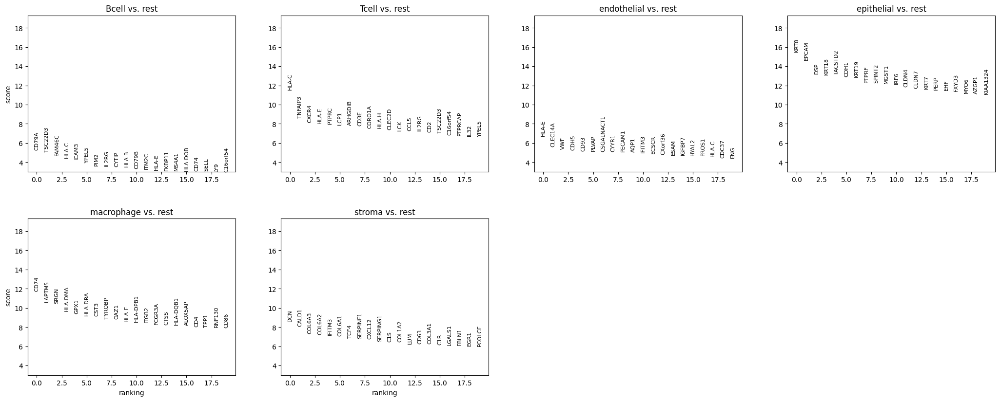

In [98]:
sc.pl.rank_genes_groups(sc_data)

## Generate feature of sc data

In [13]:
def generate_sc_feartures(ad, case_name):
    ad = ad[:,~ad.var.index.str.contains('.', regex=False)]
    ad = ad[:,~ad.var.index.str.contains('-', regex=False)]
    ad = ad[:,~ad.var.index.isin(house_keeping_genes['genesymbol'])]
    expr = pd.DataFrame(ad.X, index=ad.obs.index, columns=ad.var.index)
    top_k_genes = expr.apply(lambda s, n: pd.Series(s.nlargest(n).index), axis=1, n=k)
    top_k_genes_str = pd.DataFrame()
    top_k_genes_str['label'] = top_k_genes[top_k_genes.columns].astype(str).apply(lambda x: ' '.join(x), axis = 1)

    text_feature_path = os.path.join(data_path, sample_name+'_txt_features_sc'+case_name+'.csv')
    text_features = pd.DataFrame()

    warnings.simplefilter(action='ignore')
    for patch_idx in tqdm(ad.obs.index):
    
        text = top_k_genes_str[top_k_genes_str.index==patch_idx]['label'].values[0]
        text_input = tokenizer([text], context_length=76).to(DEVICE)
        with torch.no_grad():
            text_features[patch_idx] = model.encode_text(text_input).cpu().detach().numpy()[0]
            
    text_features.to_csv(text_feature_path)

In [14]:
sc_data = sc.read_h5ad(sc_data_path)
sc_data

AnnData object with n_obs × n_vars = 1112 × 21785
    obs: 'cell_type'

In [ ]:
# case_name = '_training20'
# model_dir = "2024_03_25-19_46_42-model_coca_ViT-L-14-lr_5e-06-b_64-j_8-p_amp"
# epoch_n = "epoch_20.pt"

In [16]:
# case_name = '_fintune10'
# model_dir = "2024_08_09-21_16_21-model_coca_ViT-L-14-lr_5e-06-b_64-j_8-p_amp"
# epoch_n = "epoch_10.pt"

In [17]:
case_name = '_finetune10_filter100g_rb'
model_dir = "2024_08_13-11_53_50-model_coca_ViT-L-14-lr_5e-06-b_64-j_8-p_amp"
epoch_n = "epoch_10.pt"

In [18]:
tokenizer = get_tokenizer('coca_ViT-L-14')
model_path = os.path.join("/condo/wanglab/shared/wxc/clip/models/open_clip-main/logs", model_dir, "checkpoints", epoch_n)
model, preprocess = create_model_from_pretrained("coca_ViT-L-14", device = DEVICE, pretrained=model_path)

In [19]:
generate_sc_feartures(sc_data, case_name)

100%|██████████| 1112/1112 [00:07<00:00, 144.45it/s]


# Deconv

In [10]:
import tangram as tg

In [11]:
sc_data_path = '/condo/wanglab/shared/DATA_ARCHIVE/data/2.scRNA_data/TNBC_SC/processed_data/TNBC_SC.h5ad'

In [12]:
# ad_expr = sc.read_h5ad(data_path+sample_name+'_filter200g.h5ad')
ad_expr = sc.read_h5ad(data_path+sample_name+'_filter100g.h5ad')
ad_expr

AnnData object with n_obs × n_vars = 3104 × 16300
    obs: 'in_tissue', 'array_row', 'array_col', 'pixel_y', 'pixel_x', 'cell_num', 'n_genes'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells'
    uns: 'log1p', 'spatial'
    obsm: 'spatial'
    layers: 'counts'

In [13]:
density_prior=np.array(ad_expr.obs['cell_num']) / ad_expr.obs['cell_num'].sum()

## Use Raw data

In [15]:
sc_data = sc.read_h5ad(sc_data_path)
sc_data

AnnData object with n_obs × n_vars = 1112 × 21785
    obs: 'cell_type'

In [16]:
sc_data = sc_data[sc_data.obs['cell_type']!='endothelial']
sc_data

View of AnnData object with n_obs × n_vars = 1098 × 21785
    obs: 'cell_type'

In [17]:
sc_data.X

ArrayView([[  0.,   0.,   0., ...,   0.,   0.,   0.],
           [  0.,   0.,   0., ...,   0.,   0.,   0.],
           [  0.,   0.,   0., ...,   1.,   0.,   0.],
           ...,
           [  0.,   0.,   0., ..., 143.,   6.,   0.],
           [  0.,   0.,   0., ...,   0.,   0.,   0.],
           [  2.,   0.,   0., ...,  85.,  27.,  23.]], dtype=float32)

In [18]:
sc.pp.filter_cells(sc_data, min_genes=100)
sc.pp.filter_genes(sc_data, min_cells=3)

In [29]:
sc_data.obs['cell_type'].value_counts()

cell_type
epithelial    832
stroma         94
macrophage     64
Tcell          53
Bcell          19
Name: count, dtype: int64

In [19]:
ad_expr = sc.read_h5ad(data_path+sample_name+'_filter100g.h5ad')
ad_expr

AnnData object with n_obs × n_vars = 3104 × 16300
    obs: 'in_tissue', 'array_row', 'array_col', 'pixel_y', 'pixel_x', 'cell_num', 'n_genes'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells'
    uns: 'log1p', 'spatial'
    obsm: 'spatial'
    layers: 'counts'

In [20]:
ad_expr.X = ad_expr.layers['counts']

In [24]:
sc.tl.rank_genes_groups(sc_data, groupby="cell_type", use_raw=False)
markers_df = pd.DataFrame(sc_data.uns["rank_genes_groups"]["names"]).iloc[0:100, :]
genes_sc = np.unique(markers_df.melt().value.values)
genes_st = ad_expr.var_names.values
genes = list(set(genes_sc).intersection(set(genes_st)))
len(genes)

403

### Use shared genes

In [25]:
tg.pp_adatas(sc_data, ad_expr, genes=genes)

INFO:root:403 training genes are saved in `uns``training_genes` of both single cell and spatial Anndatas.
INFO:root:14091 overlapped genes are saved in `uns``overlap_genes` of both single cell and spatial Anndatas.
INFO:root:uniform based density prior is calculated and saved in `obs``uniform_density` of the spatial Anndata.
INFO:root:rna count based density prior is calculated and saved in `obs``rna_count_based_density` of the spatial Anndata.


#### Clusters mode

In [26]:
ad_map = tg.map_cells_to_space(sc_data, ad_expr, 
    mode="clusters",
    cluster_label='cell_type',
    # device='cuda', 
    device='cpu',
    scale=False,
    target_count=ad_expr.obs['cell_num'].sum(),
    density_prior=torch.from_numpy(density_prior),
)

INFO:root:Allocate tensors for mapping.
INFO:root:Begin training with 403 genes and tensor([1.9623e-05, 2.3547e-04, 4.7095e-04,  ..., 5.6906e-04, 1.7661e-04,
        9.8114e-05], dtype=torch.float64) density_prior in clusters mode...
INFO:root:Printing scores every 100 epochs.


Score: 0.231, KL reg: 0.483
Score: 0.495, KL reg: 0.009
Score: 0.496, KL reg: 0.009
Score: 0.496, KL reg: 0.009
Score: 0.496, KL reg: 0.009
Score: 0.496, KL reg: 0.009
Score: 0.496, KL reg: 0.009
Score: 0.496, KL reg: 0.009
Score: 0.496, KL reg: 0.009
Score: 0.496, KL reg: 0.009


INFO:root:Saving results..


In [27]:
tg.project_cell_annotations(ad_map, ad_expr, annotation='cell_type')

INFO:root:spatial prediction dataframe is saved in `obsm` `tangram_ct_pred` of the spatial AnnData.


In [30]:
for cell_type in ad_expr.obsm['tangram_ct_pred'].columns:
    ad_expr.obsm['tangram_ct_pred'][cell_type]=ad_expr.obsm['tangram_ct_pred'][cell_type]*sc_data.obs['cell_type'].value_counts()[cell_type]

In [34]:
ad_expr.obsm['tangram_ct_pred'] = ad_expr.obsm['tangram_ct_pred'][['epithelial', 'macrophage', 'Bcell', 'Tcell', 'stroma']]
expr_deconv = ad_expr.obsm['tangram_ct_pred'].T/ad_expr.obsm['tangram_ct_pred'].T.sum()
expr_deconv

,TNBC_processed_adata_AACACGTGCATCGCAC-1,TNBC_processed_adata_AACACTTGGCAAGGAA-1,TNBC_processed_adata_AACAGGATTCATAGTT-1,TNBC_processed_adata_AACAGGTTATTGCACC-1,TNBC_processed_adata_AACAGGTTCACCGAAG-1,TNBC_processed_adata_AACAGTCGTGTCGCGG-1,TNBC_processed_adata_AACATATTCTTGCGAA-1,TNBC_processed_adata_AACATCGCGTGACCAC-1,TNBC_processed_adata_AACATCTAATGACCGG-1,TNBC_processed_adata_AACATGACTTGGCTGC-1,...,TNBC_processed_adata_TGTTCACTCACGGTAA-1,TNBC_processed_adata_TGTTCAGAACGGTGTA-1,TNBC_processed_adata_TGTTCCTCACATTAAT-1,TNBC_processed_adata_TGTTCTGCTCTGTCGT-1,TNBC_processed_adata_TGTTGCGTCCAAGATT-1,TNBC_processed_adata_TGTTGGAACCTTCCGC-1,TNBC_processed_adata_TGTTGGAACGAGGTCA-1,TNBC_processed_adata_TGTTGGAAGCTCGGTA-1,TNBC_processed_adata_TGTTGGATGGACTTCT-1,TNBC_processed_adata_TGTTGGCCTACACGTG-1
epithelial,0.833185,0.944953,0.860616,0.900420,0.843107,0.929313,0.838969,0.832808,0.747612,0.774968,...,0.779732,0.721516,0.577115,0.872760,0.858417,0.873314,0.835343,0.958008,0.566256,0.766231
macrophage,0.013093,0.015035,0.017400,0.016392,0.034282,0.010330,0.042639,0.021075,0.071724,0.039530,...,0.084374,0.032223,0.073516,0.043825,0.017018,0.032060,0.059933,0.002144,0.126611,0.014636
Bcell,0.008183,0.011181,0.005046,0.002373,0.000096,0.000079,0.000123,0.000133,0.037776,0.000100,...,0.015732,0.006376,0.002710,0.000131,0.007474,0.027105,0.023643,0.002394,0.010770,0.042911
Tcell,0.116145,0.011924,0.087654,0.037368,0.061364,0.030527,0.049408,0.051317,0.062793,0.117968,...,0.022921,0.079323,0.144209,0.042893,0.040663,0.027579,0.027514,0.026879,0.068493,0.126178
stroma,0.029394,0.016906,0.029284,0.043447,0.061152,0.029751,0.068860,0.094667,0.080095,0.067434,...,0.097241,0.160563,0.202450,0.040391,0.076428,0.039942,0.053567,0.010575,0.227870,0.050043


In [35]:
data = np.array(expr_deconv.T)
coordinates = np.array([ad_expr.obsm['spatial'][:, 0], -ad_expr.obsm['spatial'][:, 1]]).T/ad_expr.obsm['spatial'].max()

100%|██████████| 3104/3104 [01:07<00:00, 45.87it/s]


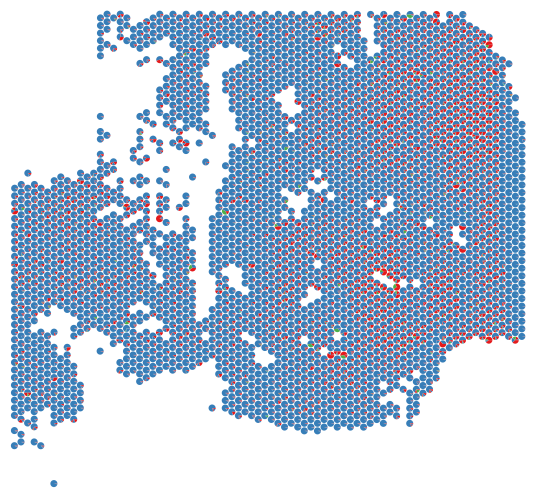

In [40]:
plt_pie_chart(data, coordinates)

#### constrained mode

In [42]:
ad_map = tg.map_cells_to_space(sc_data, ad_expr, 
    mode="constrained",
    cluster_label='cell_type',
    # device='cuda', 
    device='cpu',
    scale=False,
    target_count=ad_expr.obs['cell_num'].sum(),
    density_prior=torch.from_numpy(density_prior),
)

INFO:root:Allocate tensors for mapping.
INFO:root:Begin training with 403 genes and tensor([1.9623e-05, 2.3547e-04, 4.7095e-04,  ..., 5.6906e-04, 1.7661e-04,
        9.8114e-05], dtype=torch.float64) density_prior in constrained mode...


Score: 0.314, KL reg: 0.184, Count reg: 50435.609, Lambda f reg: 218.348
Score: 0.717, KL reg: 0.004, Count reg: 49906.117, Lambda f reg: 7.069
Score: 0.723, KL reg: 0.004, Count reg: 49901.812, Lambda f reg: 2.806
Score: 0.724, KL reg: 0.004, Count reg: 49900.586, Lambda f reg: 1.584
Score: 0.725, KL reg: 0.004, Count reg: 49900.043, Lambda f reg: 1.040
Score: 0.725, KL reg: 0.004, Count reg: 49899.746, Lambda f reg: 0.745
Score: 0.726, KL reg: 0.004, Count reg: 49899.562, Lambda f reg: 0.564
Score: 0.726, KL reg: 0.004, Count reg: 49899.445, Lambda f reg: 0.444
Score: 0.726, KL reg: 0.004, Count reg: 49899.359, Lambda f reg: 0.360
Score: 0.726, KL reg: 0.004, Count reg: 49899.297, Lambda f reg: 0.298


INFO:root:Saving results..


In [43]:
tg.project_cell_annotations(ad_map, ad_expr, annotation='cell_type')

INFO:root:spatial prediction dataframe is saved in `obsm` `tangram_ct_pred` of the spatial AnnData.


In [ ]:
ad_expr.obsm['tangram_ct_pred'] = ad_expr.obsm['tangram_ct_pred'][['epithelial', 'macrophage', 'Bcell', 'Tcell', 'stroma']]
expr_deconv = ad_expr.obsm['tangram_ct_pred'].T/ad_expr.obsm['tangram_ct_pred'].T.sum()
expr_deconv

In [46]:
data = np.array(expr_deconv.T)
coordinates = np.array([ad_expr.obsm['spatial'][:, 0], -ad_expr.obsm['spatial'][:, 1]]).T/ad_expr.obsm['spatial'].max()

In [ ]:
plt_pie_chart(data, coordinates)

100%|██████████| 3104/3104 [01:07<00:00, 45.79it/s]


### Use all genes

In [189]:
# tg.pp_adatas(sc_data, ad_expr, genes=genes)
tg.pp_adatas(sc_data, ad_expr, genes=None)

INFO:root:14091 training genes are saved in `uns``training_genes` of both single cell and spatial Anndatas.
INFO:root:14091 overlapped genes are saved in `uns``overlap_genes` of both single cell and spatial Anndatas.
INFO:root:uniform based density prior is calculated and saved in `obs``uniform_density` of the spatial Anndata.
INFO:root:rna count based density prior is calculated and saved in `obs``rna_count_based_density` of the spatial Anndata.


#### Clusters mode

In [190]:
ad_map = tg.map_cells_to_space(sc_data, ad_expr, 
    # mode="constrained",
    mode="clusters",
    cluster_label='cell_type',
    # device='cuda', 
    device='cpu',
    scale=False,
    # density_prior='uniform',
    target_count=ad_expr.obs['cell_num'].sum(),
    density_prior=torch.from_numpy(density_prior),
)

INFO:root:Allocate tensors for mapping.
INFO:root:Begin training with 14091 genes and tensor([1.9623e-05, 2.3547e-04, 4.7095e-04,  ..., 5.6906e-04, 1.7661e-04,
        9.8114e-05], dtype=torch.float64) density_prior in clusters mode...
INFO:root:Printing scores every 100 epochs.


Score: 0.256, KL reg: 0.456
Score: 0.507, KL reg: 0.003
Score: 0.507, KL reg: 0.003
Score: 0.507, KL reg: 0.003
Score: 0.507, KL reg: 0.003
Score: 0.507, KL reg: 0.003
Score: 0.507, KL reg: 0.003
Score: 0.507, KL reg: 0.003
Score: 0.507, KL reg: 0.003
Score: 0.507, KL reg: 0.003


INFO:root:Saving results..


In [191]:
tg.project_cell_annotations(ad_map, ad_expr, annotation='cell_type')

INFO:root:spatial prediction dataframe is saved in `obsm` `tangram_ct_pred` of the spatial AnnData.


In [192]:
sc_data.obs['cell_type'].value_counts()

cell_type
epithelial    832
stroma         94
macrophage     64
Tcell          53
Bcell          19
Name: count, dtype: int64

In [193]:
for cell_type in ad_expr.obsm['tangram_ct_pred'].columns:
    ad_expr.obsm['tangram_ct_pred'][cell_type]=ad_expr.obsm['tangram_ct_pred'][cell_type]*sc_data.obs['cell_type'].value_counts()[cell_type]

In [194]:
ad_expr.obsm['tangram_ct_pred'] = ad_expr.obsm['tangram_ct_pred'][['epithelial', 'macrophage', 'Bcell', 'Tcell', 'stroma']]

In [195]:
expr_deconv = ad_expr.obsm['tangram_ct_pred'].T/ad_expr.obsm['tangram_ct_pred'].T.sum()
expr_deconv

,TNBC_processed_adata_AACACGTGCATCGCAC-1,TNBC_processed_adata_AACACTTGGCAAGGAA-1,TNBC_processed_adata_AACAGGATTCATAGTT-1,TNBC_processed_adata_AACAGGTTATTGCACC-1,TNBC_processed_adata_AACAGGTTCACCGAAG-1,TNBC_processed_adata_AACAGTCGTGTCGCGG-1,TNBC_processed_adata_AACATATTCTTGCGAA-1,TNBC_processed_adata_AACATCGCGTGACCAC-1,TNBC_processed_adata_AACATCTAATGACCGG-1,TNBC_processed_adata_AACATGACTTGGCTGC-1,...,TNBC_processed_adata_TGTTCACTCACGGTAA-1,TNBC_processed_adata_TGTTCAGAACGGTGTA-1,TNBC_processed_adata_TGTTCCTCACATTAAT-1,TNBC_processed_adata_TGTTCTGCTCTGTCGT-1,TNBC_processed_adata_TGTTGCGTCCAAGATT-1,TNBC_processed_adata_TGTTGGAACCTTCCGC-1,TNBC_processed_adata_TGTTGGAACGAGGTCA-1,TNBC_processed_adata_TGTTGGAAGCTCGGTA-1,TNBC_processed_adata_TGTTGGATGGACTTCT-1,TNBC_processed_adata_TGTTGGCCTACACGTG-1
epithelial,0.842472,0.996403,0.926964,0.976036,0.808162,0.989134,0.861383,0.884344,0.714548,0.781801,...,0.666896,0.792480,0.621422,0.959453,0.949264,0.870539,0.812469,0.998377,0.425863,0.794739
macrophage,0.039589,0.000329,0.018006,0.004920,0.055882,0.000349,0.027317,0.015938,0.072263,0.050233,...,0.105299,0.053975,0.130037,0.007315,0.015234,0.038149,0.054818,0.000319,0.145164,0.051146
Bcell,0.016134,0.000033,0.005272,0.000494,0.010512,0.000480,0.008686,0.001705,0.017955,0.014165,...,0.025688,0.010954,0.003320,0.003056,0.004434,0.009693,0.013476,0.000069,0.039546,0.021106
Tcell,0.016889,0.000184,0.024145,0.011690,0.041966,0.007456,0.038348,0.023070,0.072730,0.049202,...,0.078113,0.044385,0.126916,0.017244,0.015550,0.029710,0.040775,0.000428,0.124281,0.054366
stroma,0.084917,0.003052,0.025613,0.006860,0.083478,0.002581,0.064267,0.074943,0.122504,0.104599,...,0.124004,0.098207,0.118304,0.012932,0.015518,0.051909,0.078463,0.000807,0.265145,0.078643


In [196]:
data = np.array(expr_deconv.T)
coordinates = np.array([ad_expr.obsm['spatial'][:, 0], -ad_expr.obsm['spatial'][:, 1]]).T/ad_expr.obsm['spatial'].max()

100%|██████████| 3104/3104 [01:09<00:00, 44.87it/s]


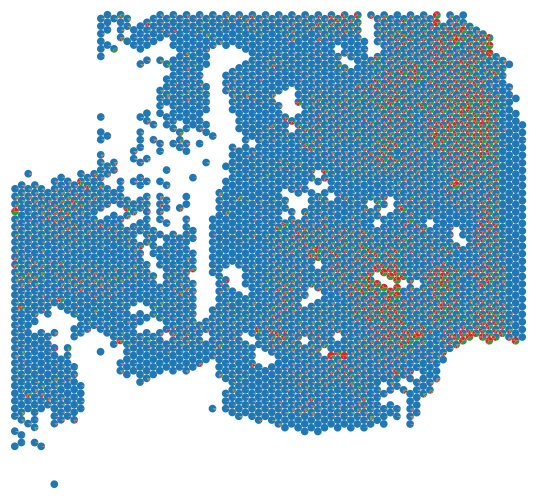

In [197]:
plt_pie_chart(data, coord)

#### constrained mode

In [198]:
ad_map = tg.map_cells_to_space(sc_data, ad_expr, 
    mode="constrained",
    # mode="clusters",
    cluster_label='cell_type',
    # device='cuda', 
    device='cpu',
    scale=False,
    # density_prior='uniform',
    target_count=ad_expr.obs['cell_num'].sum(),
    density_prior=torch.from_numpy(density_prior),
)

INFO:root:Allocate tensors for mapping.
INFO:root:Begin training with 14091 genes and tensor([1.9623e-05, 2.3547e-04, 4.7095e-04,  ..., 5.6906e-04, 1.7661e-04,
        9.8114e-05], dtype=torch.float64) density_prior in constrained mode...


Score: 0.311, KL reg: 0.183, Count reg: 50444.352, Lambda f reg: 219.404
Score: 0.570, KL reg: 0.004, Count reg: 49906.191, Lambda f reg: 7.139
Score: 0.572, KL reg: 0.003, Count reg: 49901.840, Lambda f reg: 2.832
Score: 0.573, KL reg: 0.003, Count reg: 49900.602, Lambda f reg: 1.598
Score: 0.573, KL reg: 0.003, Count reg: 49900.051, Lambda f reg: 1.050
Score: 0.574, KL reg: 0.003, Count reg: 49899.754, Lambda f reg: 0.752
Score: 0.574, KL reg: 0.003, Count reg: 49899.570, Lambda f reg: 0.569
Score: 0.574, KL reg: 0.003, Count reg: 49899.449, Lambda f reg: 0.448
Score: 0.574, KL reg: 0.003, Count reg: 49899.363, Lambda f reg: 0.363
Score: 0.574, KL reg: 0.003, Count reg: 49899.301, Lambda f reg: 0.301


INFO:root:Saving results..


In [199]:
tg.project_cell_annotations(ad_map, ad_expr, annotation='cell_type')

INFO:root:spatial prediction dataframe is saved in `obsm` `tangram_ct_pred` of the spatial AnnData.


In [200]:
ad_expr.obsm['tangram_ct_pred'] = ad_expr.obsm['tangram_ct_pred'][['epithelial', 'macrophage', 'Bcell', 'Tcell', 'stroma']]

In [201]:
expr_deconv = ad_expr.obsm['tangram_ct_pred'].T/ad_expr.obsm['tangram_ct_pred'].T.sum()
expr_deconv

,TNBC_processed_adata_AACACGTGCATCGCAC-1,TNBC_processed_adata_AACACTTGGCAAGGAA-1,TNBC_processed_adata_AACAGGATTCATAGTT-1,TNBC_processed_adata_AACAGGTTATTGCACC-1,TNBC_processed_adata_AACAGGTTCACCGAAG-1,TNBC_processed_adata_AACAGTCGTGTCGCGG-1,TNBC_processed_adata_AACATATTCTTGCGAA-1,TNBC_processed_adata_AACATCGCGTGACCAC-1,TNBC_processed_adata_AACATCTAATGACCGG-1,TNBC_processed_adata_AACATGACTTGGCTGC-1,...,TNBC_processed_adata_TGTTCACTCACGGTAA-1,TNBC_processed_adata_TGTTCAGAACGGTGTA-1,TNBC_processed_adata_TGTTCCTCACATTAAT-1,TNBC_processed_adata_TGTTCTGCTCTGTCGT-1,TNBC_processed_adata_TGTTGCGTCCAAGATT-1,TNBC_processed_adata_TGTTGGAACCTTCCGC-1,TNBC_processed_adata_TGTTGGAACGAGGTCA-1,TNBC_processed_adata_TGTTGGAAGCTCGGTA-1,TNBC_processed_adata_TGTTGGATGGACTTCT-1,TNBC_processed_adata_TGTTGGCCTACACGTG-1
epithelial,0.630619,0.828448,0.842221,0.806810,0.742864,0.790670,0.794459,0.650531,0.686229,0.777933,...,0.744255,0.667616,0.601091,0.828381,0.814376,0.830332,0.771959,0.908805,0.763520,0.581885
macrophage,0.094085,0.038499,0.036495,0.053465,0.098418,0.047207,0.036648,0.039945,0.095177,0.046631,...,0.078244,0.122847,0.288521,0.032208,0.048151,0.046104,0.100706,0.018724,0.067691,0.126681
Bcell,0.035863,0.024365,0.006701,0.013715,0.004117,0.022466,0.013294,0.016013,0.008733,0.011913,...,0.024578,0.012993,0.006999,0.017670,0.016971,0.008698,0.014992,0.021244,0.008602,0.080179
Tcell,0.081336,0.031079,0.043946,0.048535,0.051476,0.055861,0.054940,0.063382,0.087767,0.079647,...,0.068689,0.054641,0.033495,0.043089,0.046752,0.039794,0.033829,0.019374,0.046776,0.079537
stroma,0.158097,0.077609,0.070637,0.077475,0.103124,0.083796,0.100659,0.230129,0.122094,0.083876,...,0.084234,0.141903,0.069894,0.078652,0.073750,0.075072,0.078514,0.031852,0.113411,0.131718


In [202]:
data = np.array(expr_deconv.T)
coordinates = np.array([ad_expr.obsm['spatial'][:, 0], -ad_expr.obsm['spatial'][:, 1]]).T/ad_expr.obsm['spatial'].max()

100%|██████████| 3104/3104 [01:13<00:00, 41.96it/s]


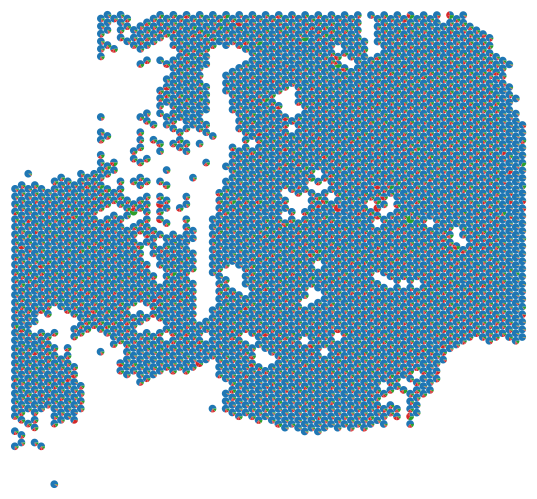

In [203]:
plt_pie_chart(data, coord)

## Use embedding

### After finetune all

In [119]:
case_name = '_finetune10'

In [116]:
sc_data = sc.read_h5ad(sc_data_path)
sc_data

AnnData object with n_obs × n_vars = 1112 × 21785
    obs: 'cell_type'

In [117]:
sc_text_feature_path = os.path.join(data_path, sample_name+'_txt_features_sc.csv')
sc_text_features = pd.read_csv(sc_text_feature_path, index_col=0)

In [118]:
sc_ad_emb = anndata.AnnData(sc_text_features.T)
sc_ad_emb.obs = sc_data.obs.copy()
sc_ad_emb

AnnData object with n_obs × n_vars = 1112 × 768
    obs: 'cell_type'

In [120]:
ad_expr = sc.read_h5ad(data_path+sample_name+'_filter200g.h5ad')
ad_expr

AnnData object with n_obs × n_vars = 3280 × 14263
    obs: 'in_tissue', 'array_row', 'array_col', 'pixel_y', 'pixel_x', 'cell_num', 'n_genes', 'leiden'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells'
    uns: 'leiden', 'leiden_colors', 'log1p', 'neighbors', 'pca', 'spatial'
    obsm: 'X_pca', 'spatial'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'connectivities', 'distances'

In [121]:
text_feature_path = os.path.join(data_path, sample_name+'_txt_features'+case_name+'.csv')
text_features = pd.read_csv(text_feature_path, index_col=0)

In [122]:
txt_ad = anndata.AnnData(text_features[ad_expr.obs.index].T)
txt_ad.uns['spatial']=ad_expr.uns['spatial'].copy()
txt_ad.obsm['spatial']=ad_expr.obsm['spatial'].copy()
txt_ad

AnnData object with n_obs × n_vars = 3280 × 768
    uns: 'spatial'
    obsm: 'spatial'

In [123]:
tg.pp_adatas(sc_ad_emb, txt_ad, genes=None)

INFO:root:764 training genes are saved in `uns``training_genes` of both single cell and spatial Anndatas.
INFO:root:764 overlapped genes are saved in `uns``overlap_genes` of both single cell and spatial Anndatas.
INFO:root:uniform based density prior is calculated and saved in `obs``uniform_density` of the spatial Anndata.
INFO:root:rna count based density prior is calculated and saved in `obs``rna_count_based_density` of the spatial Anndata.


In [124]:
txt_ad

AnnData object with n_obs × n_vars = 3280 × 766
    obs: 'uniform_density', 'rna_count_based_density'
    var: 'n_cells'
    uns: 'spatial', 'training_genes', 'overlap_genes'
    obsm: 'spatial'

In [125]:
sc_ad_emb

AnnData object with n_obs × n_vars = 1112 × 764
    obs: 'cell_type'
    var: 'n_cells'
    uns: 'training_genes', 'overlap_genes'

In [127]:
ad_map = tg.map_cells_to_space(sc_ad_emb, txt_ad, 
    mode="clusters",
    cluster_label='cell_type',
    device='cuda', 
    scale=False,
    # density_prior='uniform'
    density_prior=torch.from_numpy(density_prior),
)

INFO:root:Allocate tensors for mapping.
INFO:root:Begin training with 764 genes and tensor([1.9866e-05, 2.3839e-04, 4.7679e-04,  ..., 5.7612e-04, 1.7879e-04,
        9.9331e-05], dtype=torch.float64) density_prior in clusters mode...
INFO:root:Printing scores every 100 epochs.


Score: 0.045, KL reg: 0.535
Score: 0.116, KL reg: 0.005
Score: 0.118, KL reg: 0.004
Score: 0.119, KL reg: 0.004
Score: 0.120, KL reg: 0.004
Score: 0.120, KL reg: 0.004
Score: 0.120, KL reg: 0.004
Score: 0.120, KL reg: 0.004
Score: 0.120, KL reg: 0.004
Score: 0.120, KL reg: 0.004


INFO:root:Saving results..


In [128]:
tg.project_cell_annotations(ad_map, txt_ad, annotation='cell_type')

INFO:root:spatial prediction dataframe is saved in `obsm` `tangram_ct_pred` of the spatial AnnData.


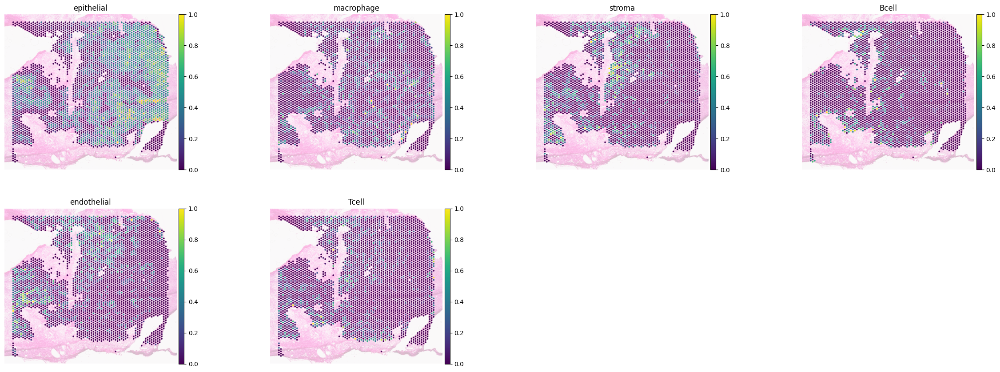

In [129]:
annotation_list = list(pd.unique(sc_ad_emb.obs['cell_type']))
tg.plot_cell_annotation_sc(txt_ad, annotation_list, x='x', y='y', perc=0.001, alpha_img=0.3)

In [132]:
sc_ad_emb = anndata.AnnData(sc_text_features.T)
sc_ad_emb.obs = sc_data.obs.copy()
sc_ad_emb

AnnData object with n_obs × n_vars = 1112 × 768
    obs: 'cell_type'

In [130]:
image_feature_path = os.path.join(data_path, sample_name+'_img_features'+case_name+'.csv')
image_features = pd.read_csv(image_feature_path, index_col=0)

In [131]:
img_ad = anndata.AnnData(image_features[ad.obs.index].T)
img_ad.uns['spatial']=ad.uns['spatial'].copy()
img_ad.obsm['spatial']=ad.obsm['spatial'].copy()
img_ad

AnnData object with n_obs × n_vars = 3280 × 768
    uns: 'spatial'
    obsm: 'spatial'

In [133]:
tg.pp_adatas(sc_ad_emb, img_ad, genes=None)

INFO:root:764 training genes are saved in `uns``training_genes` of both single cell and spatial Anndatas.
INFO:root:764 overlapped genes are saved in `uns``overlap_genes` of both single cell and spatial Anndatas.
INFO:root:uniform based density prior is calculated and saved in `obs``uniform_density` of the spatial Anndata.
INFO:root:rna count based density prior is calculated and saved in `obs``rna_count_based_density` of the spatial Anndata.


In [134]:
img_ad

AnnData object with n_obs × n_vars = 3280 × 766
    obs: 'uniform_density', 'rna_count_based_density'
    var: 'n_cells'
    uns: 'spatial', 'training_genes', 'overlap_genes'
    obsm: 'spatial'

In [135]:
sc_ad_emb

AnnData object with n_obs × n_vars = 1112 × 764
    obs: 'cell_type'
    var: 'n_cells'
    uns: 'training_genes', 'overlap_genes'

In [136]:
ad_map = tg.map_cells_to_space(sc_ad_emb, img_ad, 
    mode="clusters",
    cluster_label='cell_type',
    device='cuda', 
    scale=False,
    # density_prior='uniform'
    density_prior=torch.from_numpy(density_prior),
)

INFO:root:Allocate tensors for mapping.
INFO:root:Begin training with 764 genes and tensor([1.9866e-05, 2.3839e-04, 4.7679e-04,  ..., 5.7612e-04, 1.7879e-04,
        9.9331e-05], dtype=torch.float64) density_prior in clusters mode...
INFO:root:Printing scores every 100 epochs.


Score: 0.066, KL reg: 0.558
Score: 0.123, KL reg: 0.005
Score: 0.126, KL reg: 0.004
Score: 0.127, KL reg: 0.004
Score: 0.128, KL reg: 0.004
Score: 0.128, KL reg: 0.004
Score: 0.128, KL reg: 0.004
Score: 0.128, KL reg: 0.004
Score: 0.128, KL reg: 0.004
Score: 0.128, KL reg: 0.004


INFO:root:Saving results..


In [137]:
tg.project_cell_annotations(ad_map, img_ad, annotation='cell_type')

INFO:root:spatial prediction dataframe is saved in `obsm` `tangram_ct_pred` of the spatial AnnData.


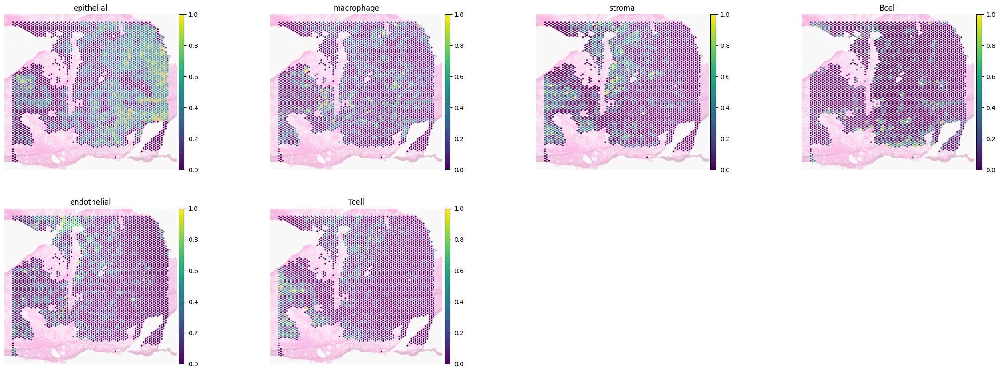

In [138]:
annotation_list = list(pd.unique(sc_ad_emb.obs['cell_type']))
tg.plot_cell_annotation_sc(img_ad, annotation_list, x='x', y='y', perc=0.001, alpha_img=0.3)

### Before finetune

In [ ]:
case_name = '_training20'

In [ ]:
sc_data = sc.read_h5ad(sc_data_path)
sc_data

In [ ]:
sc_data = sc_data[sc_data.obs['cell_type']!='endothelial']
sc_data

In [ ]:
sc_text_feature_path = os.path.join(data_path, sample_name+'_txt_features_sc'+case_name+'.csv')
sc_text_features = pd.read_csv(sc_text_feature_path, index_col=0)[sc_data.obs.index]

#### TXT

In [ ]:
sc_ad_emb = anndata.AnnData(sc_text_features.T)
sc_ad_emb.obs = sc_data.obs.copy()
sc_ad_emb

In [ ]:
# ad_expr = sc.read_h5ad(data_path+sample_name+'_filter200g.h5ad')
ad_expr = sc.read_h5ad(data_path+sample_name+'_filter100g.h5ad')
ad_expr

In [ ]:
text_feature_path = os.path.join(data_path, sample_name+'_txt_features'+case_name+'.csv')
text_features = pd.read_csv(text_feature_path, index_col=0)[ad_expr.obs.index]

In [ ]:
txt_ad = anndata.AnnData(text_features[ad_expr.obs.index].T)
txt_ad.obs['cell_num']=ad_expr.obs['cell_num'].copy()
txt_ad.uns['spatial']=ad_expr.uns['spatial'].copy()
txt_ad.obsm['spatial']=ad_expr.obsm['spatial'].copy()
txt_ad

In [ ]:
tg.pp_adatas(sc_ad_emb, txt_ad, genes=None)

##### Clusters Mode

In [ ]:
ad_map = tg.map_cells_to_space(sc_ad_emb, txt_ad, 
    mode="clusters",
    cluster_label='cell_type',
    device='cpu', 
    # device='cuda', 
    scale=False,
    target_count=txt_ad.obs['cell_num'].sum(),
    density_prior=torch.from_numpy(density_prior),
)

In [ ]:
tg.project_cell_annotations(ad_map, txt_ad, annotation='cell_type')

In [ ]:
for cell_type in txt_ad.obsm['tangram_ct_pred'].columns:
    txt_ad.obsm['tangram_ct_pred'][cell_type]=txt_ad.obsm['tangram_ct_pred'][cell_type]*sc_ad_emb.obs['cell_type'].value_counts()[cell_type]

In [ ]:
txt_ad.obsm['tangram_ct_pred'] = txt_ad.obsm['tangram_ct_pred'][['epithelial', 'macrophage', 'Bcell', 'Tcell', 'stroma']]
expr_deconv = txt_ad.obsm['tangram_ct_pred'].T/txt_ad.obsm['tangram_ct_pred'].T.sum()
expr_deconv

In [ ]:
data = np.array(expr_deconv.T)
coordinates = np.array([txt_ad.obsm['spatial'][:, 0], -txt_ad.obsm['spatial'][:, 1]]).T/txt_ad.obsm['spatial'].max()

In [ ]:
plt_pie_chart(data, coordinates)

#### Img

In [ ]:
sc_ad_emb = anndata.AnnData(sc_text_features.T)
sc_ad_emb.obs = sc_data.obs.copy()
sc_ad_emb

In [ ]:
image_feature_path = os.path.join(data_path, sample_name+'_img_features'+case_name+'.csv')
image_features = pd.read_csv(image_feature_path, index_col=0)[ad_expr.obs.index]

In [ ]:
img_ad = anndata.AnnData(image_features[ad_expr.obs.index].T)
img_ad.obs['cell_num']=ad_expr.obs['cell_num'].copy()
img_ad.uns['spatial']=ad_expr.uns['spatial'].copy()
img_ad.obsm['spatial']=ad_expr.obsm['spatial'].copy()
img_ad

In [ ]:
tg.pp_adatas(sc_ad_emb, img_ad, genes=None)

##### Clusters Mode

In [ ]:
ad_map = tg.map_cells_to_space(sc_ad_emb, img_ad, 
    mode="clusters",
    cluster_label='cell_type',
    # device='cuda', 
    device='cpu', 
    scale=False,
    target_count=txt_ad.obs['cell_num'].sum(),
    density_prior=torch.from_numpy(density_prior),
)

In [ ]:
tg.project_cell_annotations(ad_map, img_ad, annotation='cell_type')

In [97]:
for cell_type in img_ad.obsm['tangram_ct_pred'].columns:
    img_ad.obsm['tangram_ct_pred'][cell_type]=img_ad.obsm['tangram_ct_pred'][cell_type]*sc_ad_emb.obs['cell_type'].value_counts()[cell_type]

In [ ]:
img_ad.obsm['tangram_ct_pred'] = img_ad.obsm['tangram_ct_pred'][['epithelial', 'macrophage', 'Bcell', 'Tcell', 'stroma', 'endothelial']]
expr_deconv = img_ad.obsm['tangram_ct_pred'].T/img_ad.obsm['tangram_ct_pred'].T.sum()
expr_deconv

In [ ]:
data = np.array(expr_deconv.T)
coordinates = np.array([img_ad.obsm['spatial'][:, 0], -img_ad.obsm['spatial'][:, 1]]).T/img_ad.obsm['spatial'].max()

100%|██████████| 3104/3104 [01:17<00:00, 39.98it/s]


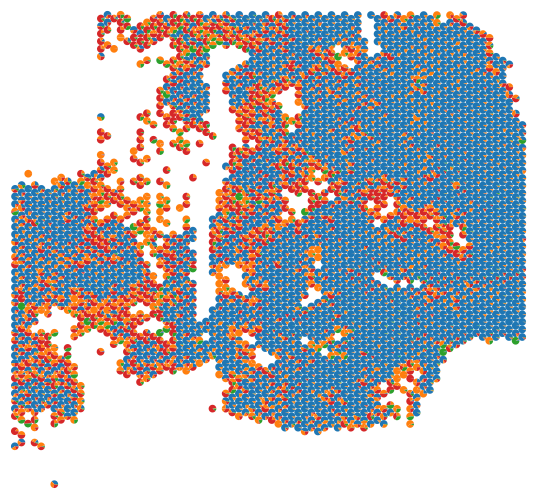

In [101]:
plt_pie_chart(data, coordinates)

### After finetune rb

In [246]:
case_name = '_finetune10_rb'

In [281]:
sc_data = sc.read_h5ad(sc_data_path)
sc_data

AnnData object with n_obs × n_vars = 1112 × 21785
    obs: 'cell_type'

In [282]:
sc_data.obs['cell_type'].value_counts()/sc_data.obs['cell_type'].value_counts().sum()

cell_type
epithelial     0.780576
stroma         0.084532
macrophage     0.057554
Tcell          0.047662
Bcell          0.017086
endothelial    0.012590
Name: count, dtype: float64

In [248]:
sc_text_feature_path = os.path.join(data_path, sample_name+'_txt_features_sc'+case_name+'.csv')
sc_text_features = pd.read_csv(sc_text_feature_path, index_col=0)

#### txt

In [249]:
sc_ad_emb = anndata.AnnData(sc_text_features.T)
sc_ad_emb.obs = sc_data.obs.copy()
sc_ad_emb

AnnData object with n_obs × n_vars = 1112 × 768
    obs: 'cell_type'

In [250]:
# ad_expr = sc.read_h5ad(data_path+sample_name+'_filter200g.h5ad')
ad_expr = sc.read_h5ad(data_path+sample_name+'_filter100g.h5ad')
ad_expr

AnnData object with n_obs × n_vars = 3104 × 16300
    obs: 'in_tissue', 'array_row', 'array_col', 'pixel_y', 'pixel_x', 'cell_num', 'n_genes', 'leiden'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells'
    uns: 'leiden', 'leiden_colors', 'log1p', 'neighbors', 'pca', 'spatial'
    obsm: 'X_pca', 'spatial'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'connectivities', 'distances'

In [251]:
text_feature_path = os.path.join(data_path, sample_name+'_txt_features'+case_name+'.csv')
text_features = pd.read_csv(text_feature_path, index_col=0)[ad_expr.obs.index]

In [252]:
txt_ad = anndata.AnnData(text_features[ad_expr.obs.index].T)
txt_ad.obs['cell_num']=ad_expr.obs['cell_num'].copy()
txt_ad.uns['spatial']=ad_expr.uns['spatial'].copy()
txt_ad.obsm['spatial']=ad_expr.obsm['spatial'].copy()
txt_ad

AnnData object with n_obs × n_vars = 3104 × 768
    obs: 'cell_num'
    uns: 'spatial'
    obsm: 'spatial'

In [253]:
tg.pp_adatas(sc_ad_emb, txt_ad, genes=None)

INFO:root:764 training genes are saved in `uns``training_genes` of both single cell and spatial Anndatas.
INFO:root:764 overlapped genes are saved in `uns``overlap_genes` of both single cell and spatial Anndatas.
INFO:root:uniform based density prior is calculated and saved in `obs``uniform_density` of the spatial Anndata.
INFO:root:rna count based density prior is calculated and saved in `obs``rna_count_based_density` of the spatial Anndata.


In [254]:
ad_map = tg.map_cells_to_space(sc_ad_emb, txt_ad, 
    mode="clusters",
    # mode="constrained",
    cluster_label='cell_type',
    device='cuda', 
    scale=False,
    # density_prior='uniform'
    target_count=txt_ad.obs['cell_num'].sum(),
    density_prior=torch.from_numpy(density_prior),
)

INFO:root:Allocate tensors for mapping.
INFO:root:Begin training with 764 genes and tensor([1.9623e-05, 2.3547e-04, 4.7095e-04,  ..., 5.6906e-04, 1.7661e-04,
        9.8114e-05], dtype=torch.float64) density_prior in clusters mode...
INFO:root:Printing scores every 100 epochs.


Score: 0.078, KL reg: 0.491
Score: 0.158, KL reg: 0.002
Score: 0.161, KL reg: 0.001
Score: 0.162, KL reg: 0.001
Score: 0.162, KL reg: 0.001
Score: 0.162, KL reg: 0.001
Score: 0.162, KL reg: 0.001
Score: 0.162, KL reg: 0.001
Score: 0.162, KL reg: 0.001
Score: 0.162, KL reg: 0.001


INFO:root:Saving results..


In [260]:
tg.project_cell_annotations(ad_map, txt_ad, annotation='cell_type')

INFO:root:spatial prediction dataframe is saved in `obsm` `tangram_ct_pred` of the spatial AnnData.


In [269]:
# annotation_list = list(pd.unique(sc_ad_emb.obs['cell_type']))
# tg.plot_cell_annotation_sc(txt_ad, annotation_list, x='x', y='y', perc=0.001, alpha_img=0.3)

In [262]:
for cell_type in txt_ad.obsm['tangram_ct_pred'].columns:
    txt_ad.obsm['tangram_ct_pred'][cell_type]=txt_ad.obsm['tangram_ct_pred'][cell_type]*sc_ad_emb.obs['cell_type'].value_counts()[cell_type]

In [263]:
txt_ad.obsm['tangram_ct_pred'].sum()

epithelial     867.999968
stroma          93.999998
macrophage      64.000001
Tcell           52.999995
Bcell           18.999999
endothelial     13.999999
dtype: float64

In [264]:
txt_ad.obsm['tangram_ct_pred'] = txt_ad.obsm['tangram_ct_pred'][['epithelial', 'macrophage', 'Bcell', 'Tcell', 'stroma', 'endothelial']]

In [265]:
expr_deconv = txt_ad.obsm['tangram_ct_pred'].T/txt_ad.obsm['tangram_ct_pred'].T.sum()

In [266]:
expr_deconv

,TNBC_processed_adata_AACACGTGCATCGCAC-1,TNBC_processed_adata_AACACTTGGCAAGGAA-1,TNBC_processed_adata_AACAGGATTCATAGTT-1,TNBC_processed_adata_AACAGGTTATTGCACC-1,TNBC_processed_adata_AACAGGTTCACCGAAG-1,TNBC_processed_adata_AACAGTCGTGTCGCGG-1,TNBC_processed_adata_AACATATTCTTGCGAA-1,TNBC_processed_adata_AACATCGCGTGACCAC-1,TNBC_processed_adata_AACATCTAATGACCGG-1,TNBC_processed_adata_AACATGACTTGGCTGC-1,...,TNBC_processed_adata_TGTTCACTCACGGTAA-1,TNBC_processed_adata_TGTTCAGAACGGTGTA-1,TNBC_processed_adata_TGTTCCTCACATTAAT-1,TNBC_processed_adata_TGTTCTGCTCTGTCGT-1,TNBC_processed_adata_TGTTGCGTCCAAGATT-1,TNBC_processed_adata_TGTTGGAACCTTCCGC-1,TNBC_processed_adata_TGTTGGAACGAGGTCA-1,TNBC_processed_adata_TGTTGGAAGCTCGGTA-1,TNBC_processed_adata_TGTTGGATGGACTTCT-1,TNBC_processed_adata_TGTTGGCCTACACGTG-1
epithelial,0.038199,0.384414,0.941291,0.534820,0.999085,0.223110,0.754299,0.000664,0.780159,0.294938,...,0.911144,0.022096,0.088401,0.739429,0.930617,0.997745,0.983718,0.793687,0.047056,0.009956
macrophage,0.495150,0.045718,0.053333,0.181570,0.000352,0.097232,0.025602,0.000799,0.000525,0.000223,...,0.000041,0.000355,0.713980,0.224355,0.051943,0.000732,0.010336,0.012840,0.067914,0.680730
Bcell,0.195384,0.186774,0.000031,0.050624,0.000005,0.046683,0.000036,0.183432,0.154060,0.000039,...,0.000010,0.000025,0.000206,0.000056,0.015734,0.000308,0.000007,0.000003,0.000006,0.262077
Tcell,0.144624,0.000134,0.000101,0.000663,0.000011,0.539720,0.115596,0.000079,0.001232,0.214884,...,0.000059,0.000315,0.000275,0.000861,0.000992,0.000030,0.000140,0.000076,0.000292,0.000010
stroma,0.126592,0.382911,0.000118,0.224047,0.000542,0.004479,0.094286,0.704429,0.007267,0.384821,...,0.088726,0.841279,0.122703,0.000169,0.000707,0.001099,0.002859,0.188670,0.884713,0.000100
endothelial,0.000051,0.000049,0.005126,0.008276,0.000006,0.088776,0.010181,0.110597,0.056756,0.105095,...,0.000020,0.135929,0.074436,0.035129,0.000007,0.000087,0.002940,0.004723,0.000019,0.047126


In [267]:
data = np.array(expr_deconv.T)
coordinates = np.array([txt_ad.obsm['spatial'][:, 0], -txt_ad.obsm['spatial'][:, 1]]).T/txt_ad.obsm['spatial'].max()

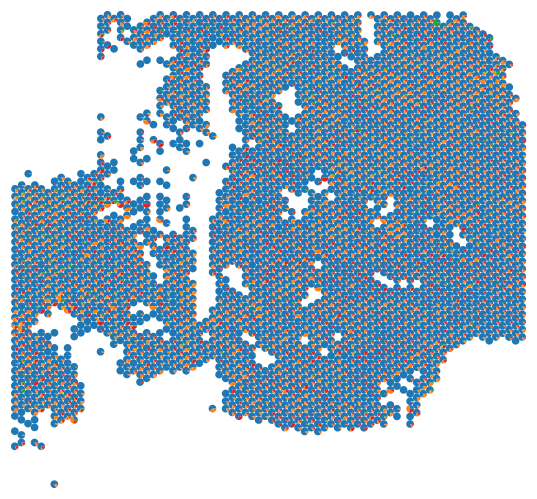

CPU times: user 2min 14s, sys: 1.33 s, total: 2min 15s
Wall time: 2min 16s


In [145]:
fig = plt.figure(figsize=(8, 8))
cmap = plt.colormaps["tab10"]

for i in tqdm(range(data.shape[0])):
    sizes = data[i]
    coord = coordinates[i]
    subax = fig.add_axes([coord[0], coord[1], 0.012, 0.012])
    subax.pie(sizes, 
              colors=cmap([0, 1, 1, 1, 3, 2])
              # colors=['red', 'green', 'blue']
             )  # Including percentage labels
    subax.set_aspect('equal')  # Ensure the pie is drawn as a circle.

plt.show()

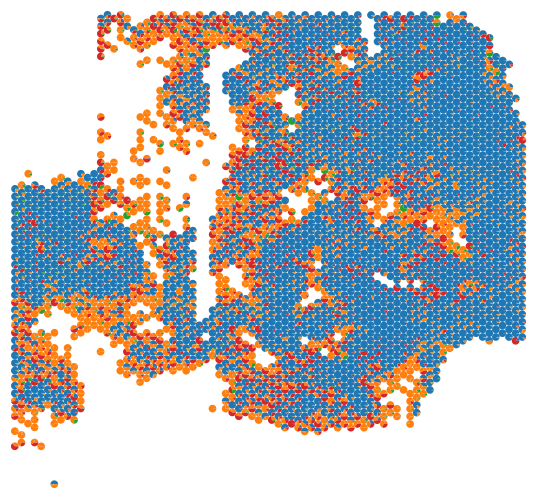

CPU times: user 2min 12s, sys: 1.34 s, total: 2min 13s
Wall time: 2min 13s


In [268]:
fig = plt.figure(figsize=(8, 8))
cmap = plt.colormaps["tab10"]

for i in tqdm(range(data.shape[0])):
    sizes = data[i]
    coord = coordinates[i]
    subax = fig.add_axes([coord[0], coord[1], 0.012, 0.012])
    subax.pie(sizes, 
              colors=cmap([0, 1, 1, 1, 3, 2])
              # colors=['red', 'green', 'blue']
             )  # Including percentage labels
    subax.set_aspect('equal')  # Ensure the pie is drawn as a circle.

plt.show()

#### img

In [146]:
sc_ad_emb = anndata.AnnData(sc_text_features.T)
sc_ad_emb.obs = sc_data.obs.copy()
sc_ad_emb

AnnData object with n_obs × n_vars = 1112 × 768
    obs: 'cell_type'

In [147]:
image_feature_path = os.path.join(data_path, sample_name+'_img_features'+case_name+'.csv')
image_features = pd.read_csv(image_feature_path, index_col=0)[ad_expr.obs.index]

In [148]:
img_ad = anndata.AnnData(image_features[ad_expr.obs.index].T)
img_ad.obs['cell_num']=ad_expr.obs['cell_num'].copy()
img_ad.uns['spatial']=ad_expr.uns['spatial'].copy()
img_ad.obsm['spatial']=ad_expr.obsm['spatial'].copy()
img_ad

AnnData object with n_obs × n_vars = 3104 × 768
    obs: 'cell_num'
    uns: 'spatial'
    obsm: 'spatial'

In [149]:
tg.pp_adatas(sc_ad_emb, img_ad, genes=None)

INFO:root:764 training genes are saved in `uns``training_genes` of both single cell and spatial Anndatas.
INFO:root:764 overlapped genes are saved in `uns``overlap_genes` of both single cell and spatial Anndatas.
INFO:root:uniform based density prior is calculated and saved in `obs``uniform_density` of the spatial Anndata.
INFO:root:rna count based density prior is calculated and saved in `obs``rna_count_based_density` of the spatial Anndata.


In [188]:
ad_map = tg.map_cells_to_space(sc_ad_emb, img_ad, 
    mode="clusters",
    # mode="constrained",
    cluster_label='cell_type',
    device='cuda', 
    scale=False,
    # density_prior='uniform'
    target_count=txt_ad.obs['cell_num'].sum(),
    density_prior=torch.from_numpy(density_prior),
)

INFO:root:Allocate tensors for mapping.
INFO:root:Begin training with 764 genes and tensor([1.9623e-05, 2.3547e-04, 4.7095e-04,  ..., 5.6906e-04, 1.7661e-04,
        9.8114e-05], dtype=torch.float64) density_prior in clusters mode...
INFO:root:Printing scores every 100 epochs.


Score: 0.104, KL reg: 0.463
Score: 0.176, KL reg: 0.001
Score: 0.178, KL reg: 0.001
Score: 0.179, KL reg: 0.001
Score: 0.179, KL reg: 0.001
Score: 0.179, KL reg: 0.001
Score: 0.179, KL reg: 0.001
Score: 0.179, KL reg: 0.001
Score: 0.179, KL reg: 0.001
Score: 0.179, KL reg: 0.001


INFO:root:Saving results..


In [189]:
tg.project_cell_annotations(ad_map, img_ad, annotation='cell_type')

INFO:root:spatial prediction dataframe is saved in `obsm` `tangram_ct_pred` of the spatial AnnData.


In [105]:
# annotation_list = list(pd.unique(sc_ad_emb.obs['cell_type']))
# tg.plot_cell_annotation_sc(img_ad, annotation_list, x='x', y='y', 
#                            # perc=0.001, 
#                            alpha_img=0.3)

In [205]:
for cell_type in img_ad.obsm['tangram_ct_pred'].columns:
    img_ad.obsm['tangram_ct_pred'][cell_type]=img_ad.obsm['tangram_ct_pred'][cell_type]*sc_ad_emb.obs['cell_type'].value_counts()[cell_type]

In [207]:
img_ad.obsm['tangram_ct_pred'] = img_ad.obsm['tangram_ct_pred'][['epithelial', 'macrophage', 'Bcell', 'Tcell', 'stroma', 'endothelial']]

In [ ]:
expr_deconv = img_ad.obsm['tangram_ct_pred'].T/img_ad.obsm['tangram_ct_pred'].T.sum()
expr_deconv

In [210]:
data = np.array(expr_deconv.T)
coordinates = np.array([img_ad.obsm['spatial'][:, 0], -img_ad.obsm['spatial'][:, 1]]).T/img_ad.obsm['spatial'].max()

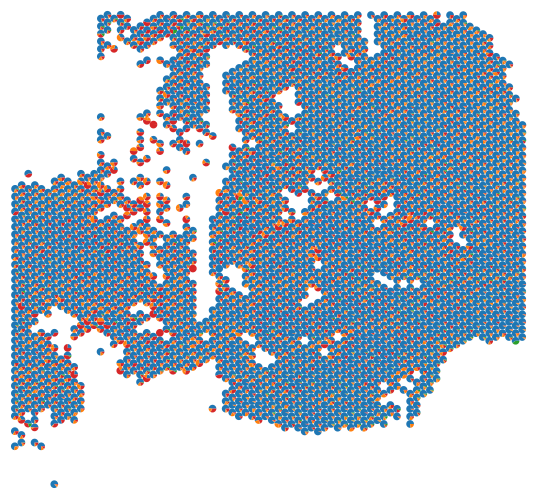

CPU times: user 2min 14s, sys: 1.34 s, total: 2min 15s
Wall time: 2min 15s


In [159]:
fig = plt.figure(figsize=(8, 8))
cmap = plt.colormaps["tab10"]
for i in tqdm(range(data.shape[0])):
    sizes = data[i]
    coord = coordinates[i]
    subax = fig.add_axes([coord[0], coord[1], 0.012, 0.012])
    subax.pie(sizes, 
              colors=cmap([0, 1, 1, 1, 3, 2])
              # colors=['red', 'green', 'blue']
             )  # Including percentage labels
    subax.set_aspect('equal')  # Ensure the pie is drawn as a circle.

plt.show()

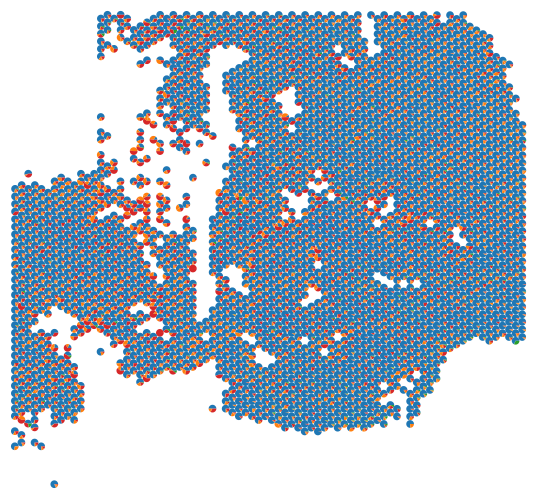

CPU times: user 2min 14s, sys: 1.37 s, total: 2min 15s
Wall time: 2min 15s


In [187]:
fig = plt.figure(figsize=(8, 8))
cmap = plt.colormaps["tab10"]
for i in tqdm(range(data.shape[0])):
    sizes = data[i]
    coord = coordinates[i]
    subax = fig.add_axes([coord[0], coord[1], 0.012, 0.012])
    subax.pie(sizes, 
              colors=cmap([0, 1, 1, 1, 3, 2])
              # colors=['red', 'green', 'blue']
             )  # Including percentage labels
    subax.set_aspect('equal')  # Ensure the pie is drawn as a circle.

plt.show()

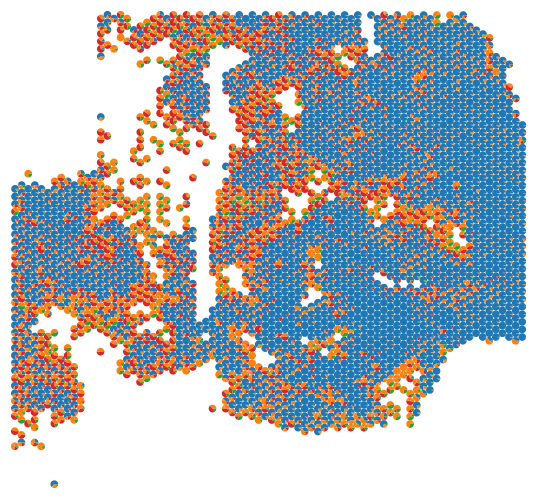

CPU times: user 2min 11s, sys: 1.41 s, total: 2min 12s
Wall time: 2min 13s


In [211]:
fig = plt.figure(figsize=(8, 8))
cmap = plt.colormaps["tab10"]

for i in tqdm(range(data.shape[0])):
    sizes = data[i]
    coord = coordinates[i]
    subax = fig.add_axes([coord[0], coord[1], 0.012, 0.012])
    subax.pie(sizes, 
              colors=cmap([0, 1, 1, 1, 3, 2])
              # colors=['red', 'green', 'blue']
             )  # Including percentage labels
    subax.set_aspect('equal')  # Ensure the pie is drawn as a circle.

plt.show()